# Relevance fn for new labels

In [1]:
from sklearn.preprocessing import StandardScaler
import seaborn as sns
import matplotlib.pyplot as plt

import pandas as pd

from tensorflow.keras.models import Sequential
from tensorflow.keras.layers import SimpleRNN, LSTM, Dense, Dropout, GRU, Conv1D, Flatten, Reshape

import os
import numpy as np
import sys
import tensorflow as tf
import random
import keras
from scipy.interpolate import PchipInterpolator
from statsmodels.stats.stattools import medcouple

SEED = 42

def set_seeds(seed=SEED):
    os.environ['PYTHONHASHSEED'] = str(seed)
    random.seed(seed)
    tf.random.set_seed(seed)
    np.random.seed(seed)
    keras.utils.set_random_seed(seed)

def set_global_determinism(seed=SEED):
    set_seeds(seed=seed)

    os.environ['TF_DETERMINISTIC_OPS'] = '1'
    os.environ['TF_CUDNN_DETERMINISTIC'] = '1'
    
    tf.config.threading.set_inter_op_parallelism_threads(1)
    tf.config.threading.set_intra_op_parallelism_threads(1)

# Call the above function with seed value
set_global_determinism(seed=SEED)

In [2]:
os.chdir("../")
folder_path = os.path.abspath("functions/") #INPUT_PATH)#'path_to_your_folder')  # Replace with the actual folder path
sys.path.insert(0, folder_path)

from Predictions import (
    SERA,
    PredictionModel,
    compute_adjusted_boxplot_bounds,
    piecewise_linear_phi_2,
    create_relevance_function
)
from indices import get_heatwaves_indices, transform_time_label
import pickle

c:\Users\marti\AppData\Local\Programs\Python\Python310\lib\site-packages\tensorflow_addons\utils\tfa_eol_msg.py:23: UserWarning: 

TensorFlow Addons (TFA) has ended development and introduction of new features.
TFA has entered a minimal maintenance and release mode until a planned end of life in May 2024.
Please modify downstream libraries to take dependencies from other repositories in our TensorFlow community (e.g. Keras, Keras-CV, and Keras-NLP). 

For more information see: https://github.com/tensorflow/addons/issues/2807 

  warnings.warn(


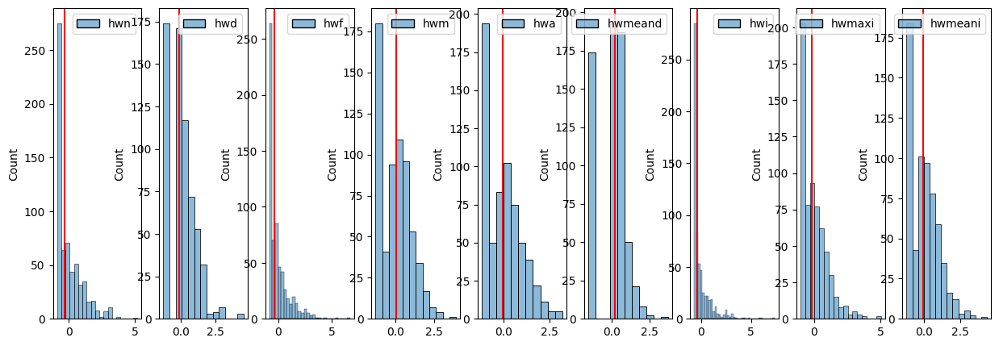

In [34]:
region = "chile"
indices = ["hwn", "hwd", "hwf", "hwm", "hwa", "hwmeand", "hwi", "hwmaxi", "hwmeani"]

hws = pd.read_csv("data/local_data/monthly/hws_chile_new_agg.csv")

hws["time"] = pd.to_datetime(hws["Unnamed: 0"],format='%Y-%m')
hws.set_index('time', inplace=True)
hws.drop(columns="Unnamed: 0", inplace=True)
scaler = StandardScaler()
hws_scaled = hws.copy(deep=True)
hws_scaled[indices] = scaler.fit_transform(hws[indices])
fig, axs = plt.subplots(1, len(indices), figsize=(15,5))
for i, index in enumerate(indices):
    sns.histplot(hws_scaled[[index]], ax=axs[i])
    axs[i].axvline(np.median(hws_scaled[[index]]), color='red')

In [26]:
pd.options.display.float_format = "{:,.2f}".format
hws_scaled.describe()

,hwn,hwf,hwd,hwm,hwa,hwmeand,hwi,hwmaxi,hwmeani
count,636.00,636.00,636.00,636.00,636.00,636.00,636.00,636.00,636.00
mean,0.00,-0.00,-0.00,0.00,-0.00,0.00,0.00,-0.00,0.00
std,1.00,1.00,1.00,1.00,1.00,1.00,1.00,1.00,1.00
min,-0.90,-0.81,-1.27,-1.26,-1.17,-1.52,-0.68,-1.01,-1.18
25%,-0.90,-0.81,-1.27,-1.26,-1.17,-1.52,-0.68,-1.01,-1.18
50%,-0.34,-0.35,-0.11,0.04,-0.03,0.22,-0.40,-0.17,-0.03
75%,0.49,0.37,0.67,0.66,0.67,0.61,0.21,0.56,0.62
max,5.20,6.68,4.55,3.91,3.18,3.70,7.35,5.01,4.35


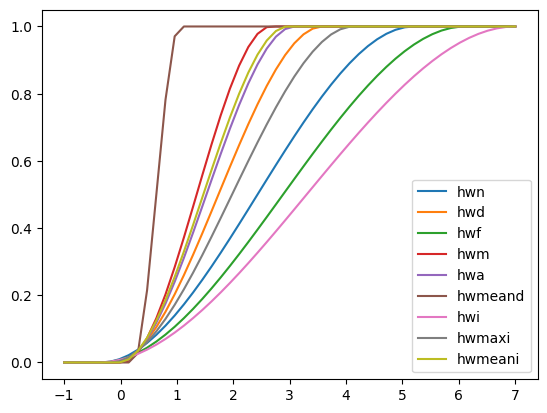

In [27]:
x = np.linspace(-1, 7)
relevance_index = {}
for index in indices:
    hws_index = hws_scaled[[index]].to_numpy()
    hws_index = hws_index.reshape(hws_index.shape[0])
    relevance = create_relevance_function(hws_index)
    relevance_index[index] = relevance
    plt.plot(x, relevance(x), label=index)
plt.legend()
plt.show()


## Season relevance function

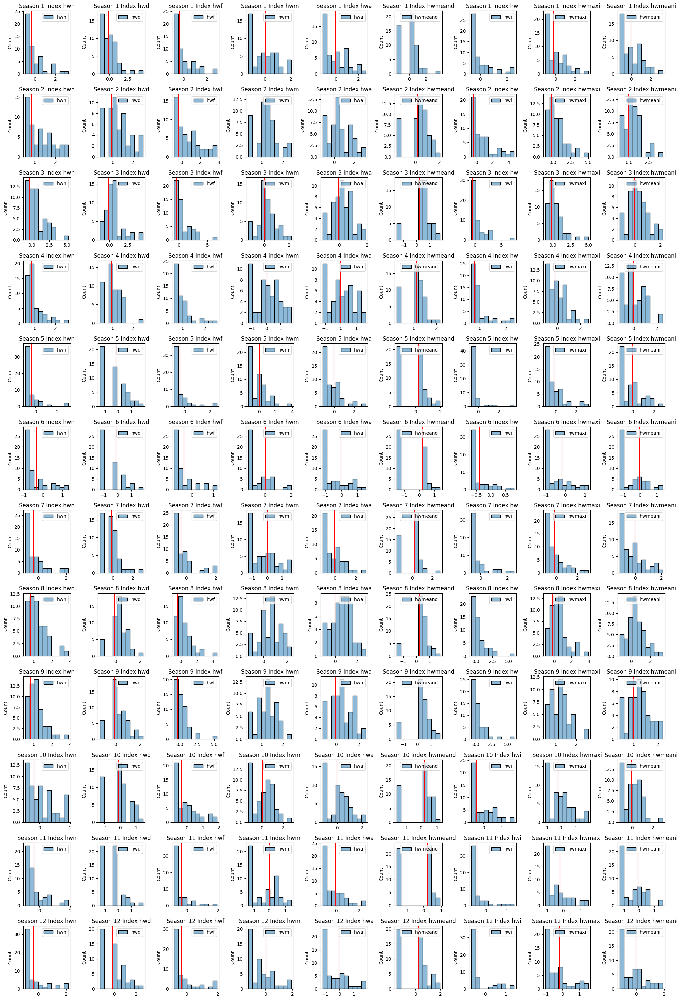

In [28]:
x = np.linspace(-1, 7)
relevance_index = {}
fig, axs = plt.subplots(12, len(indices), figsize=(20,30))
axs = axs.flatten()
for i in range(12):
    hws_month = hws_scaled[hws_scaled.index.month==i+1]
    for k, index in enumerate(indices):
        sns.histplot(hws_month[[index]], ax=axs[i*9+k], bins=10)
        axs[i*9+k].axvline(np.median(hws_scaled[[index]]), color='red')
        axs[i*9+k].set_title(f"Season {i+1} Index {index}")
plt.tight_layout()
plt.show()


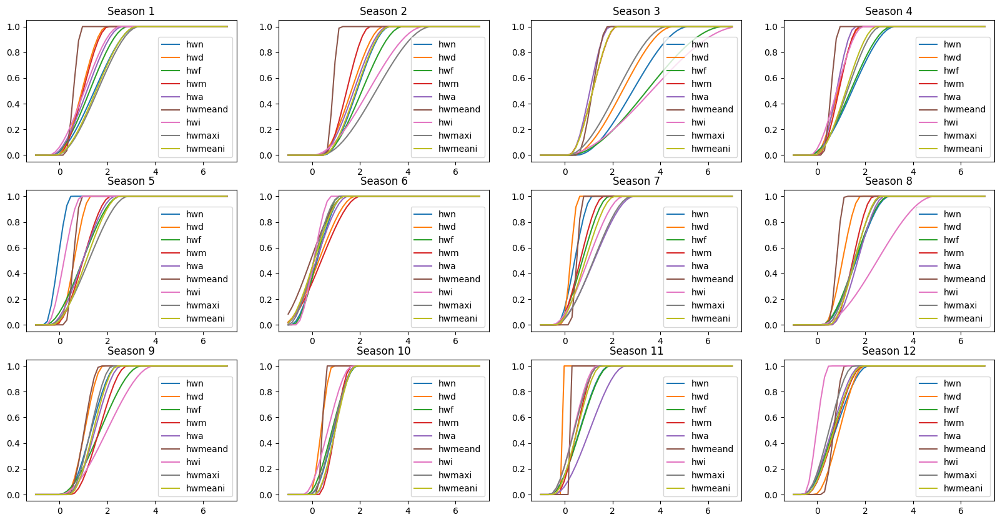

In [29]:
x = np.linspace(-1, 7)
relevance_index = {}
fig, axs = plt.subplots(3, 4, figsize=(20,10))
axs = axs.flatten()
for i in range(12):
    hws_month = hws_scaled[hws_scaled.index.month==i+1]
    for index in indices:
        hws_index = hws_month[[index]].to_numpy()
        hws_index = hws_index.reshape(hws_index.shape[0])
        relevance = create_relevance_function(hws_index)
        relevance_index[index] = relevance
        axs[i].plot(x, relevance(x), label=index)
    axs[i].legend()
    axs[i].set_title(f"Season {i+1}")
plt.show()


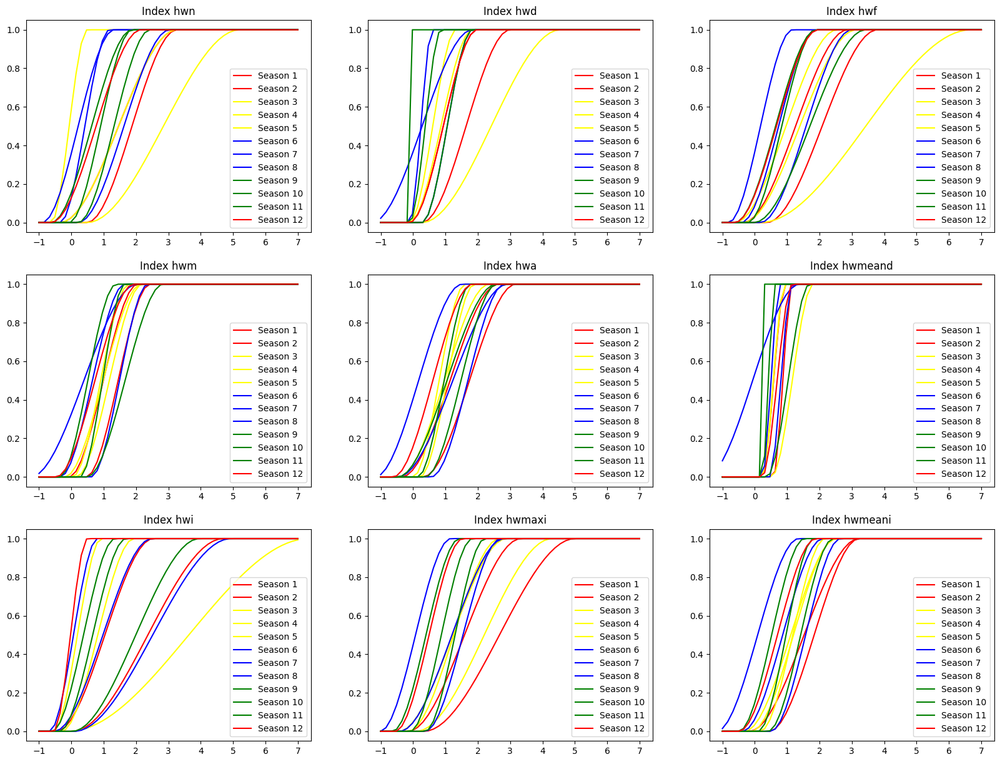

In [30]:
x = np.linspace(-1, 7)
relevance_index = {}
fig, axs = plt.subplots(3, 3, figsize=(20,15))
axs = axs.flatten()
colors = {
    1: "red",
    2: "red",
    3: "yellow",
    4: "yellow",
    5: "yellow",
    6: "blue",
    7: "blue",
    8: "blue",
    9: "green",
    10: "green",
    11: "green",
    12: "red"
}
for k, index in enumerate(indices):
    for i in range(12):
        hws_month = hws_scaled[hws_scaled.index.month==i+1]
        hws_index = hws_month[[index]].to_numpy()
        hws_index = hws_index.reshape(hws_index.shape[0])
        relevance = create_relevance_function(hws_index)
        relevance_index[index] = relevance
        axs[k].plot(x, relevance(x), label=f"Season {i+1}", c=colors[i+1])
    axs[k].legend()
    axs[k].set_title(f"Index {index}")
plt.show()


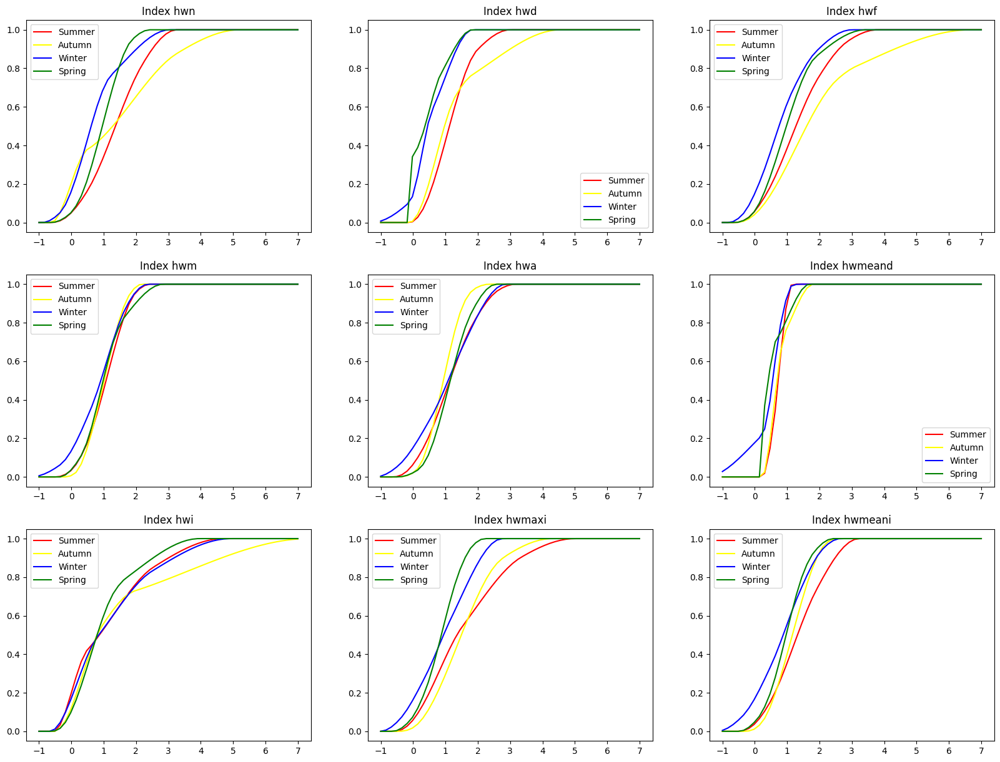

In [31]:
x = np.linspace(-1, 7)
fig, axs = plt.subplots(3, 3, figsize=(20,15))
axs = axs.flatten()
for k, index in enumerate(indices):
    relevance_index = {}
    for i in range(12):
        hws_month = hws_scaled[hws_scaled.index.month==i+1]
        hws_index = hws_month[[index]].to_numpy()
        hws_index = hws_index.reshape(hws_index.shape[0])
        relevance = create_relevance_function(hws_index)
        relevance_index[i+1] = relevance
    axs[k].plot(x, (relevance_index[1](x) + relevance_index[2](x) + relevance_index[12](x))/3, label=f"Summer", c="red")
    axs[k].plot(x, (relevance_index[3](x) + relevance_index[4](x) + relevance_index[5](x))/3, label=f"Autumn", c="yellow")
    axs[k].plot(x, (relevance_index[6](x) + relevance_index[7](x) + relevance_index[8](x))/3, label=f"Winter", c="blue")
    axs[k].plot(x, (relevance_index[9](x) + relevance_index[10](x) + relevance_index[11](x))/3, label=f"Spring", c="green")
    axs[k].legend()
    axs[k].set_title(f"Index {index}")
plt.show()


## Linear relevance function optimization

### Load drivers

In [11]:
path_drivers_ssp = "data/03_primary/drivers/dfs_dict_ssps.pickle"
with open(path_drivers_ssp, 'rb') as handle:
    cmip6_drivers_dfs = pickle.load(handle)

scenarios = list(cmip6_drivers_dfs["EC-Earth3"].keys())
cmip6_models = list(cmip6_drivers_dfs.keys())
print("Scenarios", scenarios)
print("Models", cmip6_models)

Scenarios ['historical', 'ssp126', 'ssp245', 'ssp370', 'ssp585']
Models ['MPI-ESM1-2-HR', 'MRI-ESM2-0', 'GFDL-ESM4', 'EC-Earth3', 'MIROC6', 'AWI-CM-1-1-MR', 'INM-CM4-8', 'ensemble_mean']


In [12]:
path_drivers_historical = "data/03_primary/drivers/dfs_dict.pickle"
with open(path_drivers_historical, 'rb') as handle:
    historical_dfs = pickle.load(handle)

## Default use: 5 labels, 1971-2018 training, default bounds

In [13]:
len_pred = 5

['hwn', 'hwf', 'hwd', 'hwm', 'hwa']
Default bounds [-1.16928928 -0.30647585  3.          6.49996949]
Index hwn paper bounds: (-1.447460376173962, -0.34449239190661074, 6.141647132786026, 5.202271184108693)
Index hwf paper bounds: (-1.1794737774848172, -0.34860340377218507, 6.113162893903127, 6.682564003905567)
Index hwd paper bounds: (-4.18818950996255, -0.1093314747387045, 3.581063890463821, 4.552220565517117)
Index hwm paper bounds: (-5.046231952784555, 0.03713432255517214, 2.660019929098329, 3.9056889564199695)
Index hwa paper bounds: (-4.2321118218383535, -0.0338456512292951, 3.079599837058667, 3.175179624999176)


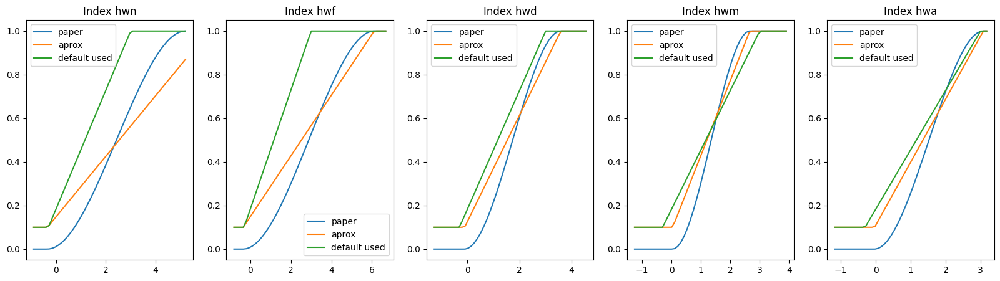

In [14]:
indices_of_interest = ["hwn", "hwf", "hwd", "hwm", "hwa"]
print(indices_of_interest)
bounds = np.array((-1.1692892810242344, -0.30647585455315646, 3.0, 6.499969486244418))
print("Default bounds", bounds)

fig, axs = plt.subplots(1, len(indices_of_interest), figsize=(20,5))
for i, index in enumerate(indices_of_interest):
    hws_index = hws_scaled[[index]].to_numpy()
    hws_index = hws_index.reshape(hws_index.shape[0])
    relevance = create_relevance_function(hws_index)
    l, m ,u  = compute_adjusted_boxplot_bounds(hws_index)
    bounds_paper = (l, m, u, max(hws_index))

    print(f"Index {index} paper bounds:", bounds_paper)
    f2 = piecewise_linear_phi_2(bounds_paper)
    f0 = piecewise_linear_phi_2(bounds)
    x = np.linspace(np.min(hws_index), np.max(hws_index))
    axs[i].plot(x, relevance(x), label="paper")
    axs[i].plot(x, f2(x), label="aprox")
    axs[i].plot(x, f0(x), label="default used")
    axs[i].set_title(f"Index {index}")
    axs[i].legend()
plt.show()

In [ ]:
hws_labels = hws[indices_of_interest]
era5_df = pd.concat((historical_dfs["ERA5"],hws_labels),axis=1)

In [ ]:
bounds = (-1.1692892810242344, -0.30647585455315646, 3.0, 6.499969486244418)

loss_fn = SERA(bounds=bounds,T=100, initial_weight=0.1, fn="piecewise2")
df_pred_train = pd.DataFrame(columns=indices_of_interest, index=era5_df.index)
df_pred_test = pd.DataFrame(columns=indices_of_interest, index=era5_df.index)
models_scenario_predicted = {model: {} for model in cmip6_drivers_dfs.keys()}


for season in range (1,13):

    df_season = era5_df[era5_df.index.month==season]
    model = Sequential([
        Conv1D(16, kernel_size=1, activation="relu", input_shape=(1, len(era5_df.columns) - len(indices_of_interest))),
        Reshape((1, 16)),  # Back to time dimension
        SimpleRNN(8, activation="tanh"),
        Dropout(0.1),
        Dense(len(indices_of_interest))
    ])

    pred = PredictionModel(df_season, season, indices_of_interest, model, name_regressor="CNNRNN16",loss_fn=loss_fn)
    pred.compile_keras_model()

    y_train, y_pred_train = pred.train(len_pred)
    y_test, y_pred = pred.predict(len_pred)
    # dates = pd.date_range(pd.to_datetime(f"1972-{season}"),periods=len(y_train) + len(y_test),freq=pd.offsets.YearBegin(1))
    # pred.plot_predictions(dates, len_pred, y_train, y_pred_train, y_test, y_pred)
    df_pred_train.loc[df_season.index[:-len_pred]] = pred.label_scaler.inverse_transform(y_pred_train)
    df_pred_train.sort_index(inplace=True)
    df_pred_test.loc[df_season.index[-len_pred:]] = pred.label_scaler.inverse_transform(y_pred)
    df_pred_test.sort_index(inplace=True)
    for name, scenarios_df in cmip6_drivers_dfs.items():
        scenario = "historical"
        if season==1:
            models_scenario_predicted[name][scenario] = pd.DataFrame()
        df_target = scenarios_df[scenario][scenarios_df[scenario].index.month==season]
        df_target = df_target[(df_target.index.year >=1970) & (df_target.index.year <= 2014)]
        
        # Normalize cmip6 features for machine input
        target = pred.scaler_X.transform(df_target[pred.scaler_X.feature_names_in_])
        # Reshape for keras and predict
        predicted_normalized = pred.regressor.predict(pred.reshape_for_keras(target))
        # Transform back to original range
        predicted_real = pred.label_scaler.inverse_transform(predicted_normalized)
        predicted = pd.DataFrame(predicted_real).rename(columns={i: label for i,label in enumerate(indices_of_interest)})
        predicted["Date"] = df_target.index
        predicted.set_index("Date",inplace=True)
        models_scenario_predicted[name][scenario] = pd.concat((models_scenario_predicted[name][scenario],predicted),axis=0)
        
df_pred_train = df_pred_train.dropna()
df_pred_train = df_pred_train.astype(np.number)

df_pred_test = df_pred_test.dropna()
df_pred_test = df_pred_test.astype(np.number)


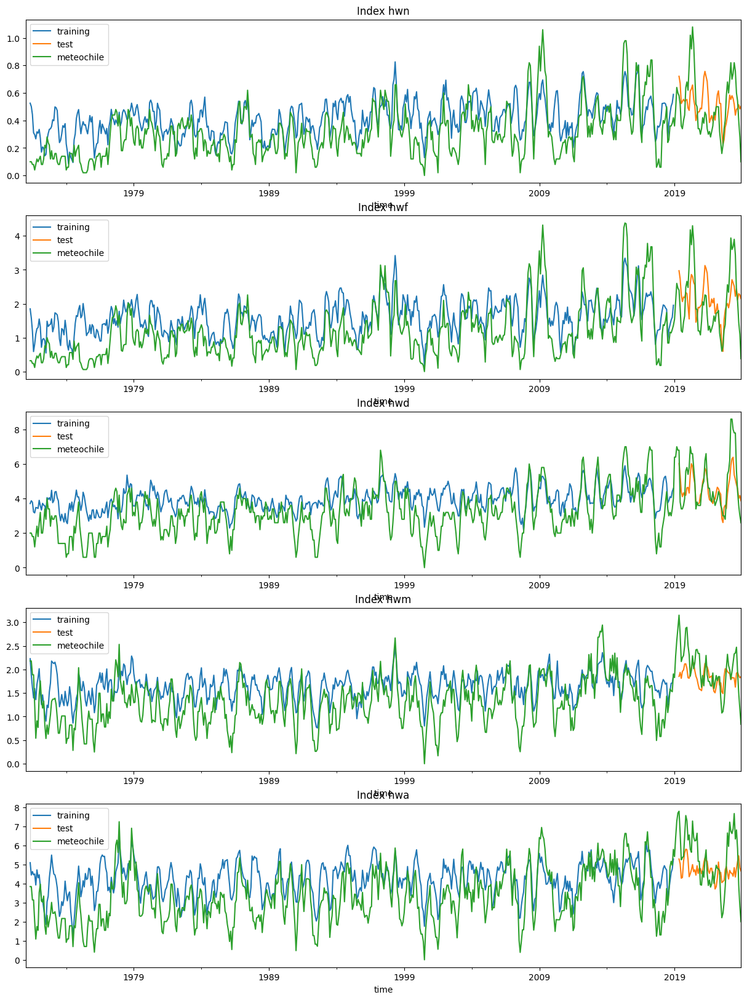

In [17]:
fig, axs = plt.subplots(len(indices_of_interest), figsize=(15, 20))
for i, index in enumerate(indices_of_interest):
    df_pred_train.rolling(5).mean().plot(y=index, ax=axs[i], label="training")
    df_pred_test.rolling(5).mean().plot(y=index, ax=axs[i], label="test")
    hws.rolling(5).mean().plot(y=index, ax=axs[i], label="meteochile")
    axs[i].set_title(f"Index {index}")

In [18]:
mean_scenario = {}
mean_std_scenario = {}
scenario = "historical"

temp_df = pd.DataFrame()
for name, model_scenario in models_scenario_predicted.items():
    temp_df = pd.concat((temp_df, model_scenario[scenario]), axis=1)
    
mean_scenario[scenario] = pd.DataFrame(columns=models_scenario_predicted["EC-Earth3"][scenario].columns,index=model_scenario[scenario].index)
mean_std_scenario[scenario] = pd.DataFrame(columns=models_scenario_predicted["EC-Earth3"][scenario].columns,index=model_scenario[scenario].index)

for col in np.unique(temp_df.columns):
    mean_scenario[scenario][col] = temp_df[col].mean(axis=1)
    mean_std_scenario[scenario][col] = temp_df[col].std(axis=1)
models_scenario_predicted["mean_monthly"] = mean_scenario

models_scenario_predicted["mean_monthly"][scenario] = models_scenario_predicted["mean_monthly"][scenario].astype(np.float64)

models_predicted_yearly = {model: {} for model in models_scenario_predicted.keys()}
models_predicted_decadal = {model: {} for model in models_scenario_predicted.keys()}

for name, model_scenario in models_scenario_predicted.items():
    df = model_scenario[scenario]
    models_predicted_yearly[name][scenario] = transform_time_label(df, "year")
    models_predicted_decadal[name][scenario] = transform_time_label(df, "decade")

pred_train_yearly = transform_time_label(df_pred_train, "year")

mean_yearly_scenario = {}
min_yearly_scenario = {}
max_yearly_scenario = {}
mean_yearly_std_scenario = {}

features = models_predicted_yearly["EC-Earth3"][scenario].columns


temp_df = pd.DataFrame()
for name, model_scenario in models_predicted_yearly.items():
    if "mean" not in name:
        temp_df = pd.concat((temp_df, model_scenario[scenario]), axis=1)

yearly_dates = model_scenario[scenario].index
mean_yearly_scenario[scenario] = pd.DataFrame(columns=features,index=yearly_dates)
min_yearly_scenario[scenario] = pd.DataFrame(columns=features,index=yearly_dates)
max_yearly_scenario[scenario] = pd.DataFrame(columns=features,index=yearly_dates)
mean_yearly_std_scenario[scenario] = pd.DataFrame(columns=features,index=yearly_dates)
for col in np.unique(temp_df.columns):
    mean_yearly_scenario[scenario][col] = temp_df[col].mean(axis=1)
    min_yearly_scenario[scenario][col] = temp_df[col].min(axis=1)
    max_yearly_scenario[scenario][col] = temp_df[col].max(axis=1)
    mean_yearly_std_scenario[scenario][col] = temp_df[col].std(axis=1)

models_predicted_yearly["yearly_then_mean"] = mean_yearly_scenario
models_predicted_yearly["yearly_then_min"] = min_yearly_scenario
models_predicted_yearly["yearly_then_max"] = max_yearly_scenario

In [ ]:
meteochile_yearly = transform_time_label(hws, "year")[indices_of_interest]

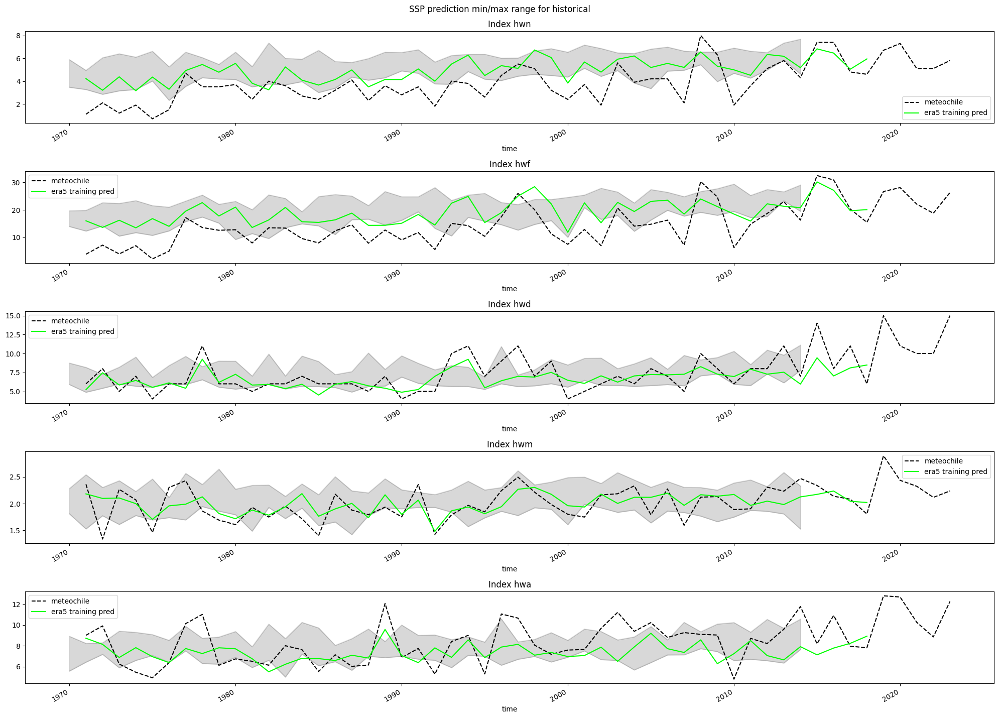

In [20]:
scenarios_prediction_min = models_predicted_yearly["yearly_then_min"]
scenarios_prediction_max = models_predicted_yearly["yearly_then_max"]
colors = {
    "historical": "gray",
    "ssp126": "blue",
    "ssp585": "red"
}
fig, axs = plt.subplots(len(indices_of_interest), figsize=(20, 15))
for i, index in enumerate(indices_of_interest):
    for scenario in ("historical",):
        color=colors[scenario]
        df_min = scenarios_prediction_min[scenario]
        df_max = scenarios_prediction_max[scenario]
        axs[i].plot(
            df_min.index, df_min[index].values, color="black",alpha=0.1, label=f"{scenario}"
        )
        axs[i].plot(
            df_min.index, df_max[index].values, color="black",alpha=0.1, label=f"{scenario}"
        )
        axs[i].fill_between(
            df_min.index, df_min[index].values, df_max[index].values, alpha=0.3, color=color, label=f"{scenario}"
        )
    meteochile_yearly.plot(y=index, linestyle="--", label="meteochile", ax=axs[i], c="black")
    pred_train_yearly.plot(y=index, label="era5 training pred", ax=axs[i], c="lime")
    axs[i].set_title(f"Index {index}")
fig.tight_layout(rect=[0, 0.03, 1, 0.97]) 
fig.suptitle(f"SSP prediction min/max range for historical")
plt.show()

## 5 labels, 1971-2018 training, average paper bounds

In [35]:
def average_bounds(list_bounds):
    result_bounds = []
    result_bounds.append(np.min([b[0] for b in list_bounds]))
    result_bounds.append(np.mean([b[1] for b in list_bounds]))
    result_bounds.append(np.mean([b[2] for b in list_bounds]))
    result_bounds.append(np.max([b[3] for b in list_bounds]))
    print("Result bounds", result_bounds)
    return result_bounds

In [36]:
len_pred = 5

['hwn', 'hwf', 'hwd', 'hwm', 'hwa']
Default bounds [-1.16928928 -0.30647585  3.          6.49996949]
Index hwn paper bounds: (-1.447460376173962, -0.34449239190661074, 6.141647132786026, 5.202271184108693)
Index hwf paper bounds: (-1.1794737774848172, -0.34860340377218507, 6.113162893903127, 6.682564003905567)
Index hwd paper bounds: (-4.18818950996255, -0.1093314747387045, 3.581063890463821, 4.552220565517117)
Index hwm paper bounds: (-5.046231952784555, 0.03713432255517214, 2.660019929098329, 3.9056889564199695)
Index hwa paper bounds: (-4.2321118218383535, -0.0338456512292951, 3.079599837058667, 3.175179624999176)
Result bounds [-5.046231952784555, -0.15982771981832464, 4.3150987366619935, 6.682564003905567]


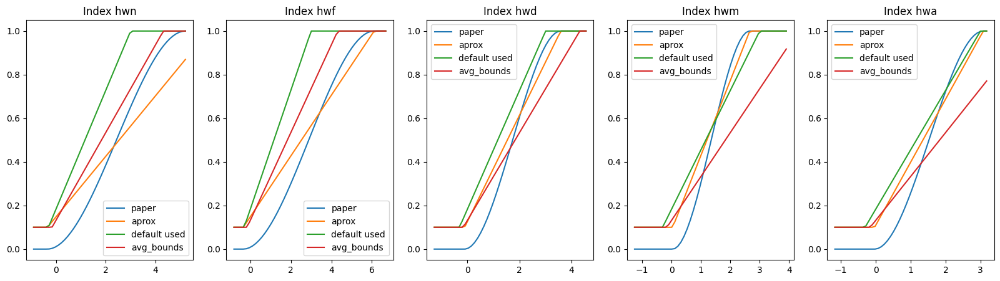

In [51]:
indices_of_interest = ["hwn", "hwf", "hwd", "hwm", "hwa"]
print(indices_of_interest)
bounds = np.array((-1.1692892810242344, -0.30647585455315646, 3.0, 6.499969486244418))
print("Default bounds", bounds)

bounds_paper_list = []

fig, axs = plt.subplots(1, len(indices_of_interest), figsize=(20,5))
for i, index in enumerate(indices_of_interest):
    hws_index = hws_scaled[[index]].to_numpy()
    hws_index = hws_index.reshape(hws_index.shape[0])
    relevance = create_relevance_function(hws_index)
    l, m ,u  = compute_adjusted_boxplot_bounds(hws_index)
    bounds_paper = (l, m, u, max(hws_index))
    bounds_paper_list.append(bounds_paper)

    print(f"Index {index} paper bounds:", bounds_paper)
    f2 = piecewise_linear_phi_2(bounds_paper)
    f0 = piecewise_linear_phi_2(bounds)
    x = np.linspace(np.min(hws_index), np.max(hws_index))
    axs[i].plot(x, relevance(x), label="paper")
    axs[i].plot(x, f2(x), label="aprox")
    axs[i].plot(x, f0(x), label="default used")
    axs[i].set_title(f"Index {index}")

bounds_avg = average_bounds(bounds_paper_list)

for i, index in enumerate(indices_of_interest):
    hws_index = hws_scaled[[index]].to_numpy()
    hws_index = hws_index.reshape(hws_index.shape[0])
    x = np.linspace(np.min(hws_index), np.max(hws_index))
    axs[i].plot(x, piecewise_linear_phi_2(bounds_avg)(x), label="avg_bounds")
    axs[i].legend()
plt.show()

In [39]:
hws_labels = hws[indices_of_interest]
era5_df = pd.concat((historical_dfs["ERA5"],hws_labels),axis=1)

In [ ]:
loss_fn = SERA(bounds=bounds_avg,T=100, initial_weight=0.1, fn="piecewise2")
df_pred_train = pd.DataFrame(columns=indices_of_interest, index=era5_df.index)
df_pred_test = pd.DataFrame(columns=indices_of_interest, index=era5_df.index)
models_scenario_predicted = {model: {} for model in cmip6_drivers_dfs.keys()}


for season in range (1,13):

    df_season = era5_df[era5_df.index.month==season]
    model = Sequential([
        Conv1D(16, kernel_size=1, activation="relu", input_shape=(1, len(era5_df.columns) - len(indices_of_interest))),
        Reshape((1, 16)),  # Back to time dimension
        SimpleRNN(8, activation="tanh"),
        Dropout(0.1),
        Dense(len(indices_of_interest))
    ])

    pred = PredictionModel(df_season, season, indices_of_interest, model, name_regressor="CNNRNN16",loss_fn=loss_fn)
    pred.compile_keras_model()

    y_train, y_pred_train = pred.train(len_pred)
    y_test, y_pred = pred.predict(len_pred)
    # dates = pd.date_range(pd.to_datetime(f"1972-{season}"),periods=len(y_train) + len(y_test),freq=pd.offsets.YearBegin(1))
    # pred.plot_predictions(dates, len_pred, y_train, y_pred_train, y_test, y_pred)
    df_pred_train.loc[df_season.index[:-len_pred]] = pred.label_scaler.inverse_transform(y_pred_train)
    df_pred_train.sort_index(inplace=True)
    df_pred_test.loc[df_season.index[-len_pred:]] = pred.label_scaler.inverse_transform(y_pred)
    df_pred_test.sort_index(inplace=True)
    for name, scenarios_df in cmip6_drivers_dfs.items():
        scenario = "historical"
        if season==1:
            models_scenario_predicted[name][scenario] = pd.DataFrame()
        df_target = scenarios_df[scenario][scenarios_df[scenario].index.month==season]
        df_target = df_target[(df_target.index.year >=1970) & (df_target.index.year <= 2014)]
        
        # Normalize cmip6 features for machine input
        target = pred.scaler_X.transform(df_target[pred.scaler_X.feature_names_in_])
        # Reshape for keras and predict
        predicted_normalized = pred.regressor.predict(pred.reshape_for_keras(target))
        # Transform back to original range
        predicted_real = pred.label_scaler.inverse_transform(predicted_normalized)
        predicted = pd.DataFrame(predicted_real).rename(columns={i: label for i,label in enumerate(indices_of_interest)})
        predicted["Date"] = df_target.index
        predicted.set_index("Date",inplace=True)
        models_scenario_predicted[name][scenario] = pd.concat((models_scenario_predicted[name][scenario],predicted),axis=0)
        
df_pred_train = df_pred_train.dropna()
df_pred_train = df_pred_train.astype(np.number)

df_pred_test = df_pred_test.dropna()
df_pred_test = df_pred_test.astype(np.number)


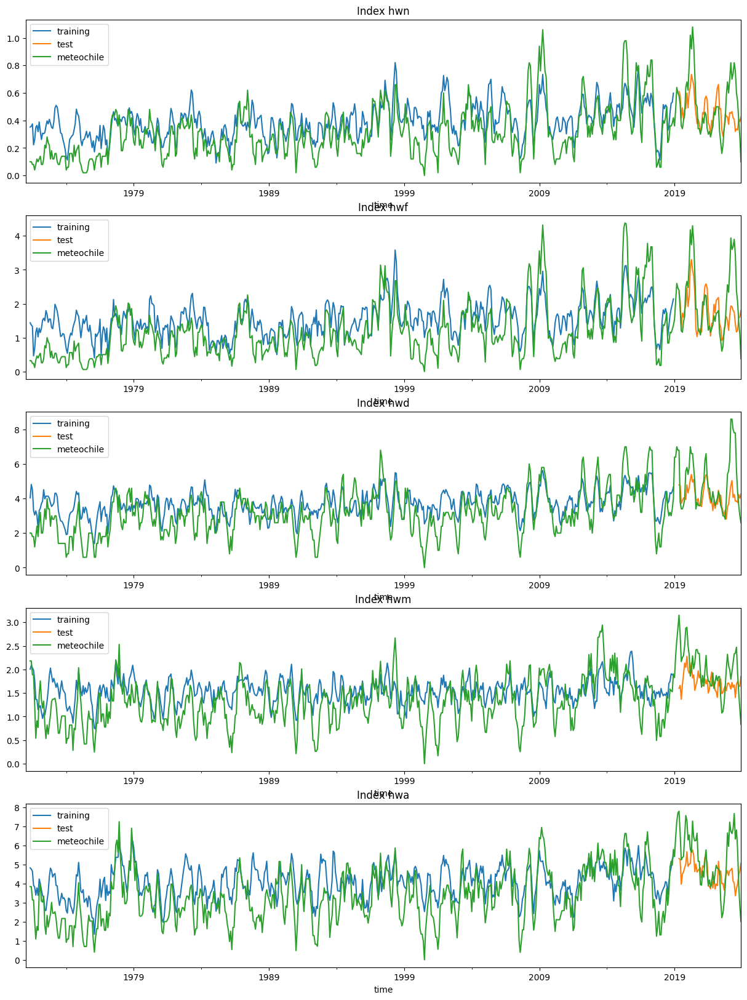

In [42]:
fig, axs = plt.subplots(len(indices_of_interest), figsize=(15, 20))
for i, index in enumerate(indices_of_interest):
    df_pred_train.rolling(5).mean().plot(y=index, ax=axs[i], label="training")
    df_pred_test.rolling(5).mean().plot(y=index, ax=axs[i], label="test")
    hws.rolling(5).mean().plot(y=index, ax=axs[i], label="meteochile")
    axs[i].set_title(f"Index {index}")

In [43]:
mean_scenario = {}
mean_std_scenario = {}
scenario = "historical"

temp_df = pd.DataFrame()
for name, model_scenario in models_scenario_predicted.items():
    temp_df = pd.concat((temp_df, model_scenario[scenario]), axis=1)
    
mean_scenario[scenario] = pd.DataFrame(columns=models_scenario_predicted["EC-Earth3"][scenario].columns,index=model_scenario[scenario].index)
mean_std_scenario[scenario] = pd.DataFrame(columns=models_scenario_predicted["EC-Earth3"][scenario].columns,index=model_scenario[scenario].index)

for col in np.unique(temp_df.columns):
    mean_scenario[scenario][col] = temp_df[col].mean(axis=1)
    mean_std_scenario[scenario][col] = temp_df[col].std(axis=1)
models_scenario_predicted["mean_monthly"] = mean_scenario

models_scenario_predicted["mean_monthly"][scenario] = models_scenario_predicted["mean_monthly"][scenario].astype(np.float64)

models_predicted_yearly = {model: {} for model in models_scenario_predicted.keys()}
models_predicted_decadal = {model: {} for model in models_scenario_predicted.keys()}

for name, model_scenario in models_scenario_predicted.items():
    df = model_scenario[scenario]
    models_predicted_yearly[name][scenario] = transform_time_label(df, "year")
    models_predicted_decadal[name][scenario] = transform_time_label(df, "decade")

pred_train_yearly = transform_time_label(df_pred_train, "year")

mean_yearly_scenario = {}
min_yearly_scenario = {}
max_yearly_scenario = {}
mean_yearly_std_scenario = {}

features = models_predicted_yearly["EC-Earth3"][scenario].columns


temp_df = pd.DataFrame()
for name, model_scenario in models_predicted_yearly.items():
    if "mean" not in name:
        temp_df = pd.concat((temp_df, model_scenario[scenario]), axis=1)

yearly_dates = model_scenario[scenario].index
mean_yearly_scenario[scenario] = pd.DataFrame(columns=features,index=yearly_dates)
min_yearly_scenario[scenario] = pd.DataFrame(columns=features,index=yearly_dates)
max_yearly_scenario[scenario] = pd.DataFrame(columns=features,index=yearly_dates)
mean_yearly_std_scenario[scenario] = pd.DataFrame(columns=features,index=yearly_dates)
for col in np.unique(temp_df.columns):
    mean_yearly_scenario[scenario][col] = temp_df[col].mean(axis=1)
    min_yearly_scenario[scenario][col] = temp_df[col].min(axis=1)
    max_yearly_scenario[scenario][col] = temp_df[col].max(axis=1)
    mean_yearly_std_scenario[scenario][col] = temp_df[col].std(axis=1)

models_predicted_yearly["yearly_then_mean"] = mean_yearly_scenario
models_predicted_yearly["yearly_then_min"] = min_yearly_scenario
models_predicted_yearly["yearly_then_max"] = max_yearly_scenario

In [ ]:
meteochile_yearly = transform_time_label(hws, "year")[indices_of_interest]

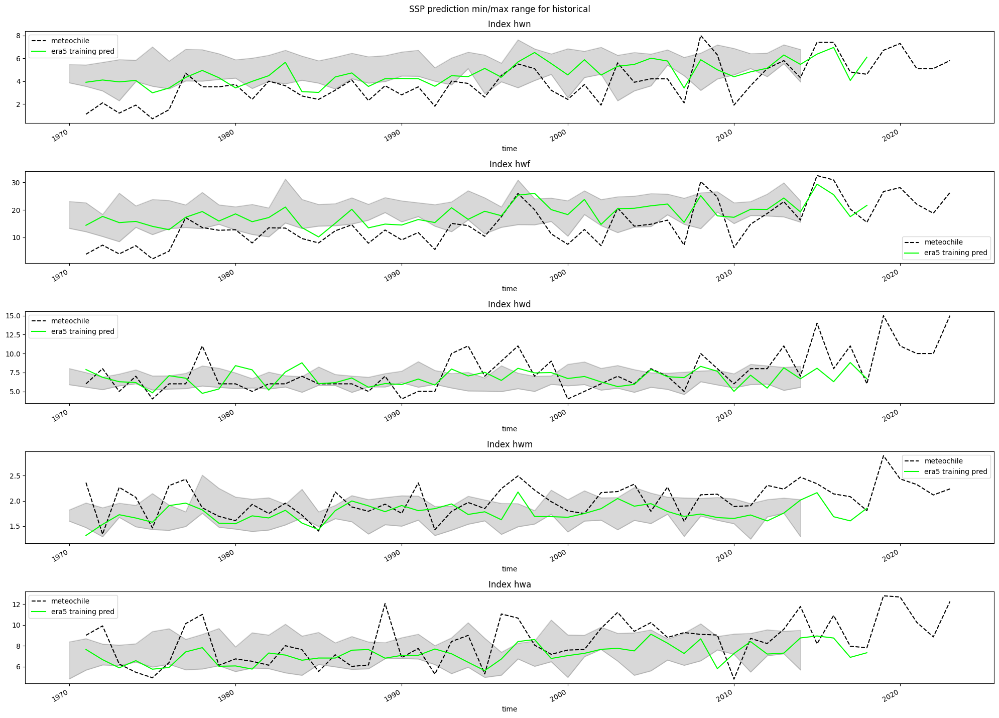

In [45]:
scenarios_prediction_min = models_predicted_yearly["yearly_then_min"]
scenarios_prediction_max = models_predicted_yearly["yearly_then_max"]
colors = {
    "historical": "gray",
    "ssp126": "blue",
    "ssp585": "red"
}
fig, axs = plt.subplots(len(indices_of_interest), figsize=(20, 15))
for i, index in enumerate(indices_of_interest):
    for scenario in ("historical",):
        color=colors[scenario]
        df_min = scenarios_prediction_min[scenario]
        df_max = scenarios_prediction_max[scenario]
        axs[i].plot(
            df_min.index, df_min[index].values, color="black",alpha=0.1, label=f"{scenario}"
        )
        axs[i].plot(
            df_min.index, df_max[index].values, color="black",alpha=0.1, label=f"{scenario}"
        )
        axs[i].fill_between(
            df_min.index, df_min[index].values, df_max[index].values, alpha=0.3, color=color, label=f"{scenario}"
        )
    meteochile_yearly.plot(y=index, linestyle="--", label="meteochile", ax=axs[i], c="black")
    pred_train_yearly.plot(y=index, label="era5 training pred", ax=axs[i], c="lime")
    axs[i].set_title(f"Index {index}")
fig.tight_layout(rect=[0, 0.03, 1, 0.97]) 
fig.suptitle(f"SSP prediction min/max range for historical")
plt.show()

## 5 labels, 1971-2022 training, avg paper bounds

In [52]:
len_pred = 1

['hwn', 'hwf', 'hwd', 'hwm', 'hwa']
Default bounds [-1.16928928 -0.30647585  3.          6.49996949]
Index hwn paper bounds: (-1.447460376173962, -0.34449239190661074, 6.141647132786026, 5.202271184108693)
Index hwf paper bounds: (-1.1794737774848172, -0.34860340377218507, 6.113162893903127, 6.682564003905567)
Index hwd paper bounds: (-4.18818950996255, -0.1093314747387045, 3.581063890463821, 4.552220565517117)
Index hwm paper bounds: (-5.046231952784555, 0.03713432255517214, 2.660019929098329, 3.9056889564199695)
Index hwa paper bounds: (-4.2321118218383535, -0.0338456512292951, 3.079599837058667, 3.175179624999176)
Result bounds [-5.046231952784555, -0.15982771981832464, 4.3150987366619935, 6.682564003905567]


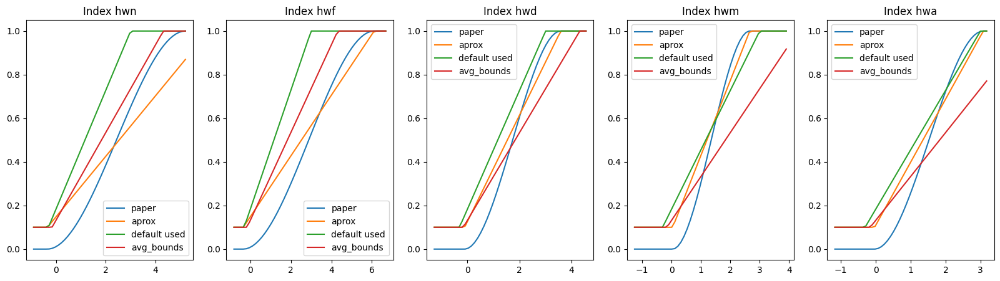

In [53]:
indices_of_interest = ["hwn", "hwf", "hwd", "hwm", "hwa"]
print(indices_of_interest)
bounds = np.array((-1.1692892810242344, -0.30647585455315646, 3.0, 6.499969486244418))
print("Default bounds", bounds)

bounds_paper_list = []

fig, axs = plt.subplots(1, len(indices_of_interest), figsize=(20,5))
for i, index in enumerate(indices_of_interest):
    hws_index = hws_scaled[[index]].to_numpy()
    hws_index = hws_index.reshape(hws_index.shape[0])
    relevance = create_relevance_function(hws_index)
    l, m ,u  = compute_adjusted_boxplot_bounds(hws_index)
    bounds_paper = (l, m, u, max(hws_index))
    bounds_paper_list.append(bounds_paper)

    print(f"Index {index} paper bounds:", bounds_paper)
    f2 = piecewise_linear_phi_2(bounds_paper)
    f0 = piecewise_linear_phi_2(bounds)
    x = np.linspace(np.min(hws_index), np.max(hws_index))
    axs[i].plot(x, relevance(x), label="paper")
    axs[i].plot(x, f2(x), label="aprox")
    axs[i].plot(x, f0(x), label="default used")
    axs[i].set_title(f"Index {index}")

bounds_avg = average_bounds(bounds_paper_list)

for i, index in enumerate(indices_of_interest):
    hws_index = hws_scaled[[index]].to_numpy()
    hws_index = hws_index.reshape(hws_index.shape[0])
    x = np.linspace(np.min(hws_index), np.max(hws_index))
    axs[i].plot(x, piecewise_linear_phi_2(bounds_avg)(x), label="avg_bounds")
    axs[i].legend()
plt.show()

In [54]:
hws_labels = hws[indices_of_interest]
era5_df = pd.concat((historical_dfs["ERA5"],hws_labels),axis=1)

In [ ]:
loss_fn = SERA(bounds=bounds_avg,T=100, initial_weight=0.1, fn="piecewise2")
df_pred_train = pd.DataFrame(columns=indices_of_interest, index=era5_df.index)
df_pred_test = pd.DataFrame(columns=indices_of_interest, index=era5_df.index)
models_scenario_predicted = {model: {} for model in cmip6_drivers_dfs.keys()}


for season in range (1,13):

    df_season = era5_df[era5_df.index.month==season]
    model = Sequential([
        Conv1D(16, kernel_size=1, activation="relu", input_shape=(1, len(era5_df.columns) - len(indices_of_interest))),
        Reshape((1, 16)),  # Back to time dimension
        SimpleRNN(8, activation="tanh"),
        Dropout(0.1),
        Dense(len(indices_of_interest))
    ])

    pred = PredictionModel(df_season, season, indices_of_interest, model, name_regressor="CNNRNN16",loss_fn=loss_fn)
    pred.compile_keras_model()

    y_train, y_pred_train = pred.train(len_pred)
    y_test, y_pred = pred.predict(len_pred)
    # dates = pd.date_range(pd.to_datetime(f"1972-{season}"),periods=len(y_train) + len(y_test),freq=pd.offsets.YearBegin(1))
    # pred.plot_predictions(dates, len_pred, y_train, y_pred_train, y_test, y_pred)
    df_pred_train.loc[df_season.index[:-len_pred]] = pred.label_scaler.inverse_transform(y_pred_train)
    df_pred_train.sort_index(inplace=True)
    df_pred_test.loc[df_season.index[-len_pred:]] = pred.label_scaler.inverse_transform(y_pred)
    df_pred_test.sort_index(inplace=True)
    for name, scenarios_df in cmip6_drivers_dfs.items():
        scenario = "historical"
        if season==1:
            models_scenario_predicted[name][scenario] = pd.DataFrame()
        df_target = scenarios_df[scenario][scenarios_df[scenario].index.month==season]
        df_target = df_target[(df_target.index.year >=1970) & (df_target.index.year <= 2014)]
        
        # Normalize cmip6 features for machine input
        target = pred.scaler_X.transform(df_target[pred.scaler_X.feature_names_in_])
        # Reshape for keras and predict
        predicted_normalized = pred.regressor.predict(pred.reshape_for_keras(target))
        # Transform back to original range
        predicted_real = pred.label_scaler.inverse_transform(predicted_normalized)
        predicted = pd.DataFrame(predicted_real).rename(columns={i: label for i,label in enumerate(indices_of_interest)})
        predicted["Date"] = df_target.index
        predicted.set_index("Date",inplace=True)
        models_scenario_predicted[name][scenario] = pd.concat((models_scenario_predicted[name][scenario],predicted),axis=0)
        
df_pred_train = df_pred_train.dropna()
df_pred_train = df_pred_train.astype(np.number)

df_pred_test = df_pred_test.dropna()
df_pred_test = df_pred_test.astype(np.number)


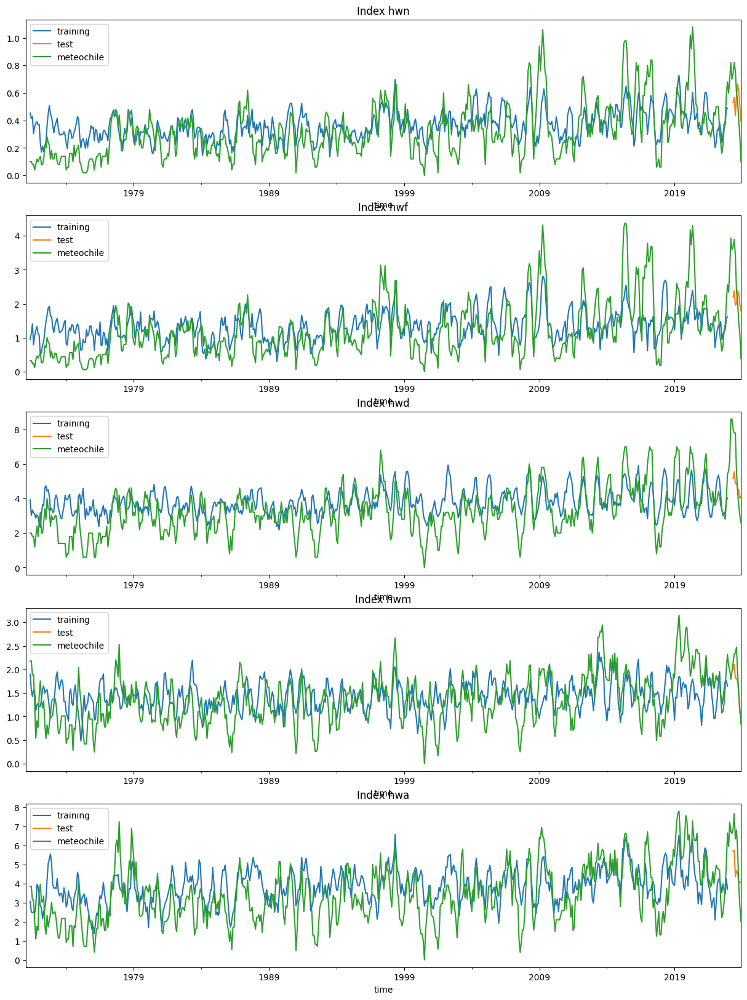

In [56]:
fig, axs = plt.subplots(len(indices_of_interest), figsize=(15, 20))
for i, index in enumerate(indices_of_interest):
    df_pred_train.rolling(5).mean().plot(y=index, ax=axs[i], label="training")
    df_pred_test.rolling(5).mean().plot(y=index, ax=axs[i], label="test")
    hws.rolling(5).mean().plot(y=index, ax=axs[i], label="meteochile")
    axs[i].set_title(f"Index {index}")

In [57]:
mean_scenario = {}
mean_std_scenario = {}
scenario = "historical"

temp_df = pd.DataFrame()
for name, model_scenario in models_scenario_predicted.items():
    temp_df = pd.concat((temp_df, model_scenario[scenario]), axis=1)
    
mean_scenario[scenario] = pd.DataFrame(columns=models_scenario_predicted["EC-Earth3"][scenario].columns,index=model_scenario[scenario].index)
mean_std_scenario[scenario] = pd.DataFrame(columns=models_scenario_predicted["EC-Earth3"][scenario].columns,index=model_scenario[scenario].index)

for col in np.unique(temp_df.columns):
    mean_scenario[scenario][col] = temp_df[col].mean(axis=1)
    mean_std_scenario[scenario][col] = temp_df[col].std(axis=1)
models_scenario_predicted["mean_monthly"] = mean_scenario

models_scenario_predicted["mean_monthly"][scenario] = models_scenario_predicted["mean_monthly"][scenario].astype(np.float64)

models_predicted_yearly = {model: {} for model in models_scenario_predicted.keys()}
models_predicted_decadal = {model: {} for model in models_scenario_predicted.keys()}

for name, model_scenario in models_scenario_predicted.items():
    df = model_scenario[scenario]
    models_predicted_yearly[name][scenario] = transform_time_label(df, "year")
    models_predicted_decadal[name][scenario] = transform_time_label(df, "decade")

pred_train_yearly = transform_time_label(df_pred_train, "year")

mean_yearly_scenario = {}
min_yearly_scenario = {}
max_yearly_scenario = {}
mean_yearly_std_scenario = {}

features = models_predicted_yearly["EC-Earth3"][scenario].columns


temp_df = pd.DataFrame()
for name, model_scenario in models_predicted_yearly.items():
    if "mean" not in name:
        temp_df = pd.concat((temp_df, model_scenario[scenario]), axis=1)

yearly_dates = model_scenario[scenario].index
mean_yearly_scenario[scenario] = pd.DataFrame(columns=features,index=yearly_dates)
min_yearly_scenario[scenario] = pd.DataFrame(columns=features,index=yearly_dates)
max_yearly_scenario[scenario] = pd.DataFrame(columns=features,index=yearly_dates)
mean_yearly_std_scenario[scenario] = pd.DataFrame(columns=features,index=yearly_dates)
for col in np.unique(temp_df.columns):
    mean_yearly_scenario[scenario][col] = temp_df[col].mean(axis=1)
    min_yearly_scenario[scenario][col] = temp_df[col].min(axis=1)
    max_yearly_scenario[scenario][col] = temp_df[col].max(axis=1)
    mean_yearly_std_scenario[scenario][col] = temp_df[col].std(axis=1)

models_predicted_yearly["yearly_then_mean"] = mean_yearly_scenario
models_predicted_yearly["yearly_then_min"] = min_yearly_scenario
models_predicted_yearly["yearly_then_max"] = max_yearly_scenario

In [58]:
meteochile_yearly = transform_time_label(hws, "year")[indices_of_interest]

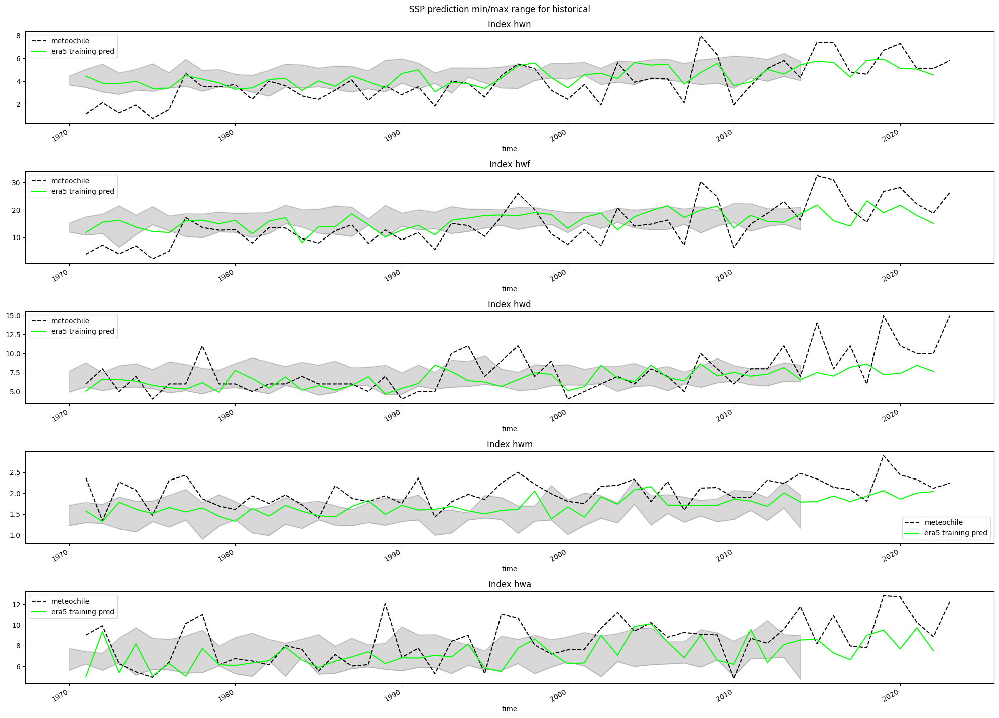

In [59]:
scenarios_prediction_min = models_predicted_yearly["yearly_then_min"]
scenarios_prediction_max = models_predicted_yearly["yearly_then_max"]
colors = {
    "historical": "gray",
    "ssp126": "blue",
    "ssp585": "red"
}
fig, axs = plt.subplots(len(indices_of_interest), figsize=(20, 15))
for i, index in enumerate(indices_of_interest):
    for scenario in ("historical",):
        color=colors[scenario]
        df_min = scenarios_prediction_min[scenario]
        df_max = scenarios_prediction_max[scenario]
        axs[i].plot(
            df_min.index, df_min[index].values, color="black",alpha=0.1, label=f"{scenario}"
        )
        axs[i].plot(
            df_min.index, df_max[index].values, color="black",alpha=0.1, label=f"{scenario}"
        )
        axs[i].fill_between(
            df_min.index, df_min[index].values, df_max[index].values, alpha=0.3, color=color, label=f"{scenario}"
        )
    meteochile_yearly.plot(y=index, linestyle="--", label="meteochile", ax=axs[i], c="black")
    pred_train_yearly.plot(y=index, label="era5 training pred", ax=axs[i], c="lime")
    axs[i].set_title(f"Index {index}")
fig.tight_layout(rect=[0, 0.03, 1, 0.97]) 
fig.suptitle(f"SSP prediction min/max range for historical")
plt.show()

## Distribution 1: hwn, hwf, hwi, 1971-2018 training

In [60]:
len_pred = 5

['hwn', 'hwf', 'hwi']
Default bounds [-1.16928928 -0.30647585  3.          6.49996949]
Index hwn paper bounds: (-1.447460376173962, -0.34449239190661074, 6.141647132786026, 5.202271184108693)
Index hwf paper bounds: (-1.1794737774848172, -0.34860340377218507, 6.113162893903127, 6.682564003905567)
Index hwi paper bounds: (-0.8257523113973835, -0.40104469583445124, 7.00122242637302, 7.347397429894099)
Result bounds [-1.447460376173962, -0.3647134971710823, 6.418677484354057, 7.347397429894099]


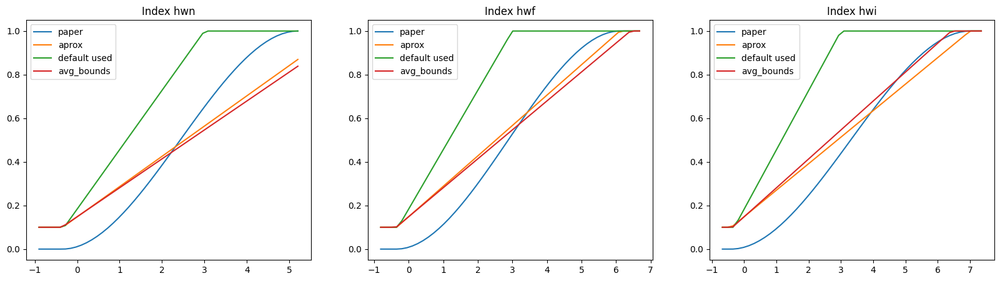

In [61]:
indices_of_interest = ["hwn", "hwf", "hwi"]
print(indices_of_interest)
bounds = np.array((-1.1692892810242344, -0.30647585455315646, 3.0, 6.499969486244418))
print("Default bounds", bounds)

bounds_paper_list = []

fig, axs = plt.subplots(1, len(indices_of_interest), figsize=(20,5))
for i, index in enumerate(indices_of_interest):
    hws_index = hws_scaled[[index]].to_numpy()
    hws_index = hws_index.reshape(hws_index.shape[0])
    relevance = create_relevance_function(hws_index)
    l, m ,u  = compute_adjusted_boxplot_bounds(hws_index)
    bounds_paper = (l, m, u, max(hws_index))
    bounds_paper_list.append(bounds_paper)

    print(f"Index {index} paper bounds:", bounds_paper)
    f2 = piecewise_linear_phi_2(bounds_paper)
    f0 = piecewise_linear_phi_2(bounds)
    x = np.linspace(np.min(hws_index), np.max(hws_index))
    axs[i].plot(x, relevance(x), label="paper")
    axs[i].plot(x, f2(x), label="aprox")
    axs[i].plot(x, f0(x), label="default used")
    axs[i].set_title(f"Index {index}")

bounds_avg = average_bounds(bounds_paper_list)

for i, index in enumerate(indices_of_interest):
    hws_index = hws_scaled[[index]].to_numpy()
    hws_index = hws_index.reshape(hws_index.shape[0])
    x = np.linspace(np.min(hws_index), np.max(hws_index))
    axs[i].plot(x, piecewise_linear_phi_2(bounds_avg)(x), label="avg_bounds")
    axs[i].legend()
plt.show()

In [62]:
hws_labels = hws[indices_of_interest]
era5_df = pd.concat((historical_dfs["ERA5"],hws_labels),axis=1)

1/1 [==============================] - 0s 24ms/step


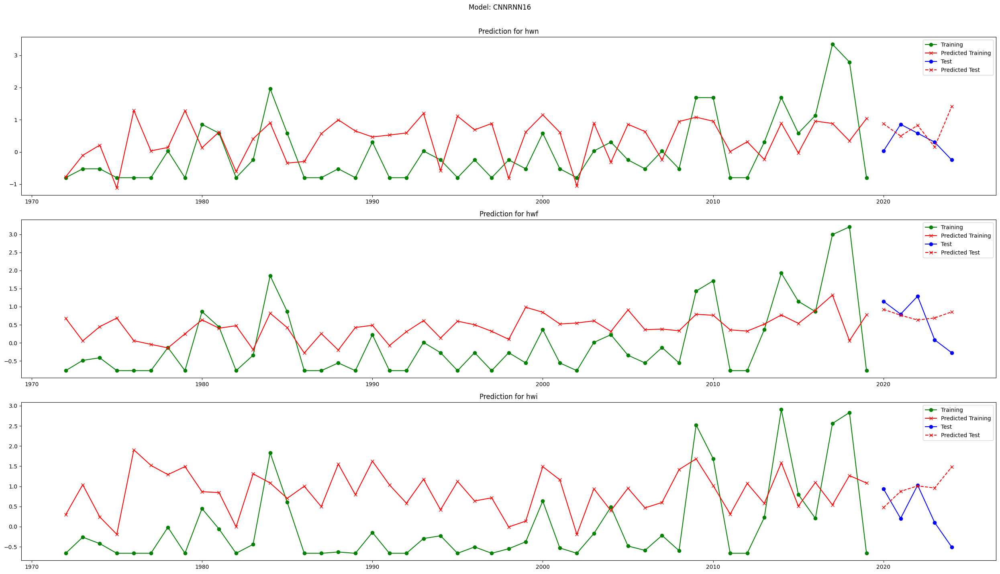

1/1 [==============================] - 0s 16ms/step


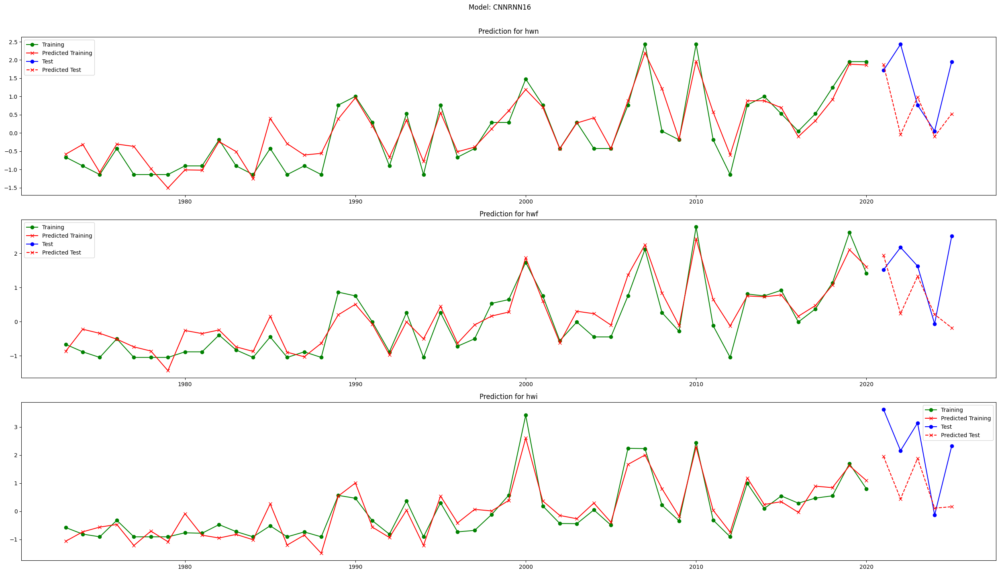

1/1 [==============================] - 0s 21ms/step


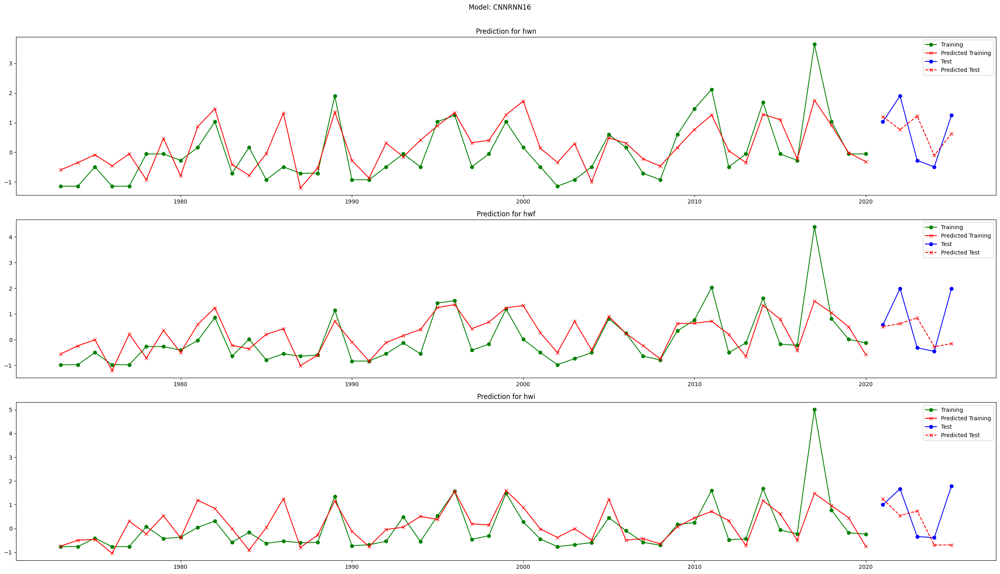

1/1 [==============================] - 0s 21ms/step


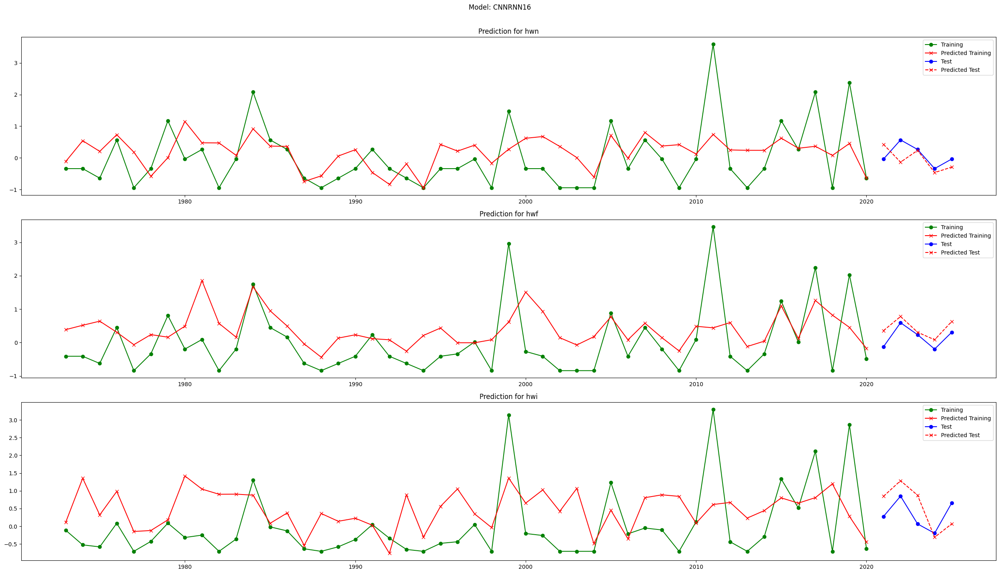

1/1 [==============================] - 0s 21ms/step


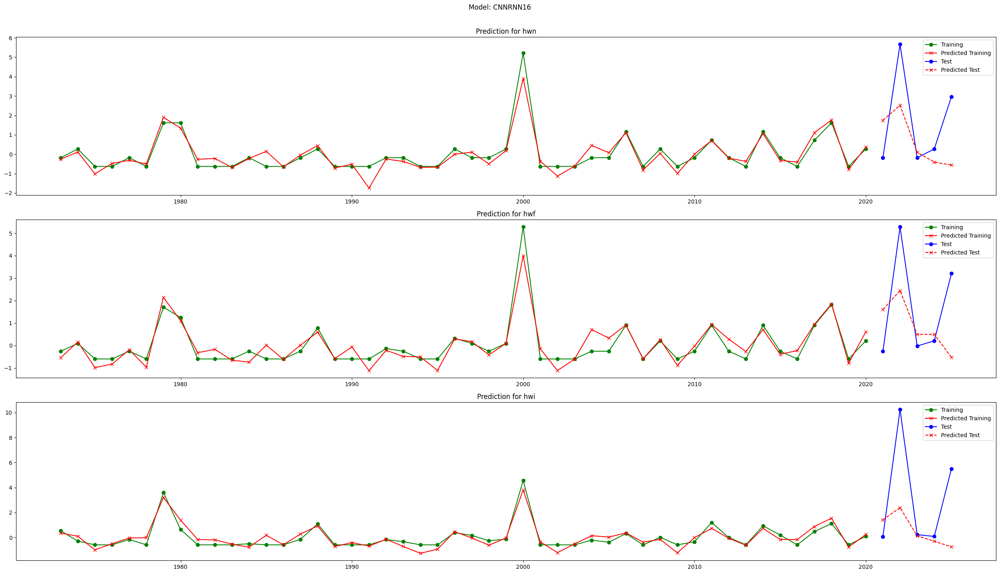

1/1 [==============================] - 0s 21ms/step


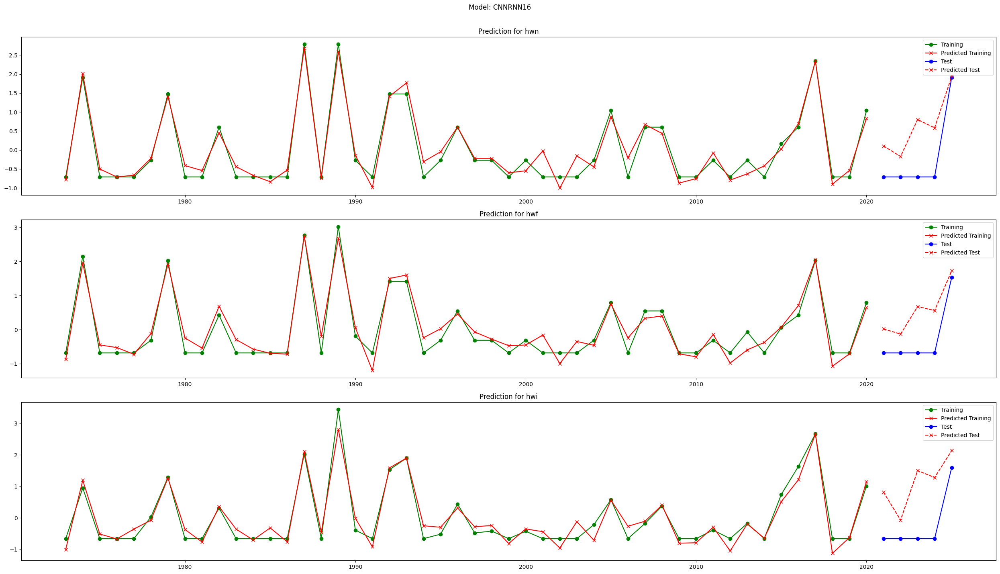

1/1 [==============================] - 0s 21ms/step


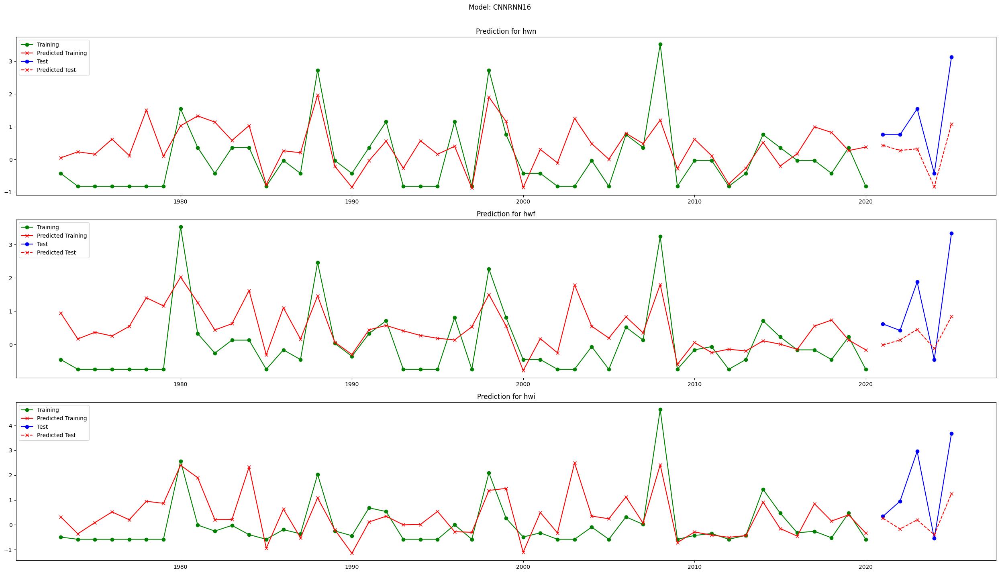

1/1 [==============================] - 0s 21ms/step


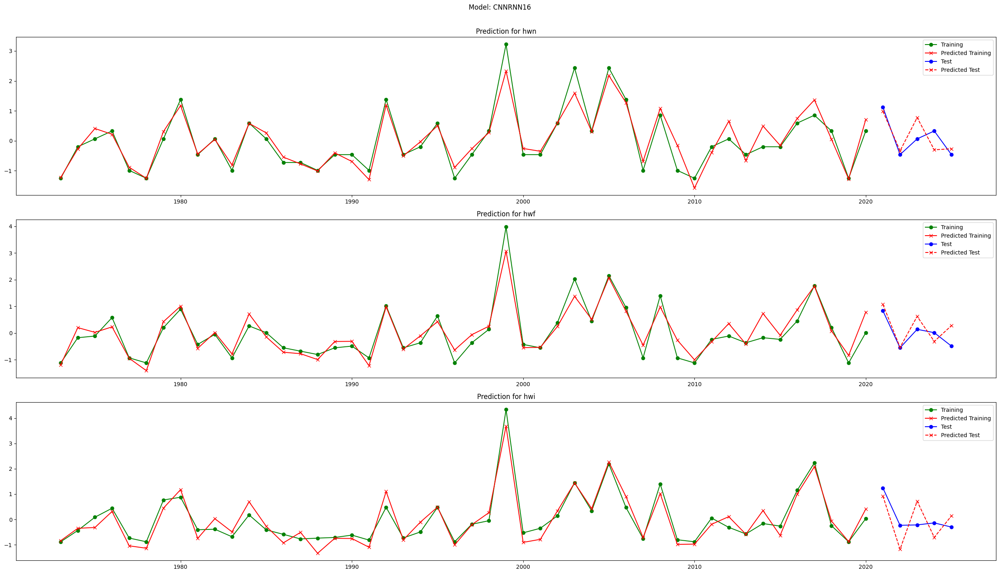

1/1 [==============================] - 0s 21ms/step


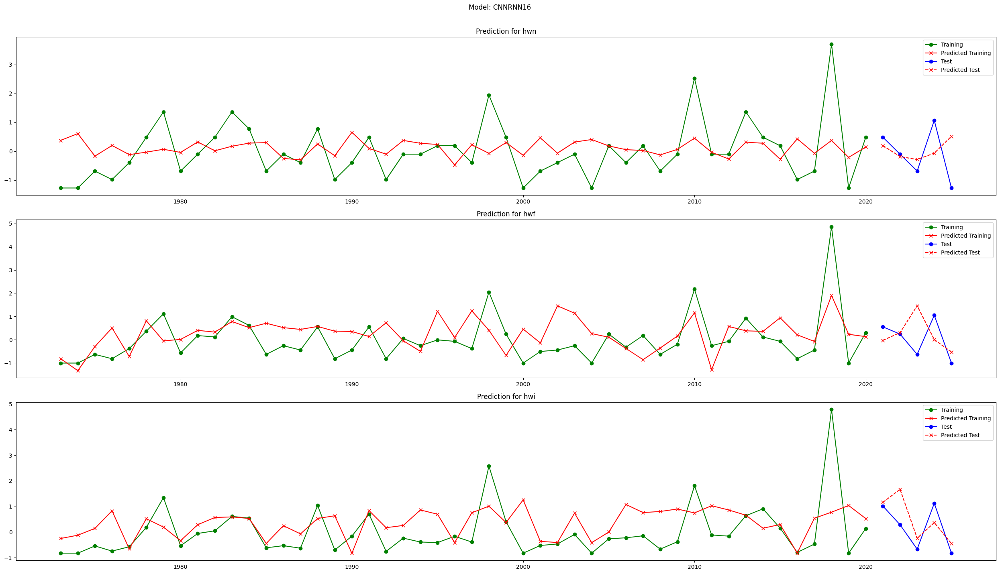

1/1 [==============================] - 0s 21ms/step


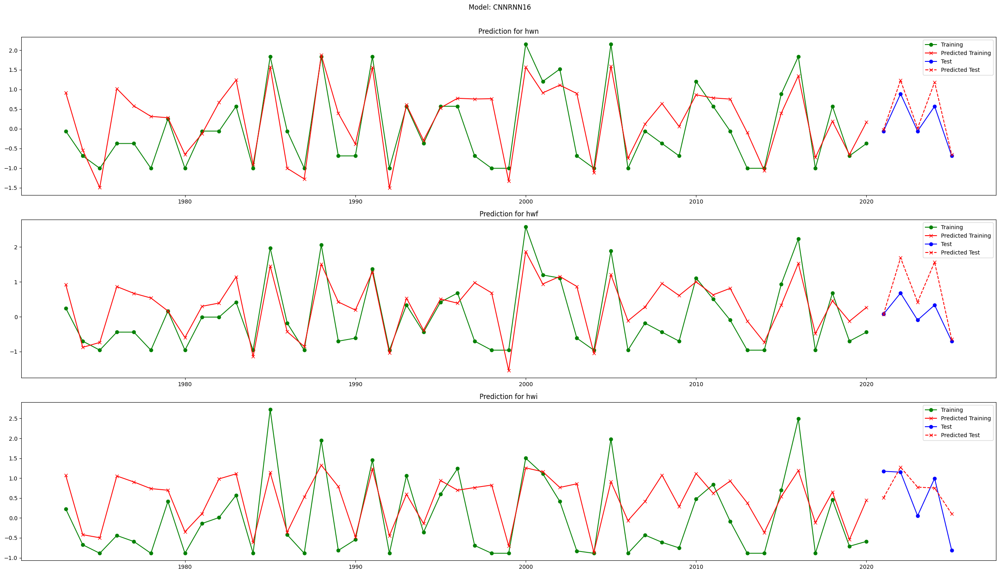

1/1 [==============================] - 0s 22ms/step


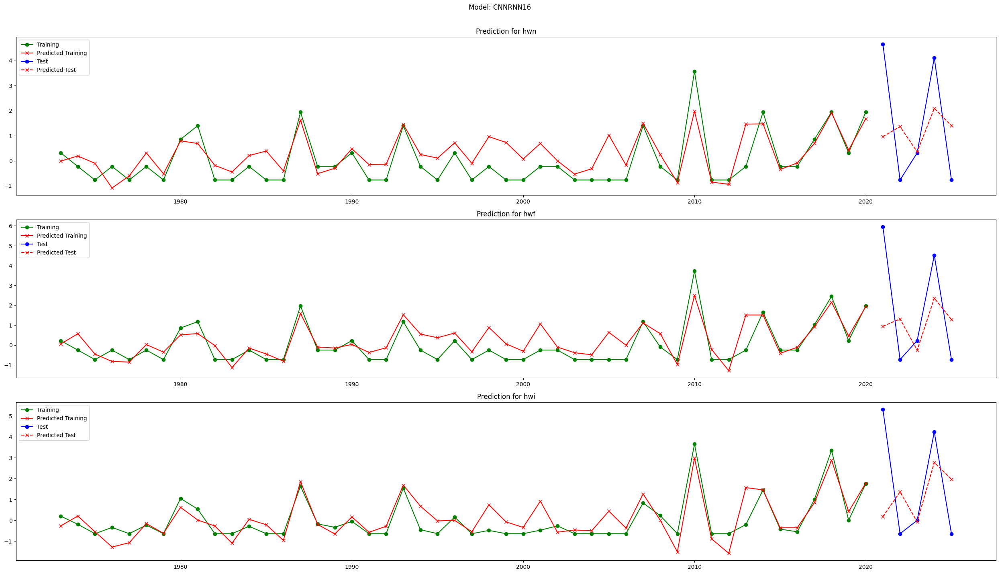

1/1 [==============================] - 0s 21ms/step


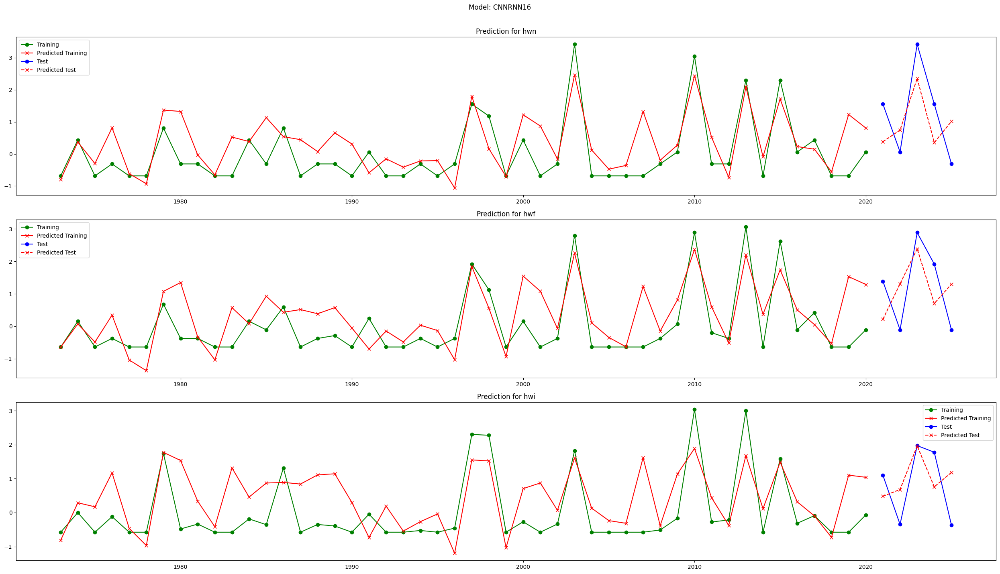

2/2 [==============================] - 0s 2ms/step


c:\Users\marti\AppData\Local\Programs\Python\Python310\lib\site-packages\pandas\core\dtypes\common.py:1687: DeprecationWarning: Converting `np.inexact` or `np.floating` to a dtype is deprecated. The current result is `float64` which is not strictly correct.
  npdtype = np.dtype(dtype)
c:\Users\marti\AppData\Local\Programs\Python\Python310\lib\site-packages\pandas\core\dtypes\common.py:1687: DeprecationWarning: Converting `np.inexact` or `np.floating` to a dtype is deprecated. The current result is `float64` which is not strictly correct.
  npdtype = np.dtype(dtype)


In [63]:
bounds = (-1.1692892810242344, -0.30647585455315646, 3.0, 6.499969486244418)

loss_fn = SERA(bounds=bounds,T=100, initial_weight=0.1, fn="piecewise2")
df_pred_train = pd.DataFrame(columns=indices_of_interest, index=era5_df.index)
df_pred_test = pd.DataFrame(columns=indices_of_interest, index=era5_df.index)
models_scenario_predicted = {model: {} for model in cmip6_drivers_dfs.keys()}


for season in range (1,13):

    df_season = era5_df[era5_df.index.month==season]
    model = Sequential([
        Conv1D(16, kernel_size=1, activation="relu", input_shape=(1, len(era5_df.columns) - len(indices_of_interest))),
        Reshape((1, 16)),  # Back to time dimension
        SimpleRNN(8, activation="tanh"),
        Dropout(0.1),
        Dense(len(indices_of_interest))
    ])

    pred = PredictionModel(df_season, season, indices_of_interest, model, name_regressor="CNNRNN16",loss_fn=loss_fn)
    pred.compile_keras_model()

    y_train, y_pred_train = pred.train(len_pred)
    y_test, y_pred = pred.predict(len_pred)
    dates = pd.date_range(pd.to_datetime(f"1972-{season}"),periods=len(y_train) + len(y_test),freq=pd.offsets.YearBegin(1))
    pred.plot_predictions(dates, len_pred, y_train, y_pred_train, y_test, y_pred)
    df_pred_train.loc[df_season.index[:-len_pred]] = pred.label_scaler.inverse_transform(y_pred_train)
    df_pred_train.sort_index(inplace=True)
    df_pred_test.loc[df_season.index[-len_pred:]] = pred.label_scaler.inverse_transform(y_pred)
    df_pred_test.sort_index(inplace=True)
    for name, scenarios_df in cmip6_drivers_dfs.items():
        scenario = "historical"
        if season==1:
            models_scenario_predicted[name][scenario] = pd.DataFrame()
        df_target = scenarios_df[scenario][scenarios_df[scenario].index.month==season]
        df_target = df_target[(df_target.index.year >=1970) & (df_target.index.year <= 2014)]
        
        # Normalize cmip6 features for machine input
        target = pred.scaler_X.transform(df_target[pred.scaler_X.feature_names_in_])
        # Reshape for keras and predict
        predicted_normalized = pred.regressor.predict(pred.reshape_for_keras(target))
        # Transform back to original range
        predicted_real = pred.label_scaler.inverse_transform(predicted_normalized)
        predicted = pd.DataFrame(predicted_real).rename(columns={i: label for i,label in enumerate(indices_of_interest)})
        predicted["Date"] = df_target.index
        predicted.set_index("Date",inplace=True)
        models_scenario_predicted[name][scenario] = pd.concat((models_scenario_predicted[name][scenario],predicted),axis=0)
        
df_pred_train = df_pred_train.dropna()
df_pred_train = df_pred_train.astype(np.number)

df_pred_test = df_pred_test.dropna()
df_pred_test = df_pred_test.astype(np.number)


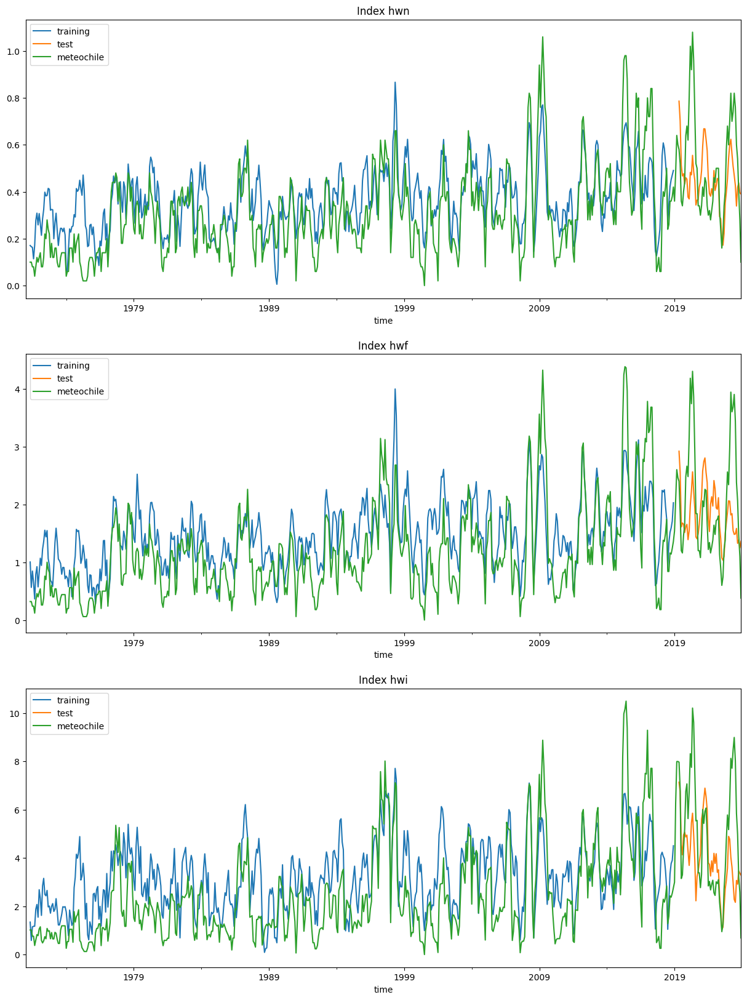

In [64]:
fig, axs = plt.subplots(len(indices_of_interest), figsize=(15, 20))
for i, index in enumerate(indices_of_interest):
    df_pred_train.rolling(5).mean().plot(y=index, ax=axs[i], label="training")
    df_pred_test.rolling(5).mean().plot(y=index, ax=axs[i], label="test")
    hws.rolling(5).mean().plot(y=index, ax=axs[i], label="meteochile")
    axs[i].set_title(f"Index {index}")

In [65]:
mean_scenario = {}
mean_std_scenario = {}
scenario = "historical"

temp_df = pd.DataFrame()
for name, model_scenario in models_scenario_predicted.items():
    temp_df = pd.concat((temp_df, model_scenario[scenario]), axis=1)
    
mean_scenario[scenario] = pd.DataFrame(columns=models_scenario_predicted["EC-Earth3"][scenario].columns,index=model_scenario[scenario].index)
mean_std_scenario[scenario] = pd.DataFrame(columns=models_scenario_predicted["EC-Earth3"][scenario].columns,index=model_scenario[scenario].index)

for col in np.unique(temp_df.columns):
    mean_scenario[scenario][col] = temp_df[col].mean(axis=1)
    mean_std_scenario[scenario][col] = temp_df[col].std(axis=1)
models_scenario_predicted["mean_monthly"] = mean_scenario

models_scenario_predicted["mean_monthly"][scenario] = models_scenario_predicted["mean_monthly"][scenario].astype(np.float64)

models_predicted_yearly = {model: {} for model in models_scenario_predicted.keys()}
models_predicted_decadal = {model: {} for model in models_scenario_predicted.keys()}

for name, model_scenario in models_scenario_predicted.items():
    df = model_scenario[scenario]
    models_predicted_yearly[name][scenario] = transform_time_label(df, "year")
    models_predicted_decadal[name][scenario] = transform_time_label(df, "decade")

pred_train_yearly = transform_time_label(df_pred_train, "year")

mean_yearly_scenario = {}
min_yearly_scenario = {}
max_yearly_scenario = {}
mean_yearly_std_scenario = {}

features = models_predicted_yearly["EC-Earth3"][scenario].columns


temp_df = pd.DataFrame()
for name, model_scenario in models_predicted_yearly.items():
    if "mean" not in name:
        temp_df = pd.concat((temp_df, model_scenario[scenario]), axis=1)

yearly_dates = model_scenario[scenario].index
mean_yearly_scenario[scenario] = pd.DataFrame(columns=features,index=yearly_dates)
min_yearly_scenario[scenario] = pd.DataFrame(columns=features,index=yearly_dates)
max_yearly_scenario[scenario] = pd.DataFrame(columns=features,index=yearly_dates)
mean_yearly_std_scenario[scenario] = pd.DataFrame(columns=features,index=yearly_dates)
for col in np.unique(temp_df.columns):
    mean_yearly_scenario[scenario][col] = temp_df[col].mean(axis=1)
    min_yearly_scenario[scenario][col] = temp_df[col].min(axis=1)
    max_yearly_scenario[scenario][col] = temp_df[col].max(axis=1)
    mean_yearly_std_scenario[scenario][col] = temp_df[col].std(axis=1)

models_predicted_yearly["yearly_then_mean"] = mean_yearly_scenario
models_predicted_yearly["yearly_then_min"] = min_yearly_scenario
models_predicted_yearly["yearly_then_max"] = max_yearly_scenario

In [66]:
meteochile_yearly = transform_time_label(hws, "year")[indices_of_interest]

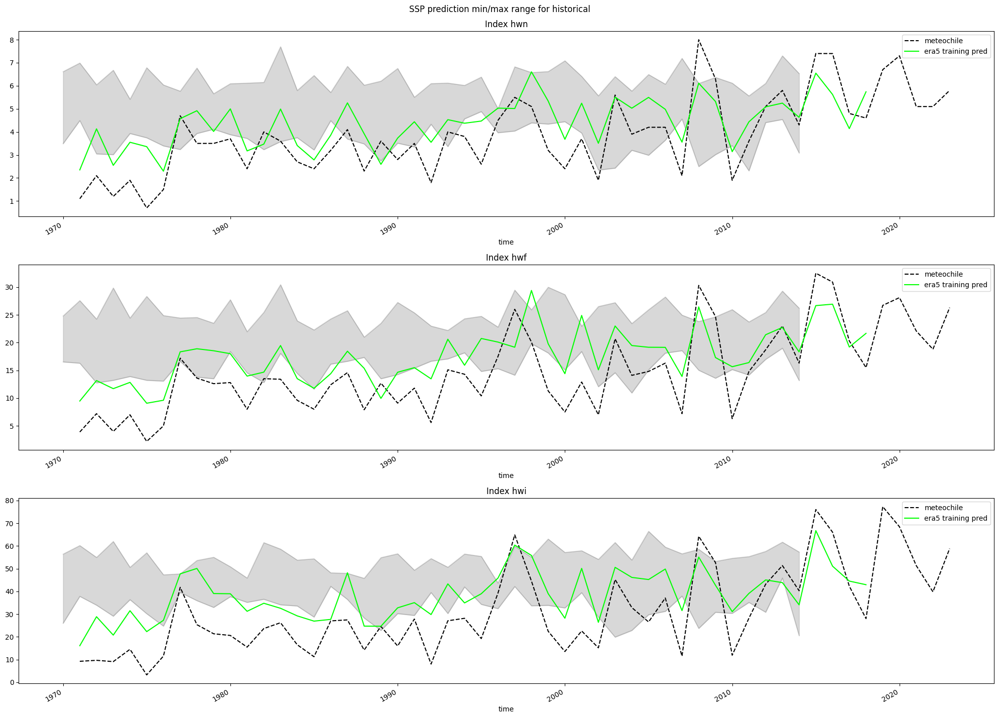

In [67]:
scenarios_prediction_min = models_predicted_yearly["yearly_then_min"]
scenarios_prediction_max = models_predicted_yearly["yearly_then_max"]
colors = {
    "historical": "gray",
    "ssp126": "blue",
    "ssp585": "red"
}
fig, axs = plt.subplots(len(indices_of_interest), figsize=(20, 15))
for i, index in enumerate(indices_of_interest):
    for scenario in ("historical",):
        color=colors[scenario]
        df_min = scenarios_prediction_min[scenario]
        df_max = scenarios_prediction_max[scenario]
        axs[i].plot(
            df_min.index, df_min[index].values, color="black",alpha=0.1, label=f"{scenario}"
        )
        axs[i].plot(
            df_min.index, df_max[index].values, color="black",alpha=0.1, label=f"{scenario}"
        )
        axs[i].fill_between(
            df_min.index, df_min[index].values, df_max[index].values, alpha=0.3, color=color, label=f"{scenario}"
        )
    meteochile_yearly.plot(y=index, linestyle="--", label="meteochile", ax=axs[i], c="black")
    pred_train_yearly.plot(y=index, label="era5 training pred", ax=axs[i], c="lime")
    axs[i].set_title(f"Index {index}")
fig.tight_layout(rect=[0, 0.03, 1, 0.97]) 
fig.suptitle(f"SSP prediction min/max range for historical")
plt.show()

## Distribution 1: hwn, hwf, hwi, 1971-2018 training, avg bounds

In [68]:
len_pred = 5

['hwn', 'hwf', 'hwi']
Default bounds [-1.16928928 -0.30647585  3.          6.49996949]
Index hwn paper bounds: (-1.447460376173962, -0.34449239190661074, 6.141647132786026, 5.202271184108693)
Index hwf paper bounds: (-1.1794737774848172, -0.34860340377218507, 6.113162893903127, 6.682564003905567)
Index hwi paper bounds: (-0.8257523113973835, -0.40104469583445124, 7.00122242637302, 7.347397429894099)
Result bounds [-1.447460376173962, -0.3647134971710823, 6.418677484354057, 7.347397429894099]


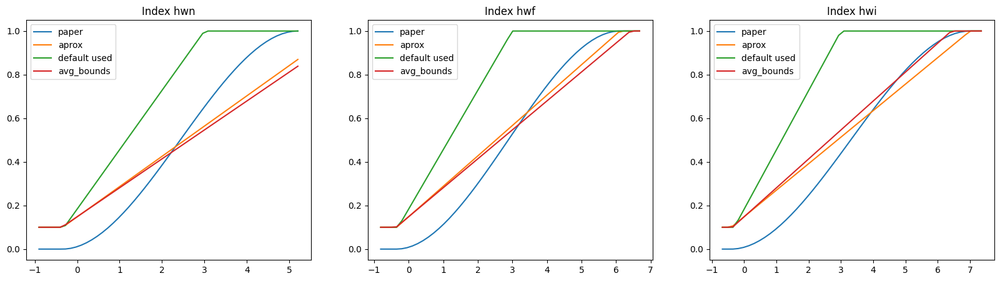

In [69]:
indices_of_interest = ["hwn", "hwf", "hwi"]
print(indices_of_interest)
bounds = np.array((-1.1692892810242344, -0.30647585455315646, 3.0, 6.499969486244418))
print("Default bounds", bounds)

bounds_paper_list = []

fig, axs = plt.subplots(1, len(indices_of_interest), figsize=(20,5))
for i, index in enumerate(indices_of_interest):
    hws_index = hws_scaled[[index]].to_numpy()
    hws_index = hws_index.reshape(hws_index.shape[0])
    relevance = create_relevance_function(hws_index)
    l, m ,u  = compute_adjusted_boxplot_bounds(hws_index)
    bounds_paper = (l, m, u, max(hws_index))
    bounds_paper_list.append(bounds_paper)

    print(f"Index {index} paper bounds:", bounds_paper)
    f2 = piecewise_linear_phi_2(bounds_paper)
    f0 = piecewise_linear_phi_2(bounds)
    x = np.linspace(np.min(hws_index), np.max(hws_index))
    axs[i].plot(x, relevance(x), label="paper")
    axs[i].plot(x, f2(x), label="aprox")
    axs[i].plot(x, f0(x), label="default used")
    axs[i].set_title(f"Index {index}")

bounds_avg = average_bounds(bounds_paper_list)

for i, index in enumerate(indices_of_interest):
    hws_index = hws_scaled[[index]].to_numpy()
    hws_index = hws_index.reshape(hws_index.shape[0])
    x = np.linspace(np.min(hws_index), np.max(hws_index))
    axs[i].plot(x, piecewise_linear_phi_2(bounds_avg)(x), label="avg_bounds")
    axs[i].legend()
plt.show()

In [70]:
hws_labels = hws[indices_of_interest]
era5_df = pd.concat((historical_dfs["ERA5"],hws_labels),axis=1)

1/1 [==============================] - 0s 22ms/step


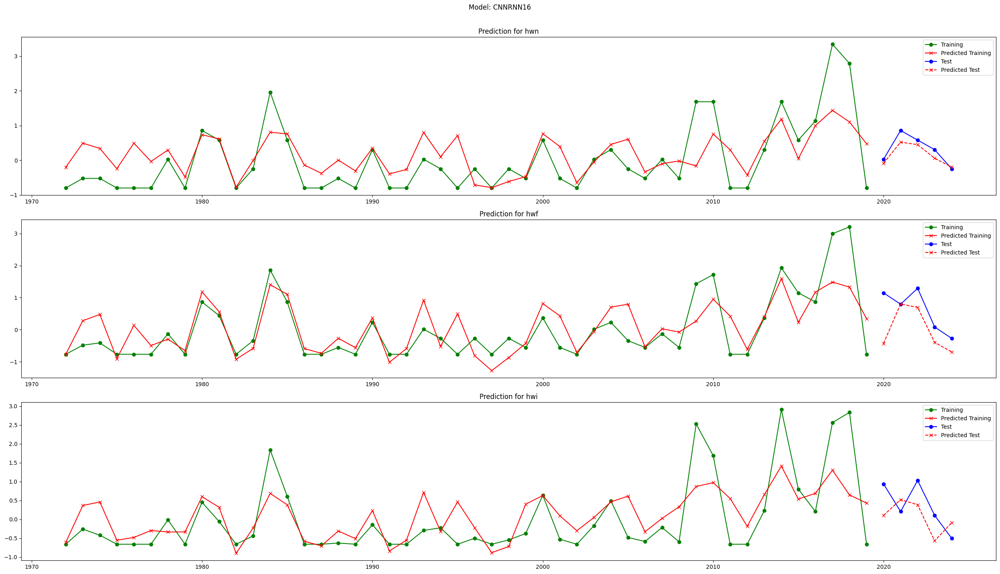

1/1 [==============================] - 0s 26ms/step


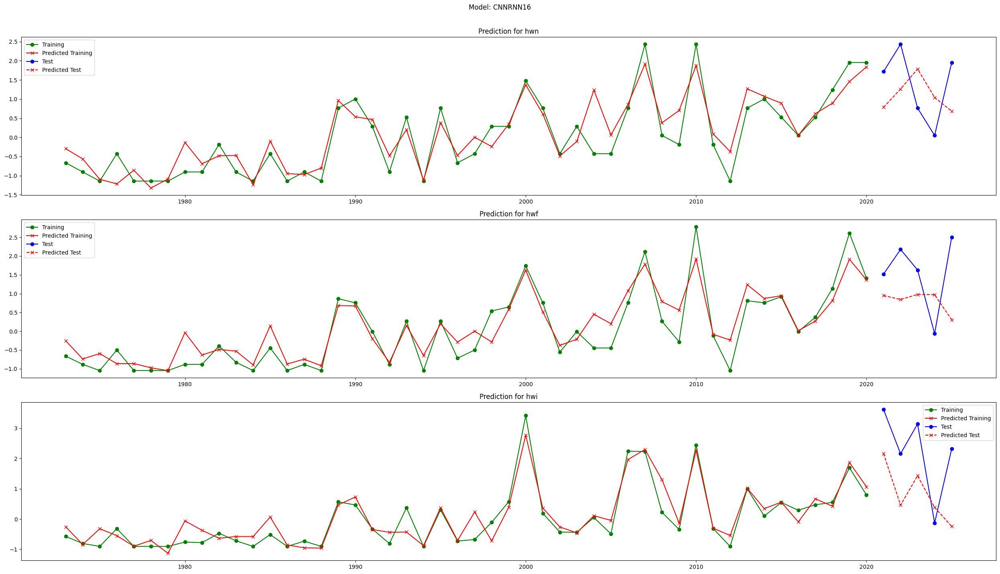

1/1 [==============================] - 0s 21ms/step


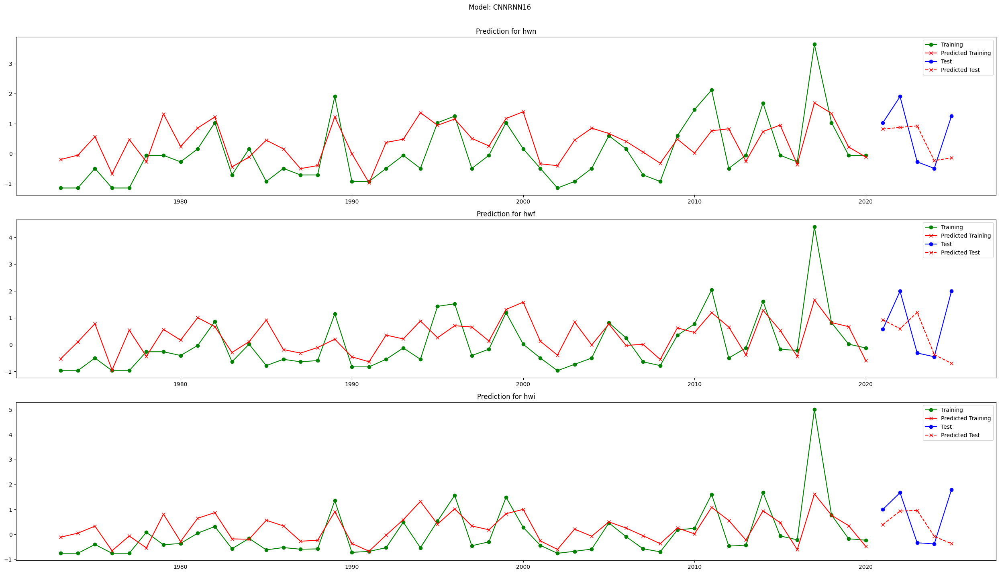

1/1 [==============================] - 0s 22ms/step


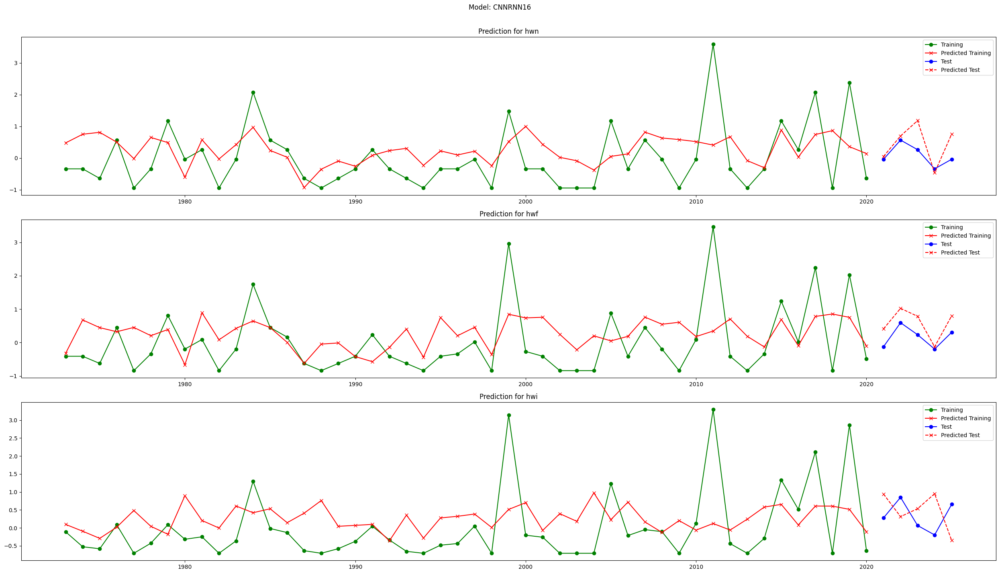

1/1 [==============================] - 0s 19ms/step


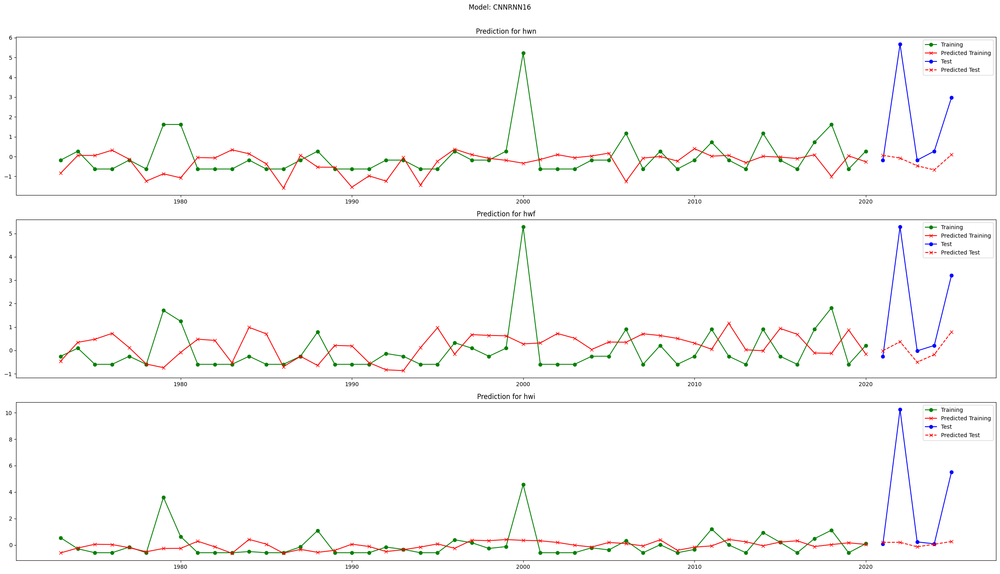

1/1 [==============================] - 0s 21ms/step


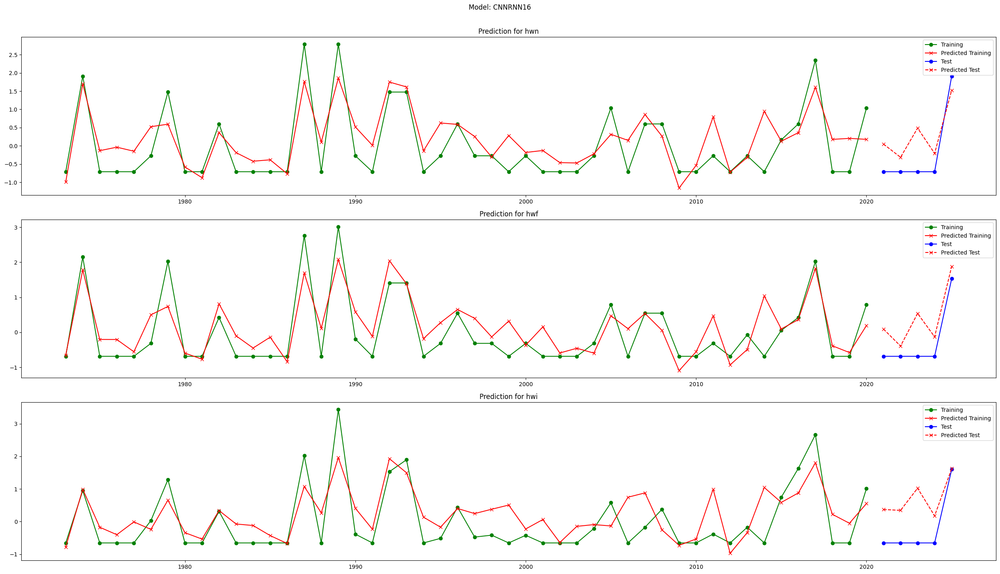

1/1 [==============================] - 0s 21ms/step


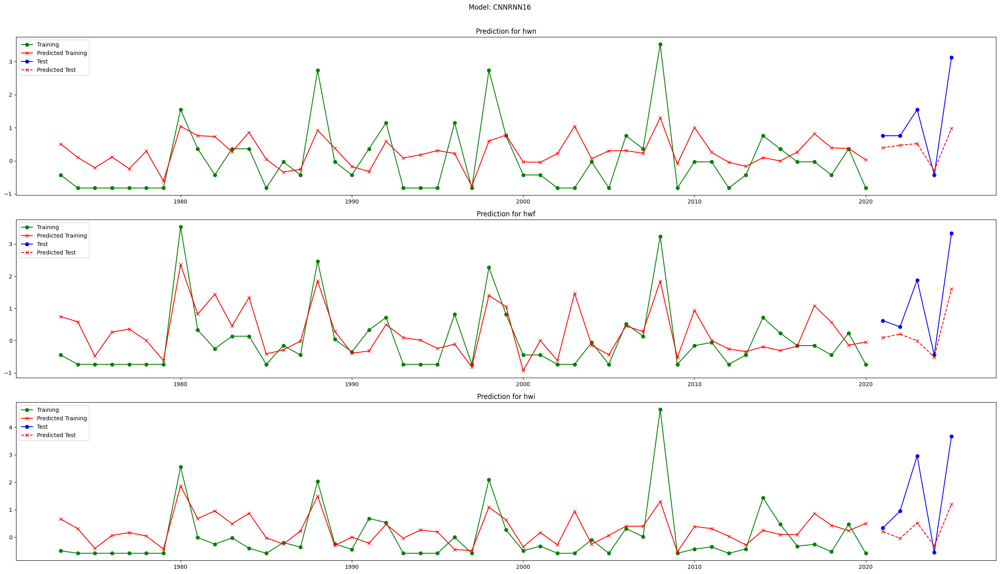

1/1 [==============================] - 0s 21ms/step


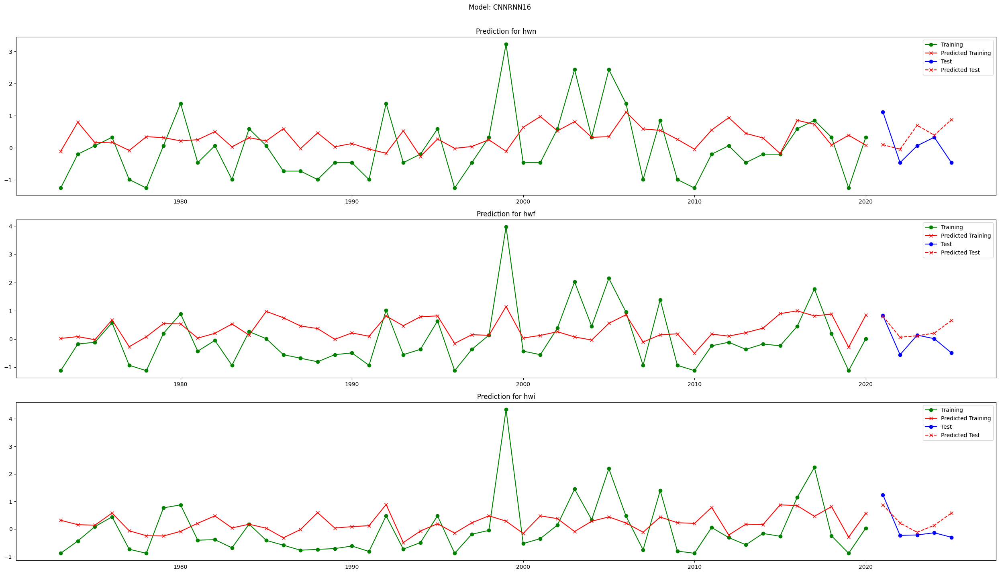

1/1 [==============================] - 0s 23ms/step


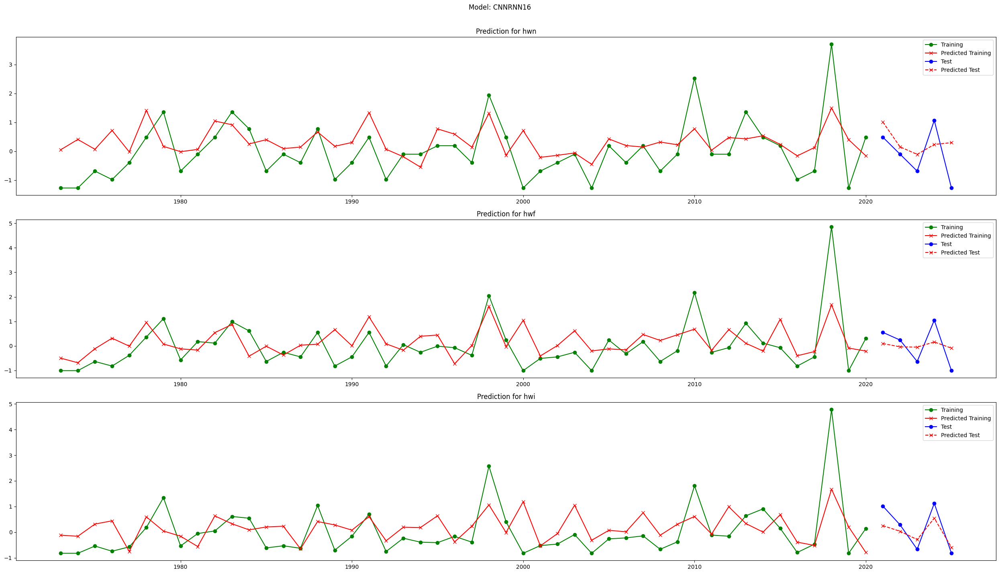

1/1 [==============================] - 0s 21ms/step


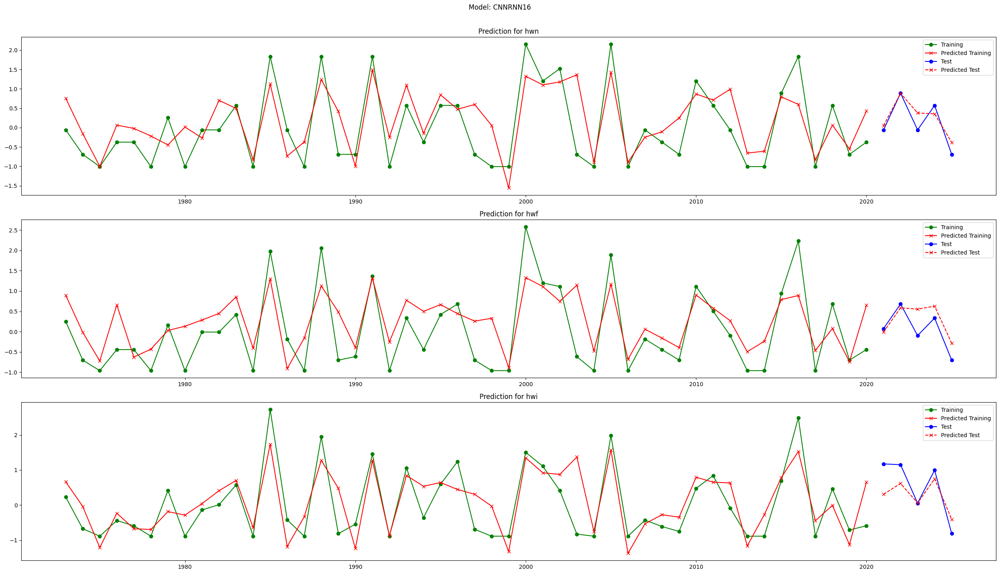

1/1 [==============================] - 0s 22ms/step


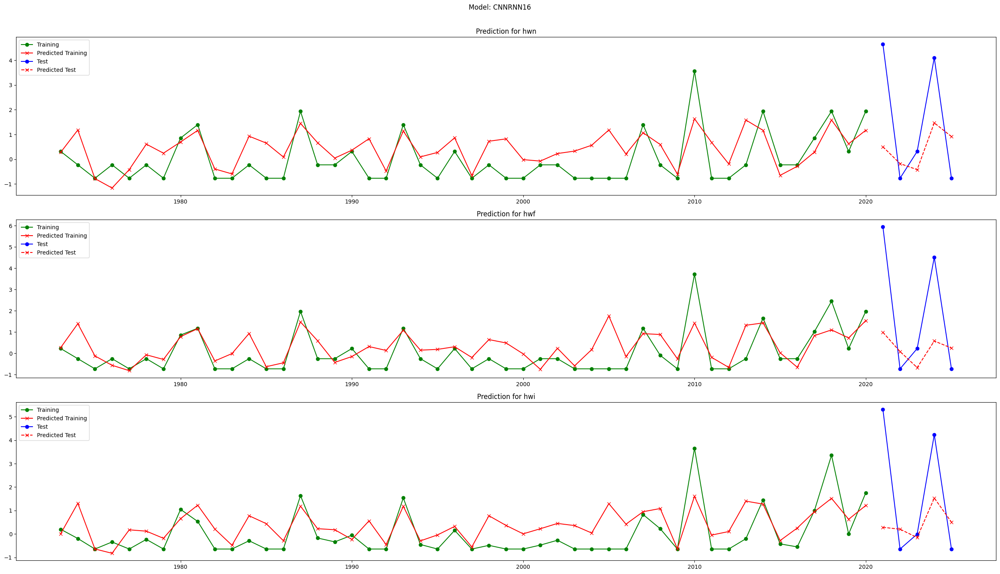

1/1 [==============================] - 0s 18ms/step


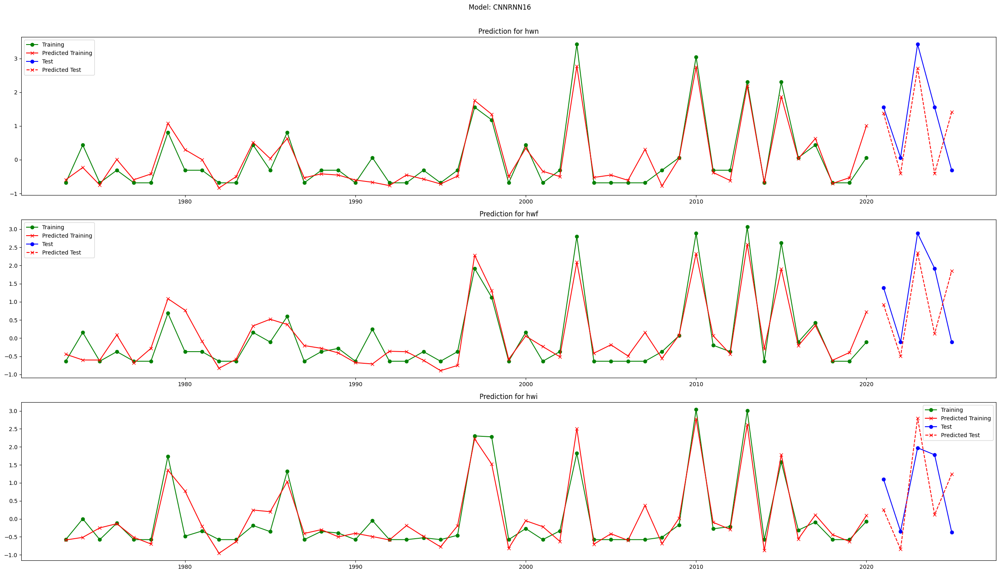

2/2 [==============================] - 0s 2ms/step


c:\Users\marti\AppData\Local\Programs\Python\Python310\lib\site-packages\pandas\core\dtypes\common.py:1687: DeprecationWarning: Converting `np.inexact` or `np.floating` to a dtype is deprecated. The current result is `float64` which is not strictly correct.
  npdtype = np.dtype(dtype)
c:\Users\marti\AppData\Local\Programs\Python\Python310\lib\site-packages\pandas\core\dtypes\common.py:1687: DeprecationWarning: Converting `np.inexact` or `np.floating` to a dtype is deprecated. The current result is `float64` which is not strictly correct.
  npdtype = np.dtype(dtype)


In [71]:
loss_fn = SERA(bounds=bounds_avg,T=100, initial_weight=0.1, fn="piecewise2")
df_pred_train = pd.DataFrame(columns=indices_of_interest, index=era5_df.index)
df_pred_test = pd.DataFrame(columns=indices_of_interest, index=era5_df.index)
models_scenario_predicted = {model: {} for model in cmip6_drivers_dfs.keys()}


for season in range (1,13):

    df_season = era5_df[era5_df.index.month==season]
    model = Sequential([
        Conv1D(16, kernel_size=1, activation="relu", input_shape=(1, len(era5_df.columns) - len(indices_of_interest))),
        Reshape((1, 16)),  # Back to time dimension
        SimpleRNN(8, activation="tanh"),
        Dropout(0.1),
        Dense(len(indices_of_interest))
    ])

    pred = PredictionModel(df_season, season, indices_of_interest, model, name_regressor="CNNRNN16",loss_fn=loss_fn)
    pred.compile_keras_model()

    y_train, y_pred_train = pred.train(len_pred)
    y_test, y_pred = pred.predict(len_pred)
    dates = pd.date_range(pd.to_datetime(f"1972-{season}"),periods=len(y_train) + len(y_test),freq=pd.offsets.YearBegin(1))
    pred.plot_predictions(dates, len_pred, y_train, y_pred_train, y_test, y_pred)
    df_pred_train.loc[df_season.index[:-len_pred]] = pred.label_scaler.inverse_transform(y_pred_train)
    df_pred_train.sort_index(inplace=True)
    df_pred_test.loc[df_season.index[-len_pred:]] = pred.label_scaler.inverse_transform(y_pred)
    df_pred_test.sort_index(inplace=True)
    for name, scenarios_df in cmip6_drivers_dfs.items():
        scenario = "historical"
        if season==1:
            models_scenario_predicted[name][scenario] = pd.DataFrame()
        df_target = scenarios_df[scenario][scenarios_df[scenario].index.month==season]
        df_target = df_target[(df_target.index.year >=1970) & (df_target.index.year <= 2014)]
        
        # Normalize cmip6 features for machine input
        target = pred.scaler_X.transform(df_target[pred.scaler_X.feature_names_in_])
        # Reshape for keras and predict
        predicted_normalized = pred.regressor.predict(pred.reshape_for_keras(target))
        # Transform back to original range
        predicted_real = pred.label_scaler.inverse_transform(predicted_normalized)
        predicted = pd.DataFrame(predicted_real).rename(columns={i: label for i,label in enumerate(indices_of_interest)})
        predicted["Date"] = df_target.index
        predicted.set_index("Date",inplace=True)
        models_scenario_predicted[name][scenario] = pd.concat((models_scenario_predicted[name][scenario],predicted),axis=0)
        
df_pred_train = df_pred_train.dropna()
df_pred_train = df_pred_train.astype(np.number)

df_pred_test = df_pred_test.dropna()
df_pred_test = df_pred_test.astype(np.number)


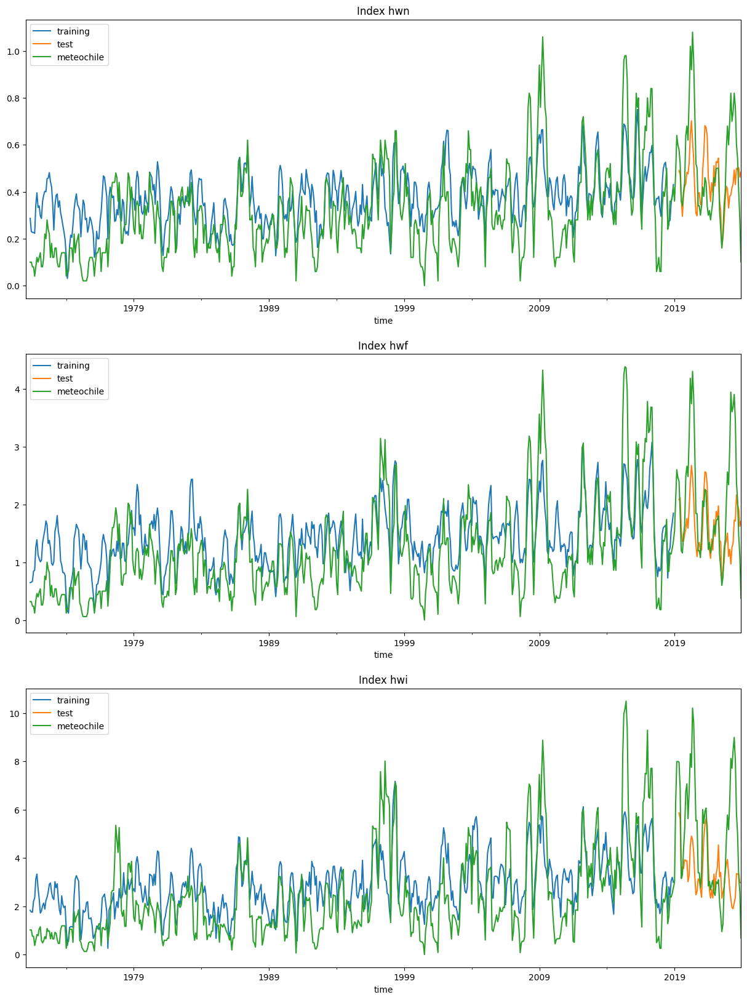

In [72]:
fig, axs = plt.subplots(len(indices_of_interest), figsize=(15, 20))
for i, index in enumerate(indices_of_interest):
    df_pred_train.rolling(5).mean().plot(y=index, ax=axs[i], label="training")
    df_pred_test.rolling(5).mean().plot(y=index, ax=axs[i], label="test")
    hws.rolling(5).mean().plot(y=index, ax=axs[i], label="meteochile")
    axs[i].set_title(f"Index {index}")

In [73]:
mean_scenario = {}
mean_std_scenario = {}
scenario = "historical"

temp_df = pd.DataFrame()
for name, model_scenario in models_scenario_predicted.items():
    temp_df = pd.concat((temp_df, model_scenario[scenario]), axis=1)
    
mean_scenario[scenario] = pd.DataFrame(columns=models_scenario_predicted["EC-Earth3"][scenario].columns,index=model_scenario[scenario].index)
mean_std_scenario[scenario] = pd.DataFrame(columns=models_scenario_predicted["EC-Earth3"][scenario].columns,index=model_scenario[scenario].index)

for col in np.unique(temp_df.columns):
    mean_scenario[scenario][col] = temp_df[col].mean(axis=1)
    mean_std_scenario[scenario][col] = temp_df[col].std(axis=1)
models_scenario_predicted["mean_monthly"] = mean_scenario

models_scenario_predicted["mean_monthly"][scenario] = models_scenario_predicted["mean_monthly"][scenario].astype(np.float64)

models_predicted_yearly = {model: {} for model in models_scenario_predicted.keys()}
models_predicted_decadal = {model: {} for model in models_scenario_predicted.keys()}

for name, model_scenario in models_scenario_predicted.items():
    df = model_scenario[scenario]
    models_predicted_yearly[name][scenario] = transform_time_label(df, "year")
    models_predicted_decadal[name][scenario] = transform_time_label(df, "decade")

pred_train_yearly = transform_time_label(df_pred_train, "year")

mean_yearly_scenario = {}
min_yearly_scenario = {}
max_yearly_scenario = {}
mean_yearly_std_scenario = {}

features = models_predicted_yearly["EC-Earth3"][scenario].columns


temp_df = pd.DataFrame()
for name, model_scenario in models_predicted_yearly.items():
    if "mean" not in name:
        temp_df = pd.concat((temp_df, model_scenario[scenario]), axis=1)

yearly_dates = model_scenario[scenario].index
mean_yearly_scenario[scenario] = pd.DataFrame(columns=features,index=yearly_dates)
min_yearly_scenario[scenario] = pd.DataFrame(columns=features,index=yearly_dates)
max_yearly_scenario[scenario] = pd.DataFrame(columns=features,index=yearly_dates)
mean_yearly_std_scenario[scenario] = pd.DataFrame(columns=features,index=yearly_dates)
for col in np.unique(temp_df.columns):
    mean_yearly_scenario[scenario][col] = temp_df[col].mean(axis=1)
    min_yearly_scenario[scenario][col] = temp_df[col].min(axis=1)
    max_yearly_scenario[scenario][col] = temp_df[col].max(axis=1)
    mean_yearly_std_scenario[scenario][col] = temp_df[col].std(axis=1)

models_predicted_yearly["yearly_then_mean"] = mean_yearly_scenario
models_predicted_yearly["yearly_then_min"] = min_yearly_scenario
models_predicted_yearly["yearly_then_max"] = max_yearly_scenario

In [74]:
meteochile_yearly = transform_time_label(hws, "year")[indices_of_interest]

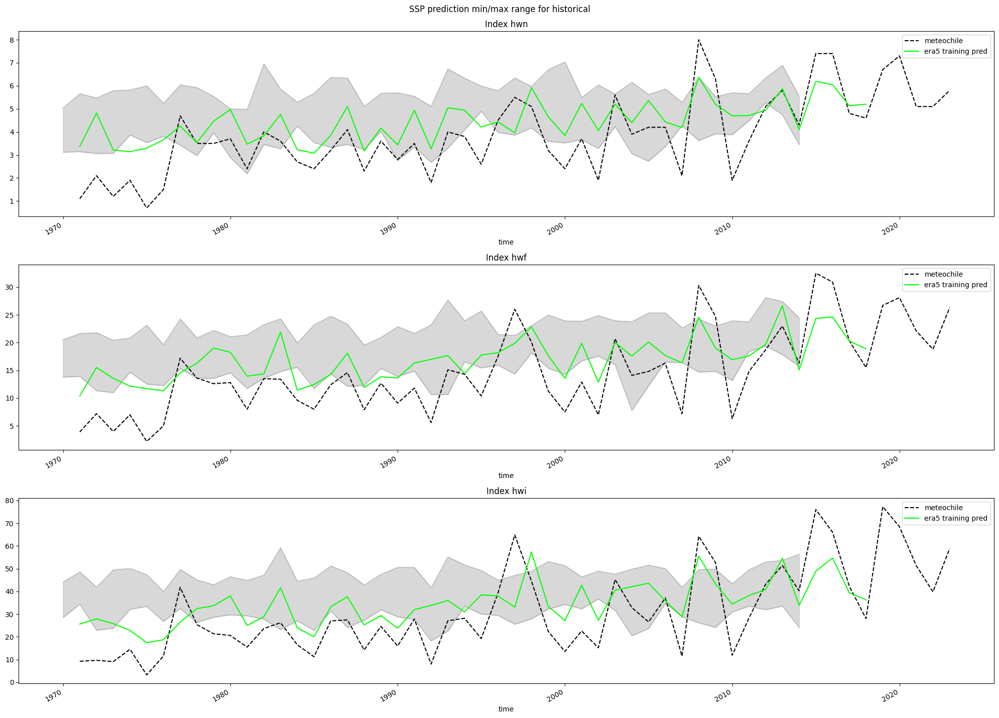

In [75]:
scenarios_prediction_min = models_predicted_yearly["yearly_then_min"]
scenarios_prediction_max = models_predicted_yearly["yearly_then_max"]
colors = {
    "historical": "gray",
    "ssp126": "blue",
    "ssp585": "red"
}
fig, axs = plt.subplots(len(indices_of_interest), figsize=(20, 15))
for i, index in enumerate(indices_of_interest):
    for scenario in ("historical",):
        color=colors[scenario]
        df_min = scenarios_prediction_min[scenario]
        df_max = scenarios_prediction_max[scenario]
        axs[i].plot(
            df_min.index, df_min[index].values, color="black",alpha=0.1, label=f"{scenario}"
        )
        axs[i].plot(
            df_min.index, df_max[index].values, color="black",alpha=0.1, label=f"{scenario}"
        )
        axs[i].fill_between(
            df_min.index, df_min[index].values, df_max[index].values, alpha=0.3, color=color, label=f"{scenario}"
        )
    meteochile_yearly.plot(y=index, linestyle="--", label="meteochile", ax=axs[i], c="black")
    pred_train_yearly.plot(y=index, label="era5 training pred", ax=axs[i], c="lime")
    axs[i].set_title(f"Index {index}")
fig.tight_layout(rect=[0, 0.03, 1, 0.97]) 
fig.suptitle(f"SSP prediction min/max range for historical")
plt.show()

## Distribution 2: hwm, hwa, hwmeani, 1971-2018 training, avg bounds

In [76]:
len_pred = 5

['hwm', 'hwa', 'hwmeani']
Default bounds [-1.16928928 -0.30647585  3.          6.49996949]
Index hwm paper bounds: (-5.046231952784555, 0.03713432255517214, 2.660019929098329, 3.9056889564199695)
Index hwa paper bounds: (-4.2321118218383535, -0.0338456512292951, 3.079599837058667, 3.175179624999176)
Index hwmeani paper bounds: (-4.171472180739929, -0.026514211298934984, 2.960513875113209, 4.346727893370682)
Result bounds [-5.046231952784555, -0.007741846657685981, 2.9000445470900686, 4.346727893370682]


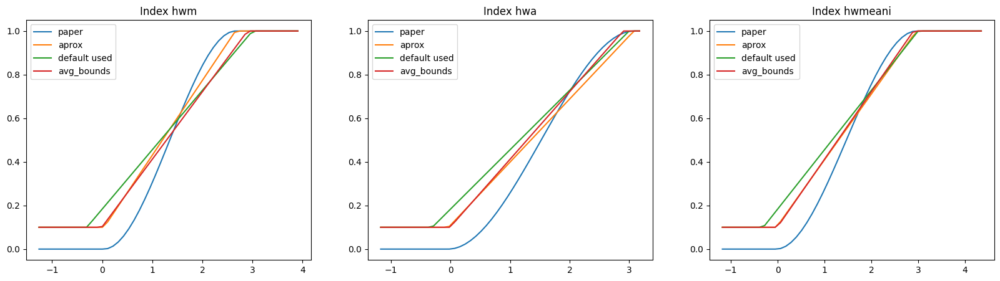

In [77]:
indices_of_interest = ["hwm", "hwa", "hwmeani"]
print(indices_of_interest)
bounds = np.array((-1.1692892810242344, -0.30647585455315646, 3.0, 6.499969486244418))
print("Default bounds", bounds)

bounds_paper_list = []

fig, axs = plt.subplots(1, len(indices_of_interest), figsize=(20,5))
for i, index in enumerate(indices_of_interest):
    hws_index = hws_scaled[[index]].to_numpy()
    hws_index = hws_index.reshape(hws_index.shape[0])
    relevance = create_relevance_function(hws_index)
    l, m ,u  = compute_adjusted_boxplot_bounds(hws_index)
    bounds_paper = (l, m, u, max(hws_index))
    bounds_paper_list.append(bounds_paper)

    print(f"Index {index} paper bounds:", bounds_paper)
    f2 = piecewise_linear_phi_2(bounds_paper)
    f0 = piecewise_linear_phi_2(bounds)
    x = np.linspace(np.min(hws_index), np.max(hws_index))
    axs[i].plot(x, relevance(x), label="paper")
    axs[i].plot(x, f2(x), label="aprox")
    axs[i].plot(x, f0(x), label="default used")
    axs[i].set_title(f"Index {index}")

bounds_avg = average_bounds(bounds_paper_list)

for i, index in enumerate(indices_of_interest):
    hws_index = hws_scaled[[index]].to_numpy()
    hws_index = hws_index.reshape(hws_index.shape[0])
    x = np.linspace(np.min(hws_index), np.max(hws_index))
    axs[i].plot(x, piecewise_linear_phi_2(bounds_avg)(x), label="avg_bounds")
    axs[i].legend()
plt.show()

In [78]:
hws_labels = hws[indices_of_interest]
era5_df = pd.concat((historical_dfs["ERA5"],hws_labels),axis=1)

1/1 [==============================] - 0s 22ms/step


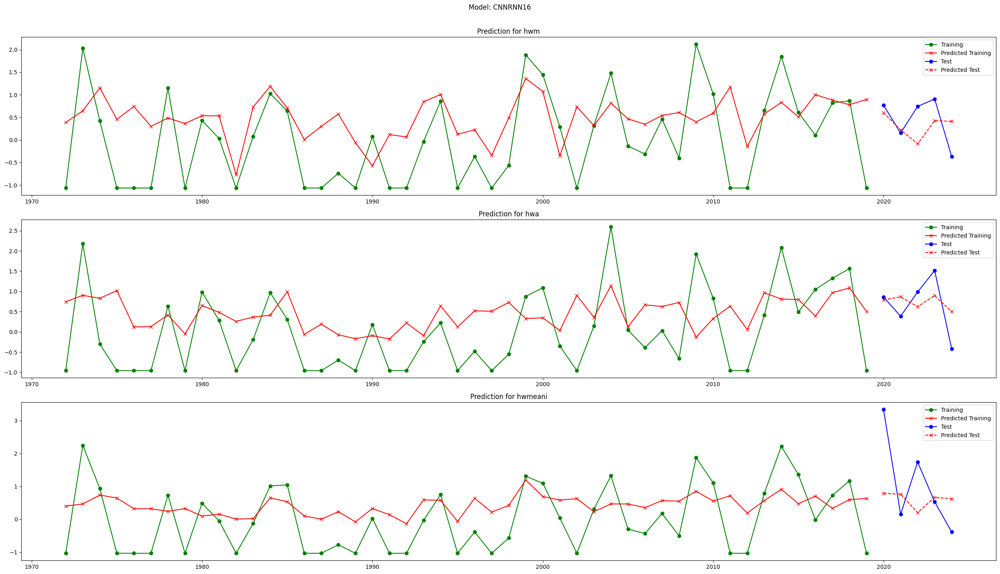

1/1 [==============================] - 0s 27ms/step


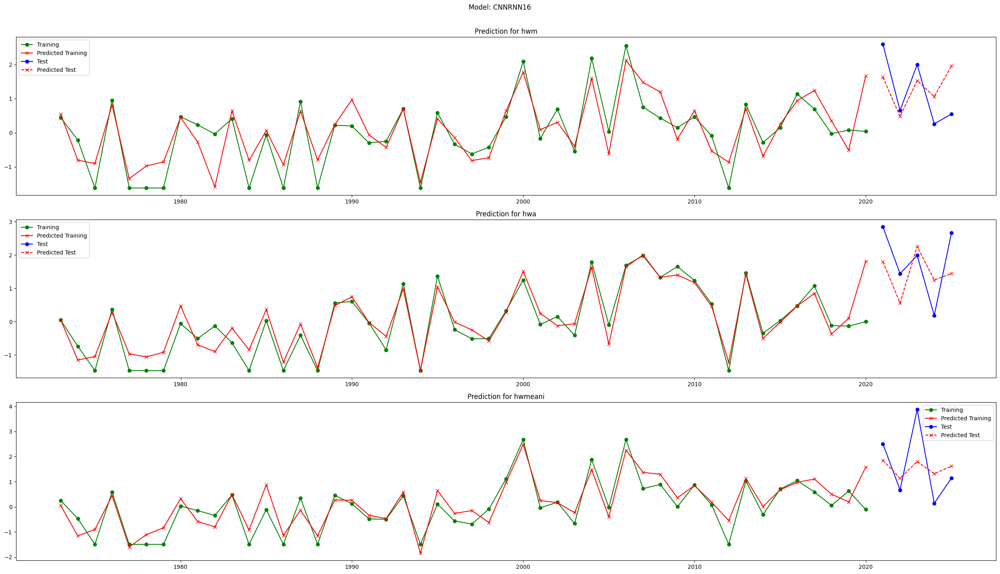

1/1 [==============================] - 0s 24ms/step


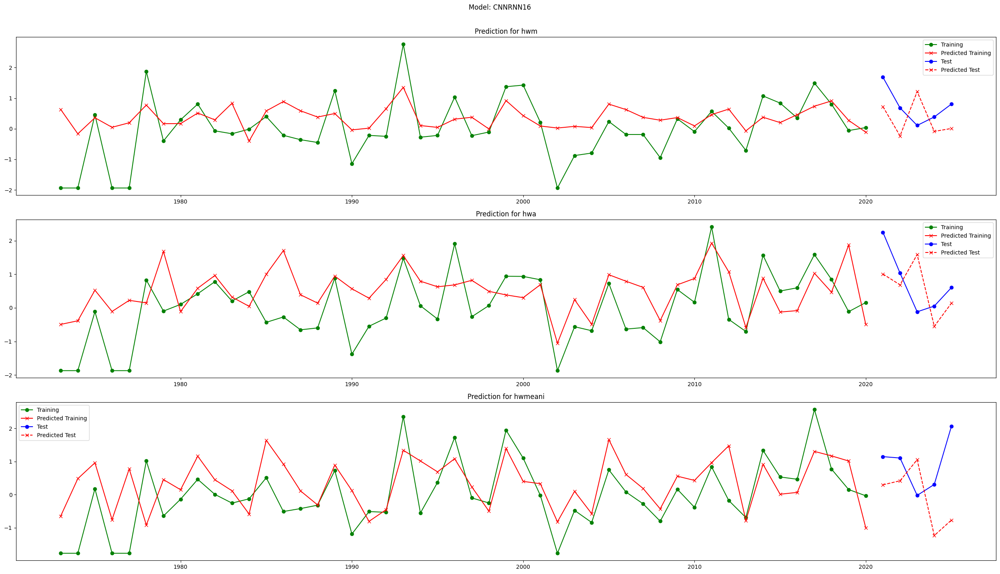

1/1 [==============================] - 0s 21ms/step


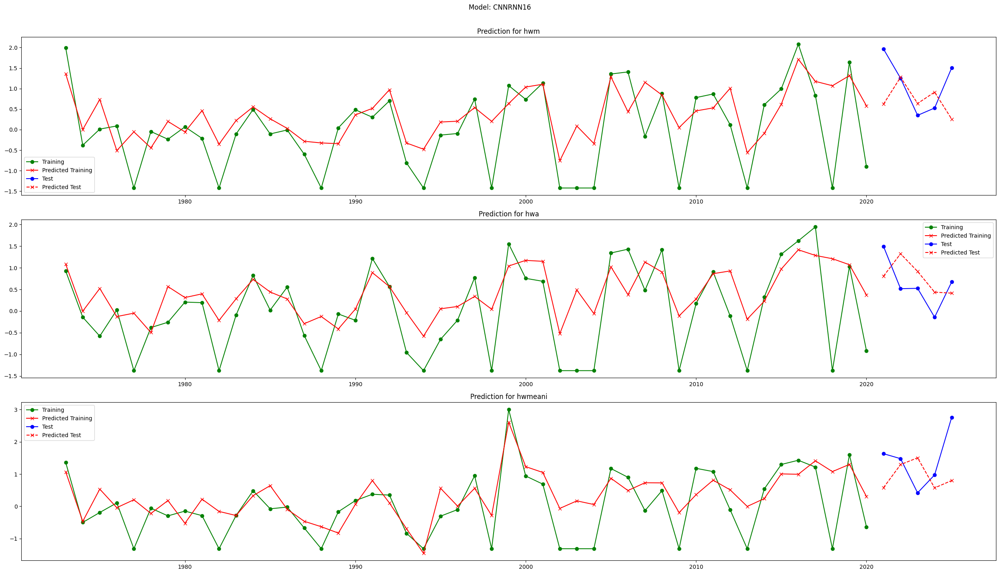

1/1 [==============================] - 0s 22ms/step


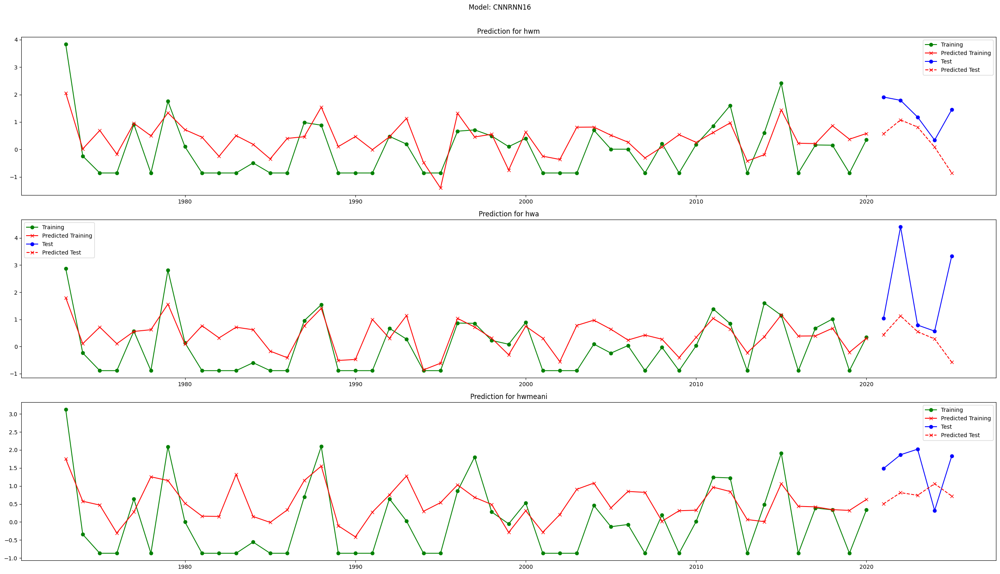

1/1 [==============================] - 0s 23ms/step


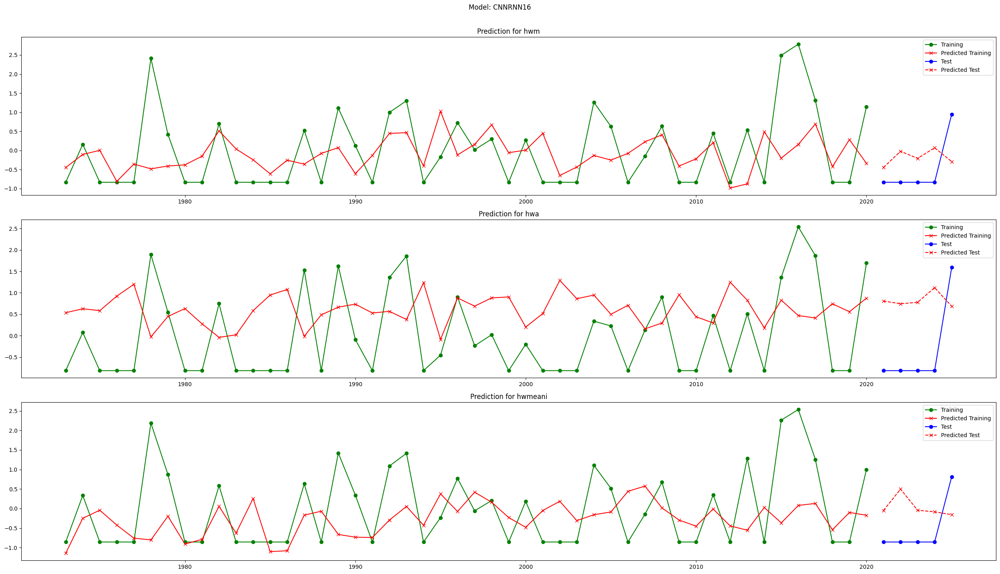

1/1 [==============================] - 0s 23ms/step


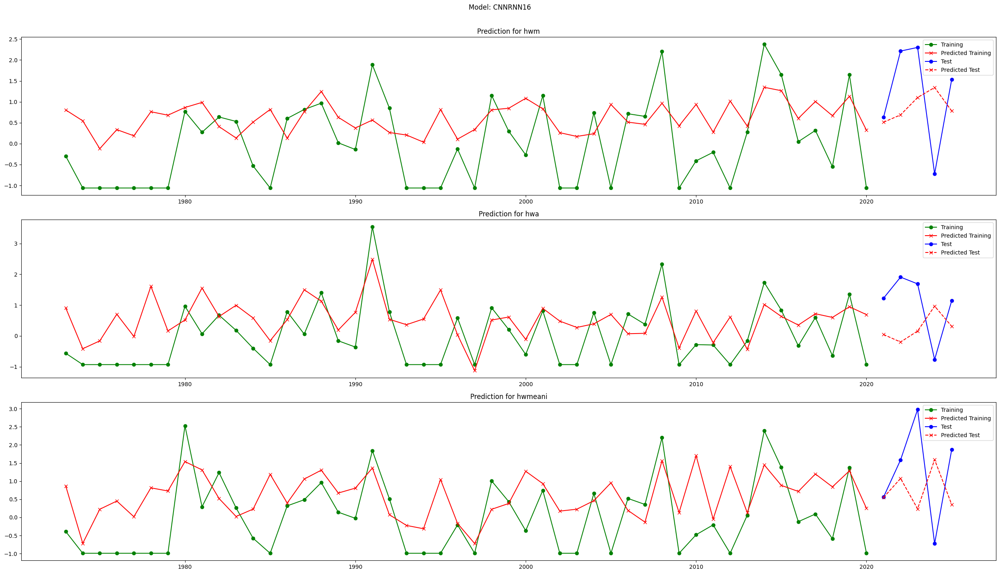

1/1 [==============================] - 0s 18ms/step


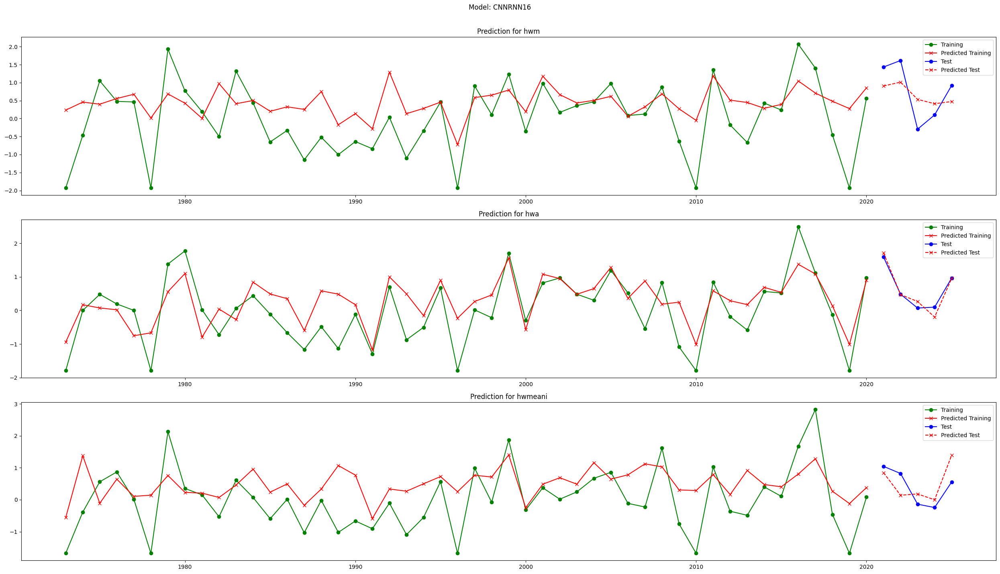

1/1 [==============================] - 0s 22ms/step


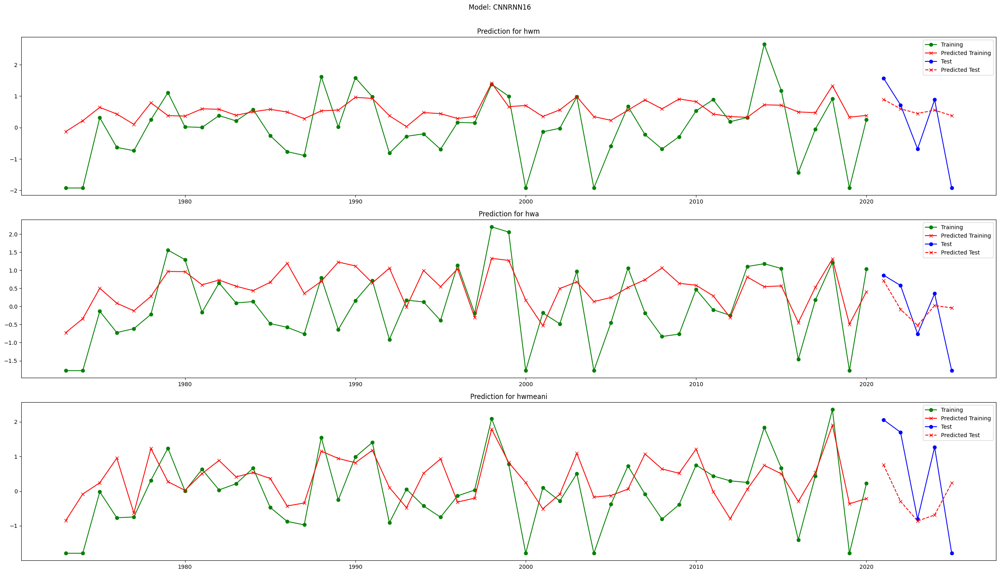

1/1 [==============================] - 0s 20ms/step


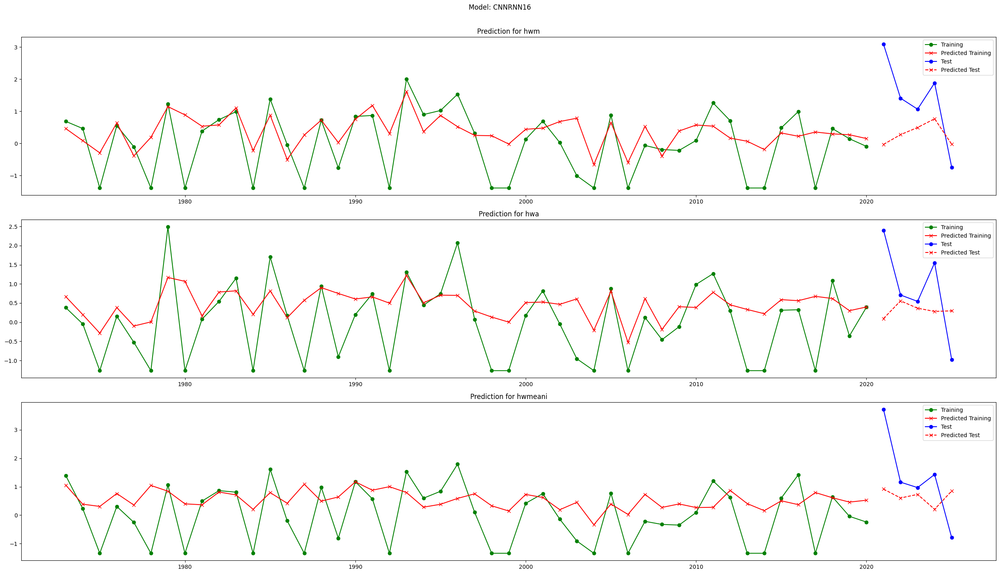

1/1 [==============================] - 0s 19ms/step


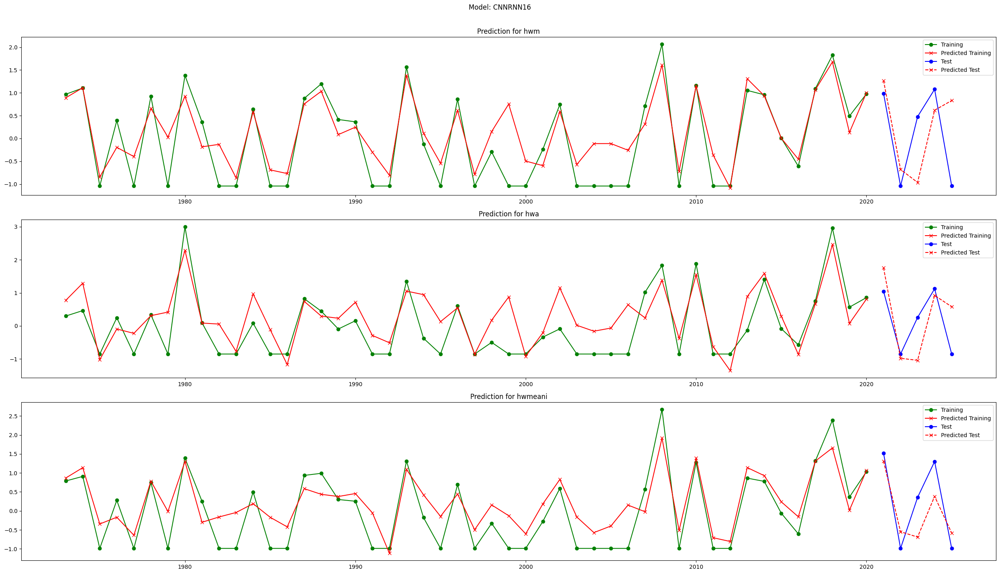

1/1 [==============================] - 0s 21ms/step


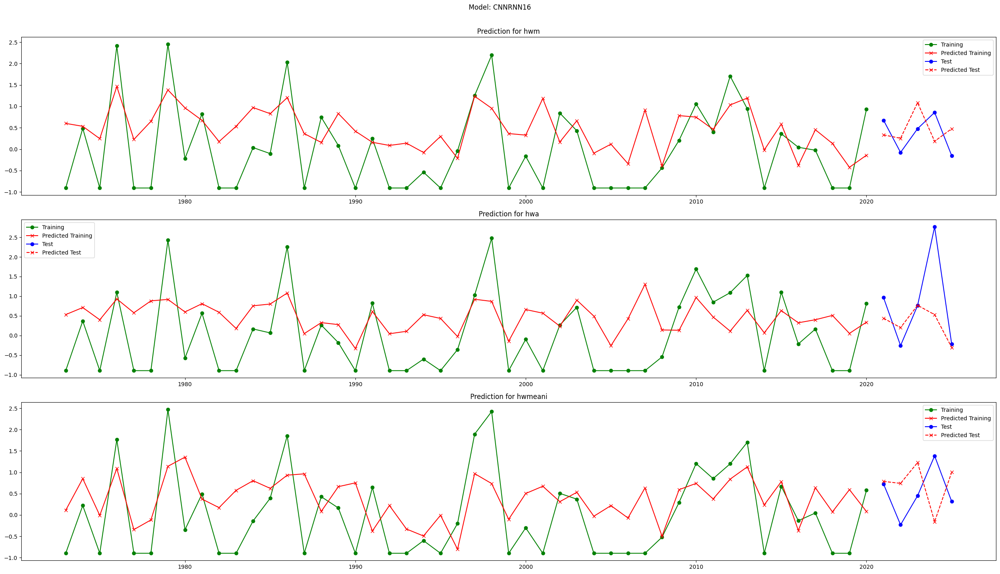

2/2 [==============================] - 0s 2ms/step


c:\Users\marti\AppData\Local\Programs\Python\Python310\lib\site-packages\pandas\core\dtypes\common.py:1687: DeprecationWarning: Converting `np.inexact` or `np.floating` to a dtype is deprecated. The current result is `float64` which is not strictly correct.
  npdtype = np.dtype(dtype)
c:\Users\marti\AppData\Local\Programs\Python\Python310\lib\site-packages\pandas\core\dtypes\common.py:1687: DeprecationWarning: Converting `np.inexact` or `np.floating` to a dtype is deprecated. The current result is `float64` which is not strictly correct.
  npdtype = np.dtype(dtype)


In [79]:
loss_fn = SERA(bounds=bounds_avg,T=100, initial_weight=0.1, fn="piecewise2")
df_pred_train = pd.DataFrame(columns=indices_of_interest, index=era5_df.index)
df_pred_test = pd.DataFrame(columns=indices_of_interest, index=era5_df.index)
models_scenario_predicted = {model: {} for model in cmip6_drivers_dfs.keys()}


for season in range (1,13):

    df_season = era5_df[era5_df.index.month==season]
    model = Sequential([
        Conv1D(16, kernel_size=1, activation="relu", input_shape=(1, len(era5_df.columns) - len(indices_of_interest))),
        Reshape((1, 16)),  # Back to time dimension
        SimpleRNN(8, activation="tanh"),
        Dropout(0.1),
        Dense(len(indices_of_interest))
    ])

    pred = PredictionModel(df_season, season, indices_of_interest, model, name_regressor="CNNRNN16",loss_fn=loss_fn)
    pred.compile_keras_model()

    y_train, y_pred_train = pred.train(len_pred)
    y_test, y_pred = pred.predict(len_pred)
    dates = pd.date_range(pd.to_datetime(f"1972-{season}"),periods=len(y_train) + len(y_test),freq=pd.offsets.YearBegin(1))
    pred.plot_predictions(dates, len_pred, y_train, y_pred_train, y_test, y_pred)
    df_pred_train.loc[df_season.index[:-len_pred]] = pred.label_scaler.inverse_transform(y_pred_train)
    df_pred_train.sort_index(inplace=True)
    df_pred_test.loc[df_season.index[-len_pred:]] = pred.label_scaler.inverse_transform(y_pred)
    df_pred_test.sort_index(inplace=True)
    for name, scenarios_df in cmip6_drivers_dfs.items():
        scenario = "historical"
        if season==1:
            models_scenario_predicted[name][scenario] = pd.DataFrame()
        df_target = scenarios_df[scenario][scenarios_df[scenario].index.month==season]
        df_target = df_target[(df_target.index.year >=1970) & (df_target.index.year <= 2014)]
        
        # Normalize cmip6 features for machine input
        target = pred.scaler_X.transform(df_target[pred.scaler_X.feature_names_in_])
        # Reshape for keras and predict
        predicted_normalized = pred.regressor.predict(pred.reshape_for_keras(target))
        # Transform back to original range
        predicted_real = pred.label_scaler.inverse_transform(predicted_normalized)
        predicted = pd.DataFrame(predicted_real).rename(columns={i: label for i,label in enumerate(indices_of_interest)})
        predicted["Date"] = df_target.index
        predicted.set_index("Date",inplace=True)
        models_scenario_predicted[name][scenario] = pd.concat((models_scenario_predicted[name][scenario],predicted),axis=0)
        
df_pred_train = df_pred_train.dropna()
df_pred_train = df_pred_train.astype(np.number)

df_pred_test = df_pred_test.dropna()
df_pred_test = df_pred_test.astype(np.number)


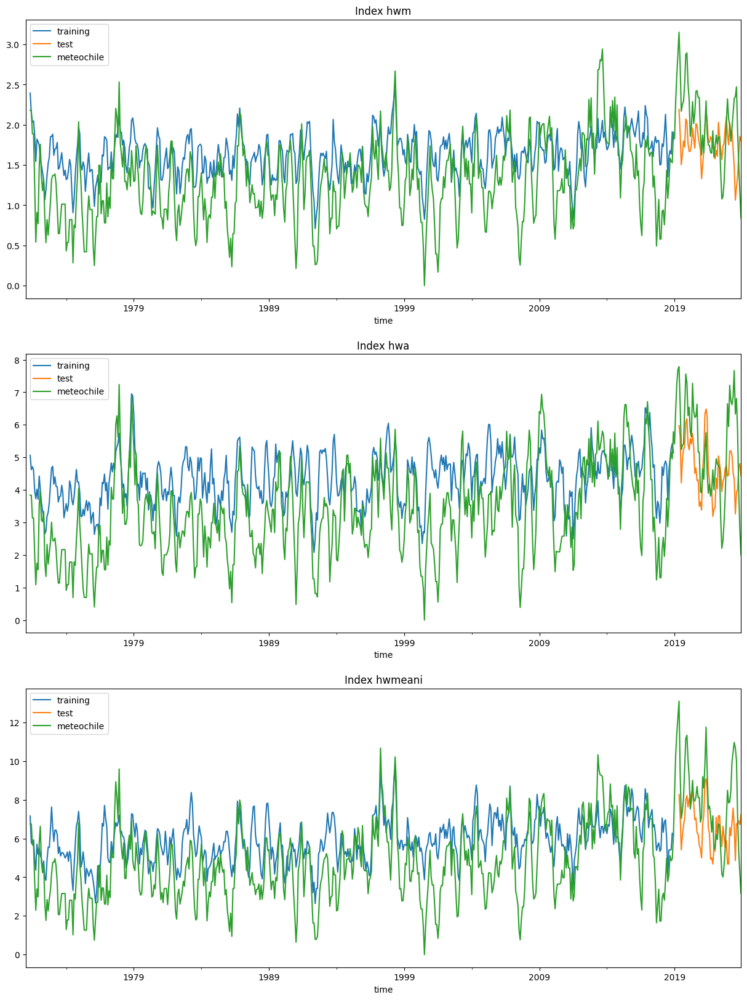

In [80]:
fig, axs = plt.subplots(len(indices_of_interest), figsize=(15, 20))
for i, index in enumerate(indices_of_interest):
    df_pred_train.rolling(5).mean().plot(y=index, ax=axs[i], label="training")
    df_pred_test.rolling(5).mean().plot(y=index, ax=axs[i], label="test")
    hws.rolling(5).mean().plot(y=index, ax=axs[i], label="meteochile")
    axs[i].set_title(f"Index {index}")

## Distribution 3: hwd, hwa, hwmaxi, 1971-2018 training, avg bounds

In [83]:
len_pred = 5

['hwd', 'hwa', 'hwmaxi']
Default bounds [-1.16928928 -0.30647585  3.          6.49996949]
Index hwd paper bounds: (-4.18818950996255, -0.1093314747387045, 3.581063890463821, 4.552220565517117)
Index hwa paper bounds: (-4.2321118218383535, -0.0338456512292951, 3.079599837058667, 3.175179624999176)
Index hwmaxi paper bounds: (-2.3777132247648884, -0.17489414543418885, 4.12929129853895, 5.0064992591277155)
Result bounds [-4.2321118218383535, -0.10602375713406281, 3.596651675353813, 5.0064992591277155]


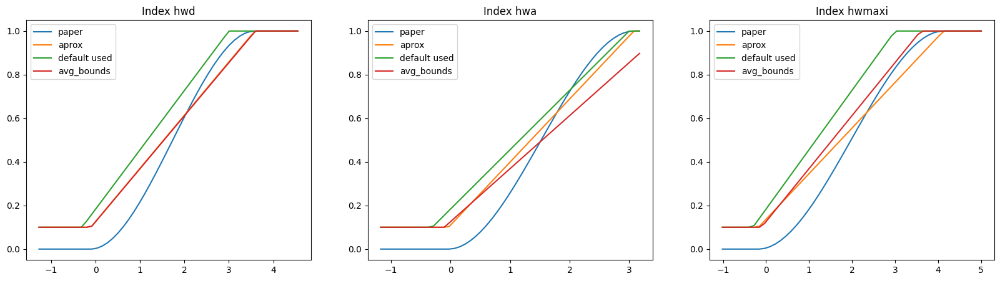

In [84]:
indices_of_interest = ["hwd", "hwa", "hwmaxi"]
print(indices_of_interest)
bounds = np.array((-1.1692892810242344, -0.30647585455315646, 3.0, 6.499969486244418))
print("Default bounds", bounds)

bounds_paper_list = []

fig, axs = plt.subplots(1, len(indices_of_interest), figsize=(20,5))
for i, index in enumerate(indices_of_interest):
    hws_index = hws_scaled[[index]].to_numpy()
    hws_index = hws_index.reshape(hws_index.shape[0])
    relevance = create_relevance_function(hws_index)
    l, m ,u  = compute_adjusted_boxplot_bounds(hws_index)
    bounds_paper = (l, m, u, max(hws_index))
    bounds_paper_list.append(bounds_paper)

    print(f"Index {index} paper bounds:", bounds_paper)
    f2 = piecewise_linear_phi_2(bounds_paper)
    f0 = piecewise_linear_phi_2(bounds)
    x = np.linspace(np.min(hws_index), np.max(hws_index))
    axs[i].plot(x, relevance(x), label="paper")
    axs[i].plot(x, f2(x), label="aprox")
    axs[i].plot(x, f0(x), label="default used")
    axs[i].set_title(f"Index {index}")

bounds_avg = average_bounds(bounds_paper_list)

for i, index in enumerate(indices_of_interest):
    hws_index = hws_scaled[[index]].to_numpy()
    hws_index = hws_index.reshape(hws_index.shape[0])
    x = np.linspace(np.min(hws_index), np.max(hws_index))
    axs[i].plot(x, piecewise_linear_phi_2(bounds_avg)(x), label="avg_bounds")
    axs[i].legend()
plt.show()

In [85]:
hws_labels = hws[indices_of_interest]
era5_df = pd.concat((historical_dfs["ERA5"],hws_labels),axis=1)

1/1 [==============================] - 0s 22ms/step


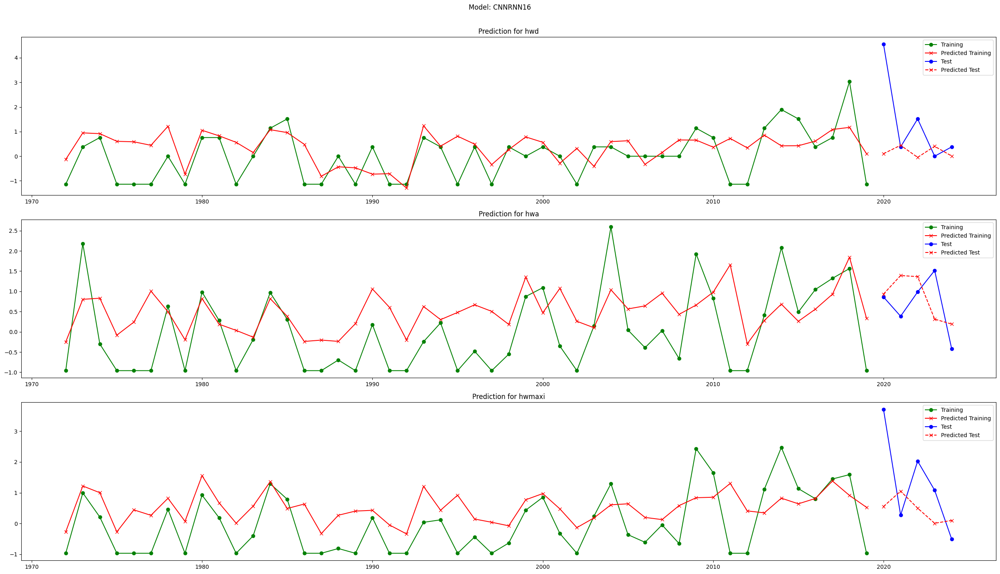

1/1 [==============================] - 0s 21ms/step


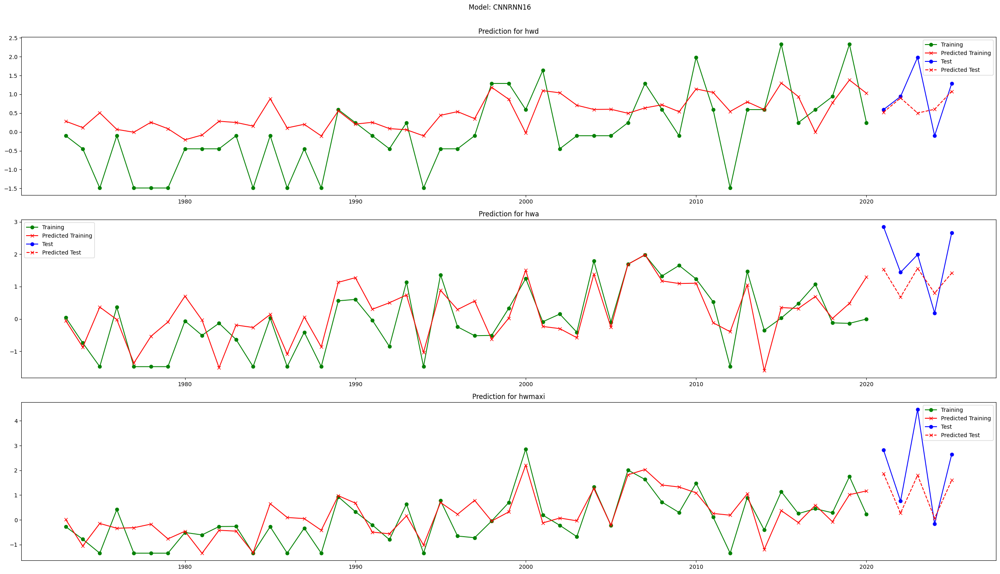

1/1 [==============================] - 0s 22ms/step


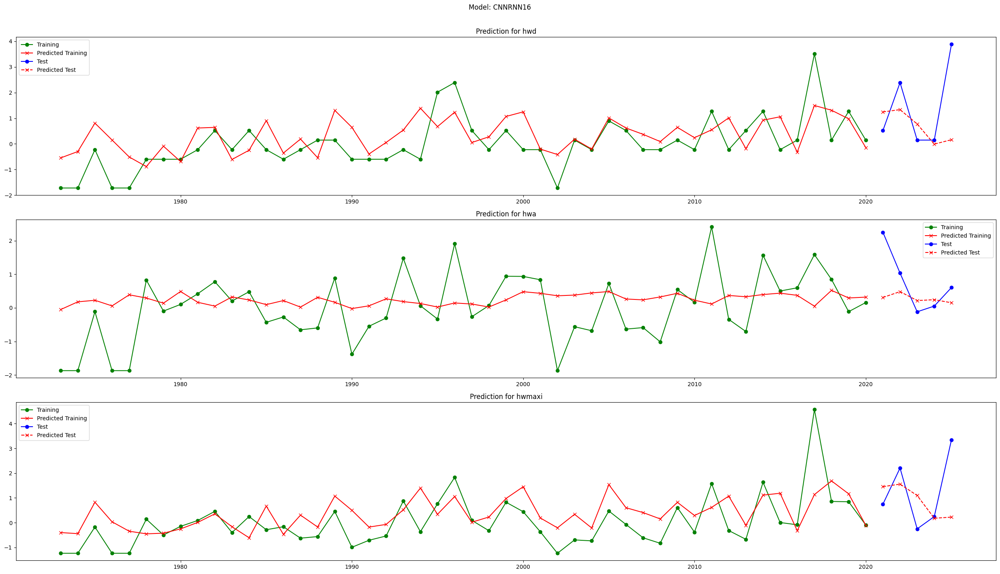

1/1 [==============================] - 0s 21ms/step


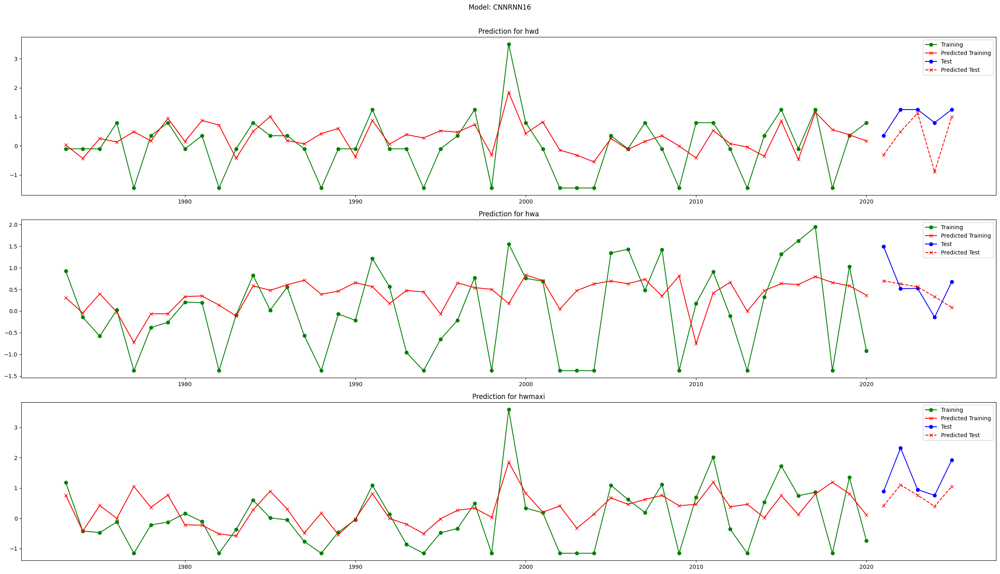

1/1 [==============================] - 0s 20ms/step


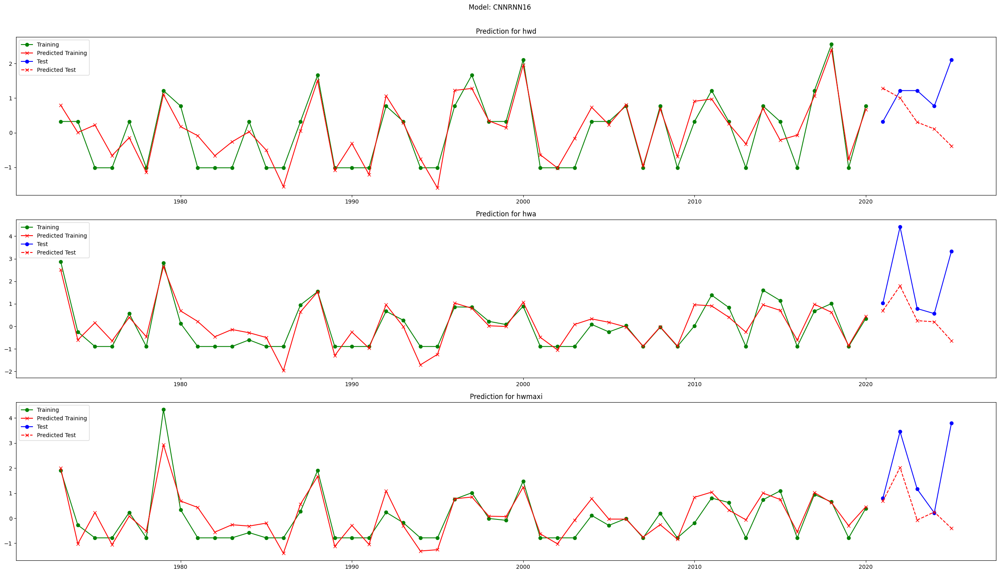

1/1 [==============================] - 0s 21ms/step


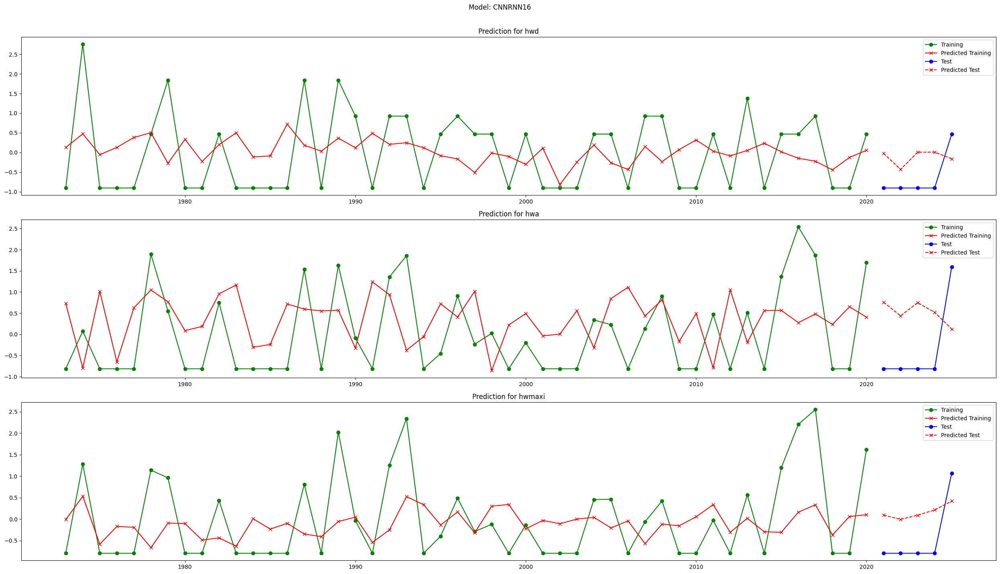

1/1 [==============================] - 0s 22ms/step


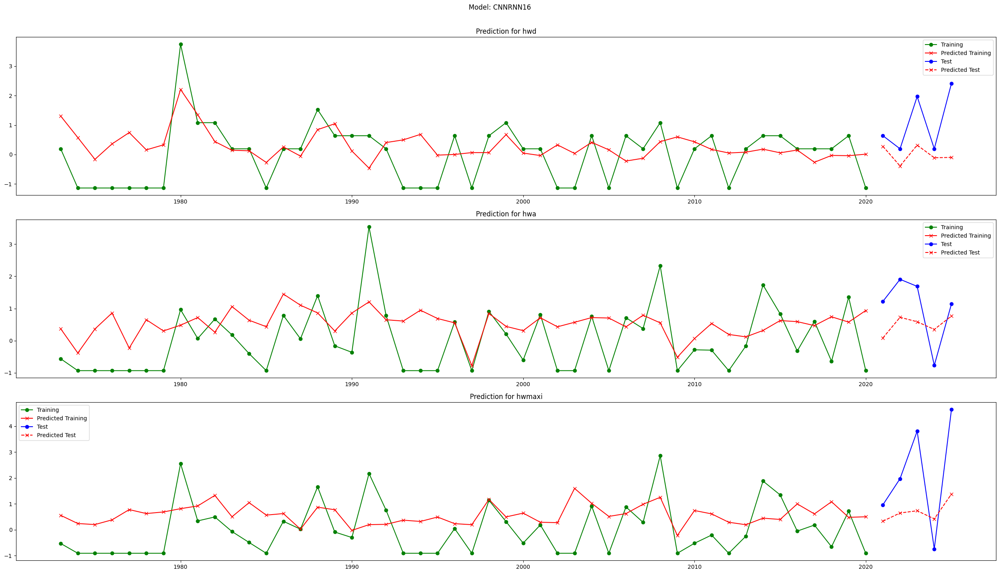

1/1 [==============================] - 0s 21ms/step


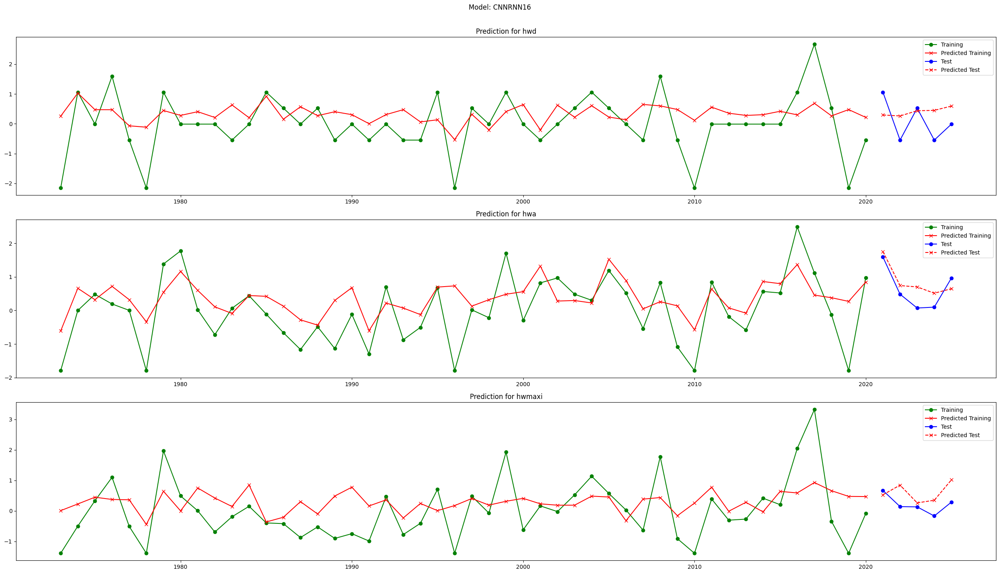

1/1 [==============================] - 0s 22ms/step


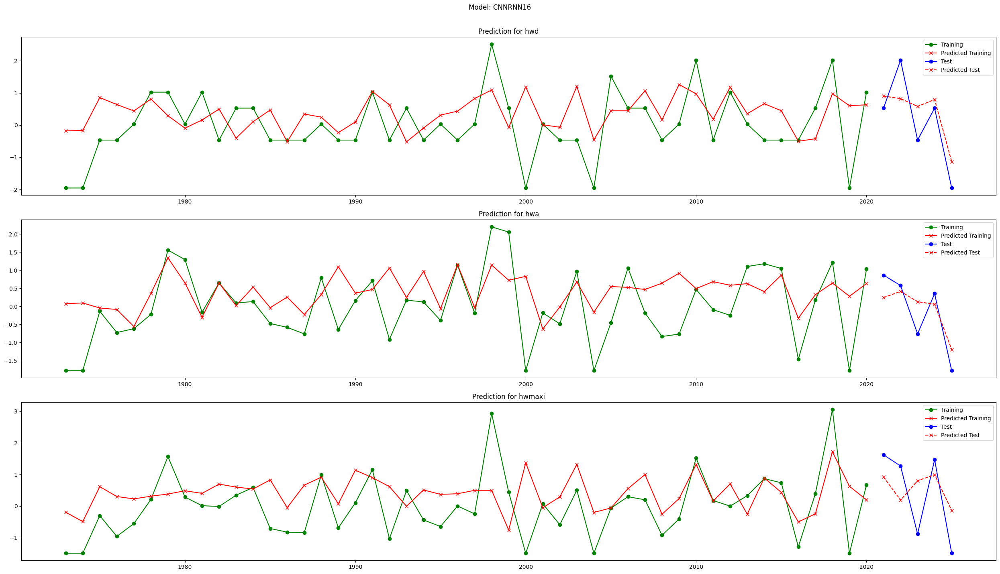

1/1 [==============================] - 0s 20ms/step


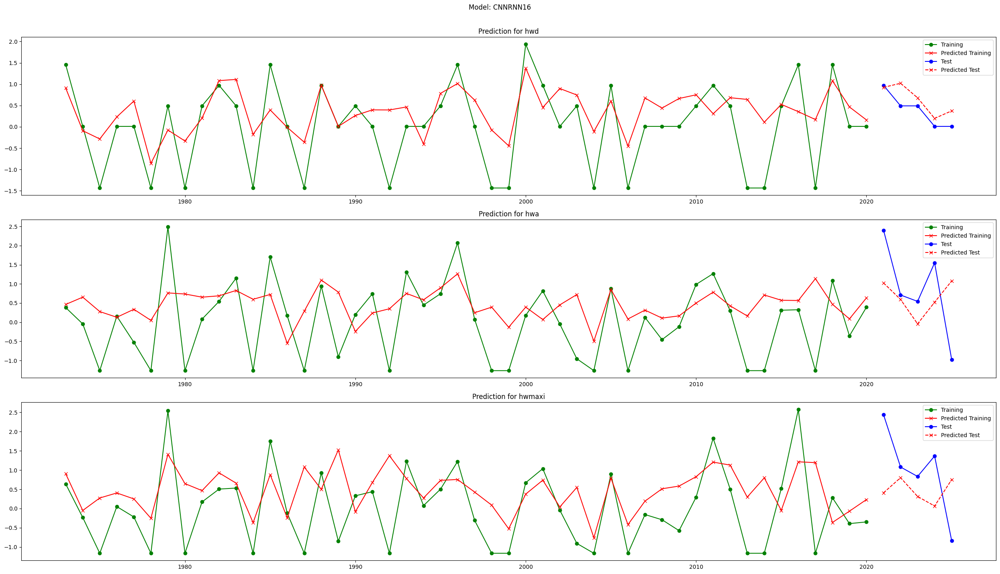

1/1 [==============================] - 0s 25ms/step


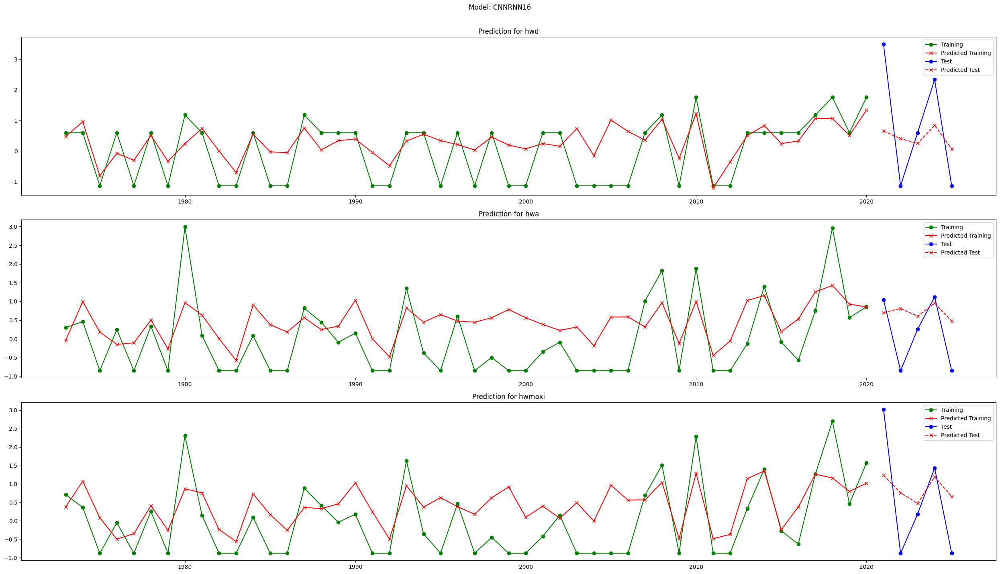

1/1 [==============================] - 0s 20ms/step


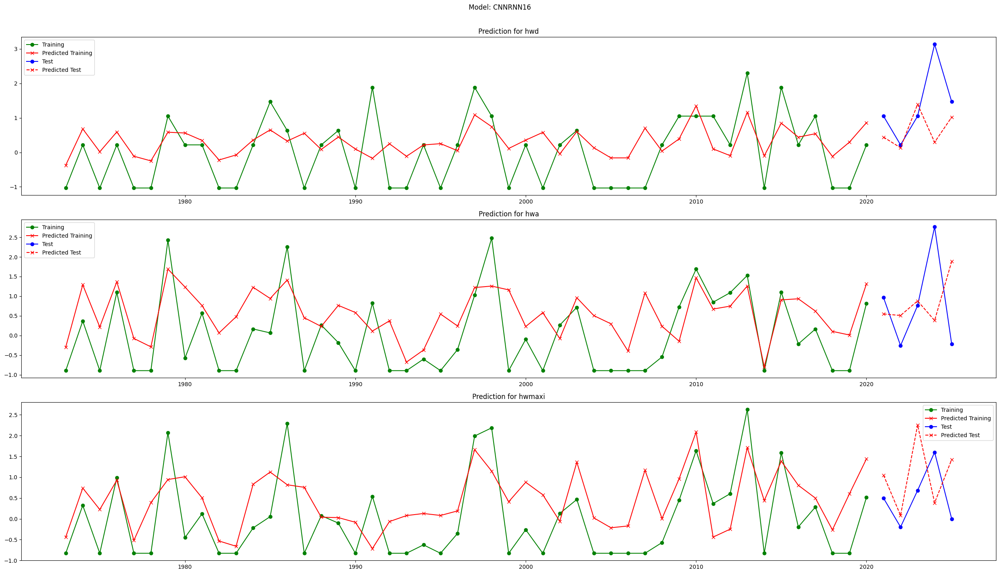

2/2 [==============================] - 0s 17ms/step


c:\Users\marti\AppData\Local\Programs\Python\Python310\lib\site-packages\pandas\core\dtypes\common.py:1687: DeprecationWarning: Converting `np.inexact` or `np.floating` to a dtype is deprecated. The current result is `float64` which is not strictly correct.
  npdtype = np.dtype(dtype)
c:\Users\marti\AppData\Local\Programs\Python\Python310\lib\site-packages\pandas\core\dtypes\common.py:1687: DeprecationWarning: Converting `np.inexact` or `np.floating` to a dtype is deprecated. The current result is `float64` which is not strictly correct.
  npdtype = np.dtype(dtype)


In [86]:
loss_fn = SERA(bounds=bounds_avg,T=100, initial_weight=0.1, fn="piecewise2")
df_pred_train = pd.DataFrame(columns=indices_of_interest, index=era5_df.index)
df_pred_test = pd.DataFrame(columns=indices_of_interest, index=era5_df.index)
models_scenario_predicted = {model: {} for model in cmip6_drivers_dfs.keys()}


for season in range (1,13):

    df_season = era5_df[era5_df.index.month==season]
    model = Sequential([
        Conv1D(16, kernel_size=1, activation="relu", input_shape=(1, len(era5_df.columns) - len(indices_of_interest))),
        Reshape((1, 16)),  # Back to time dimension
        SimpleRNN(8, activation="tanh"),
        Dropout(0.1),
        Dense(len(indices_of_interest))
    ])

    pred = PredictionModel(df_season, season, indices_of_interest, model, name_regressor="CNNRNN16",loss_fn=loss_fn)
    pred.compile_keras_model()

    y_train, y_pred_train = pred.train(len_pred)
    y_test, y_pred = pred.predict(len_pred)
    dates = pd.date_range(pd.to_datetime(f"1972-{season}"),periods=len(y_train) + len(y_test),freq=pd.offsets.YearBegin(1))
    pred.plot_predictions(dates, len_pred, y_train, y_pred_train, y_test, y_pred)
    df_pred_train.loc[df_season.index[:-len_pred]] = pred.label_scaler.inverse_transform(y_pred_train)
    df_pred_train.sort_index(inplace=True)
    df_pred_test.loc[df_season.index[-len_pred:]] = pred.label_scaler.inverse_transform(y_pred)
    df_pred_test.sort_index(inplace=True)
    for name, scenarios_df in cmip6_drivers_dfs.items():
        scenario = "historical"
        if season==1:
            models_scenario_predicted[name][scenario] = pd.DataFrame()
        df_target = scenarios_df[scenario][scenarios_df[scenario].index.month==season]
        df_target = df_target[(df_target.index.year >=1970) & (df_target.index.year <= 2014)]
        
        # Normalize cmip6 features for machine input
        target = pred.scaler_X.transform(df_target[pred.scaler_X.feature_names_in_])
        # Reshape for keras and predict
        predicted_normalized = pred.regressor.predict(pred.reshape_for_keras(target))
        # Transform back to original range
        predicted_real = pred.label_scaler.inverse_transform(predicted_normalized)
        predicted = pd.DataFrame(predicted_real).rename(columns={i: label for i,label in enumerate(indices_of_interest)})
        predicted["Date"] = df_target.index
        predicted.set_index("Date",inplace=True)
        models_scenario_predicted[name][scenario] = pd.concat((models_scenario_predicted[name][scenario],predicted),axis=0)
        
df_pred_train = df_pred_train.dropna()
df_pred_train = df_pred_train.astype(np.number)

df_pred_test = df_pred_test.dropna()
df_pred_test = df_pred_test.astype(np.number)


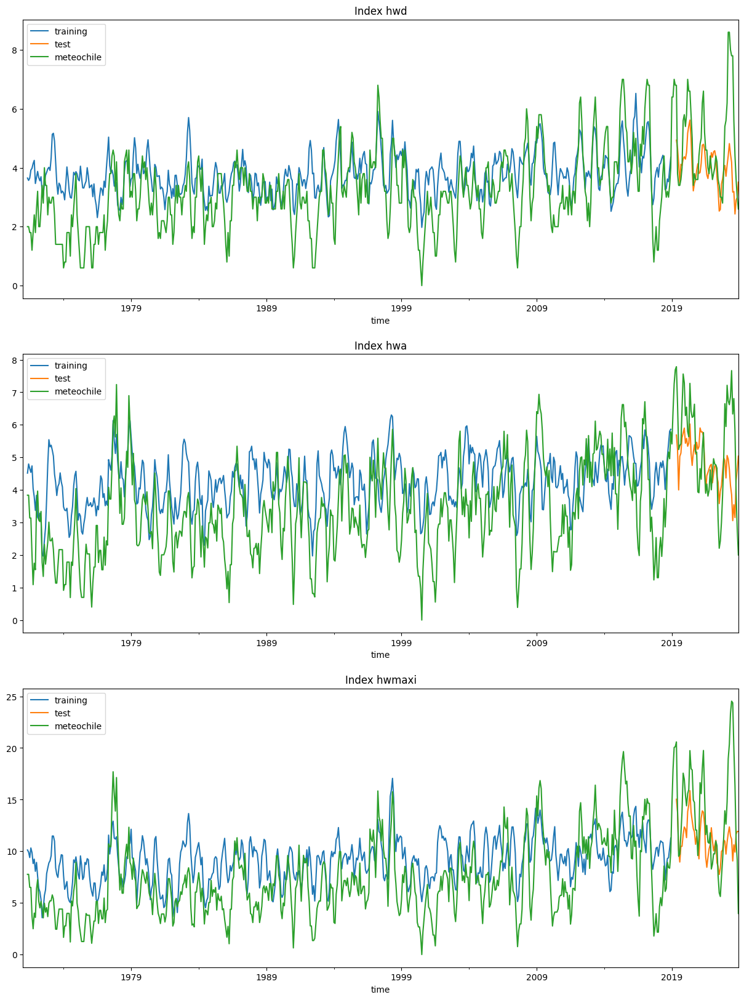

In [87]:
fig, axs = plt.subplots(len(indices_of_interest), figsize=(15, 20))
for i, index in enumerate(indices_of_interest):
    df_pred_train.rolling(5).mean().plot(y=index, ax=axs[i], label="training")
    df_pred_test.rolling(5).mean().plot(y=index, ax=axs[i], label="test")
    hws.rolling(5).mean().plot(y=index, ax=axs[i], label="meteochile")
    axs[i].set_title(f"Index {index}")

In [88]:
mean_scenario = {}
mean_std_scenario = {}
scenario = "historical"

temp_df = pd.DataFrame()
for name, model_scenario in models_scenario_predicted.items():
    temp_df = pd.concat((temp_df, model_scenario[scenario]), axis=1)
    
mean_scenario[scenario] = pd.DataFrame(columns=models_scenario_predicted["EC-Earth3"][scenario].columns,index=model_scenario[scenario].index)
mean_std_scenario[scenario] = pd.DataFrame(columns=models_scenario_predicted["EC-Earth3"][scenario].columns,index=model_scenario[scenario].index)

for col in np.unique(temp_df.columns):
    mean_scenario[scenario][col] = temp_df[col].mean(axis=1)
    mean_std_scenario[scenario][col] = temp_df[col].std(axis=1)
models_scenario_predicted["mean_monthly"] = mean_scenario

models_scenario_predicted["mean_monthly"][scenario] = models_scenario_predicted["mean_monthly"][scenario].astype(np.float64)

models_predicted_yearly = {model: {} for model in models_scenario_predicted.keys()}
models_predicted_decadal = {model: {} for model in models_scenario_predicted.keys()}

for name, model_scenario in models_scenario_predicted.items():
    df = model_scenario[scenario]
    models_predicted_yearly[name][scenario] = transform_time_label(df, "year")
    models_predicted_decadal[name][scenario] = transform_time_label(df, "decade")

pred_train_yearly = transform_time_label(df_pred_train, "year")

mean_yearly_scenario = {}
min_yearly_scenario = {}
max_yearly_scenario = {}
mean_yearly_std_scenario = {}

features = models_predicted_yearly["EC-Earth3"][scenario].columns


temp_df = pd.DataFrame()
for name, model_scenario in models_predicted_yearly.items():
    if "mean" not in name:
        temp_df = pd.concat((temp_df, model_scenario[scenario]), axis=1)

yearly_dates = model_scenario[scenario].index
mean_yearly_scenario[scenario] = pd.DataFrame(columns=features,index=yearly_dates)
min_yearly_scenario[scenario] = pd.DataFrame(columns=features,index=yearly_dates)
max_yearly_scenario[scenario] = pd.DataFrame(columns=features,index=yearly_dates)
mean_yearly_std_scenario[scenario] = pd.DataFrame(columns=features,index=yearly_dates)
for col in np.unique(temp_df.columns):
    mean_yearly_scenario[scenario][col] = temp_df[col].mean(axis=1)
    min_yearly_scenario[scenario][col] = temp_df[col].min(axis=1)
    max_yearly_scenario[scenario][col] = temp_df[col].max(axis=1)
    mean_yearly_std_scenario[scenario][col] = temp_df[col].std(axis=1)

models_predicted_yearly["yearly_then_mean"] = mean_yearly_scenario
models_predicted_yearly["yearly_then_min"] = min_yearly_scenario
models_predicted_yearly["yearly_then_max"] = max_yearly_scenario

In [89]:
meteochile_yearly = transform_time_label(hws, "year")[indices_of_interest]

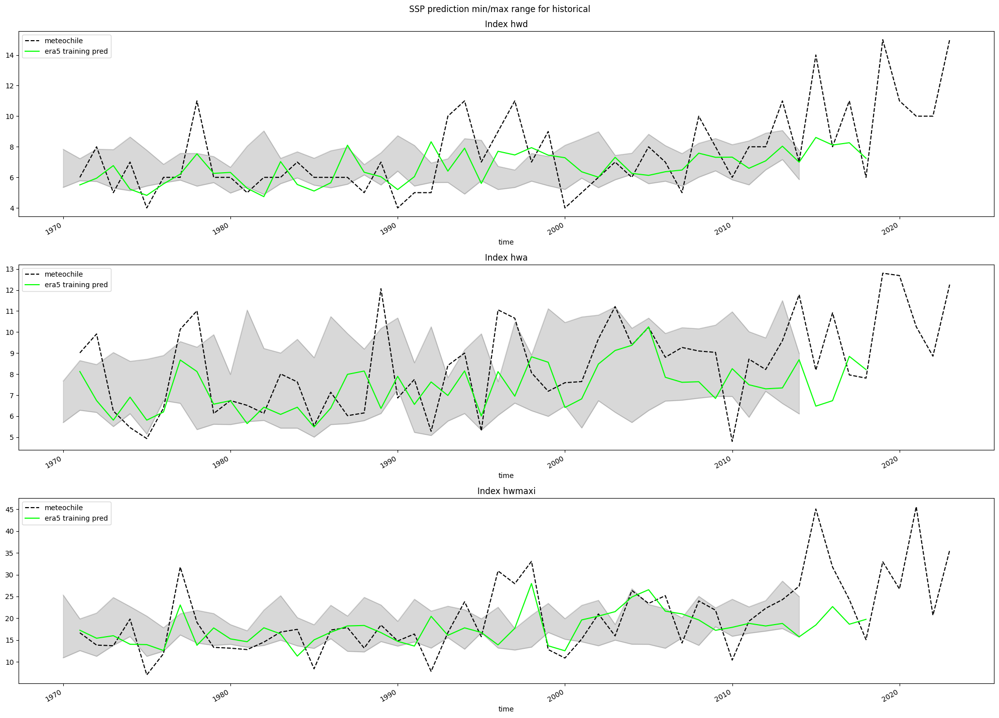

In [90]:
scenarios_prediction_min = models_predicted_yearly["yearly_then_min"]
scenarios_prediction_max = models_predicted_yearly["yearly_then_max"]
colors = {
    "historical": "gray",
    "ssp126": "blue",
    "ssp585": "red"
}
fig, axs = plt.subplots(len(indices_of_interest), figsize=(20, 15))
for i, index in enumerate(indices_of_interest):
    for scenario in ("historical",):
        color=colors[scenario]
        df_min = scenarios_prediction_min[scenario]
        df_max = scenarios_prediction_max[scenario]
        axs[i].plot(
            df_min.index, df_min[index].values, color="black",alpha=0.1, label=f"{scenario}"
        )
        axs[i].plot(
            df_min.index, df_max[index].values, color="black",alpha=0.1, label=f"{scenario}"
        )
        axs[i].fill_between(
            df_min.index, df_min[index].values, df_max[index].values, alpha=0.3, color=color, label=f"{scenario}"
        )
    meteochile_yearly.plot(y=index, linestyle="--", label="meteochile", ax=axs[i], c="black")
    pred_train_yearly.plot(y=index, label="era5 training pred", ax=axs[i], c="lime")
    axs[i].set_title(f"Index {index}")
fig.tight_layout(rect=[0, 0.03, 1, 0.97]) 
fig.suptitle(f"SSP prediction min/max range for historical")
plt.show()

## 9 labels, 1971-2018 training, average paper bounds

In [91]:
def average_bounds(list_bounds):
    result_bounds = []
    result_bounds.append(np.min([b[0] for b in list_bounds]))
    result_bounds.append(np.mean([b[1] for b in list_bounds]))
    result_bounds.append(np.mean([b[2] for b in list_bounds]))
    result_bounds.append(np.max([b[3] for b in list_bounds]))
    print("Result bounds", result_bounds)
    return result_bounds

In [92]:
len_pred = 5

['hwn', 'hwd', 'hwf', 'hwm', 'hwa', 'hwmeand', 'hwi', 'hwmaxi', 'hwmeani']
Default bounds [-1.16928928 -0.30647585  3.          6.49996949]
Index hwn paper bounds: (-1.447460376173962, -0.34449239190661074, 6.141647132786026, 5.202271184108693)
Index hwd paper bounds: (-4.18818950996255, -0.1093314747387045, 3.581063890463821, 4.552220565517117)
Index hwf paper bounds: (-1.1794737774848172, -0.34860340377218507, 6.113162893903127, 6.682564003905567)
Index hwm paper bounds: (-5.046231952784555, 0.03713432255517214, 2.660019929098329, 3.9056889564199695)
Index hwa paper bounds: (-4.2321118218383535, -0.0338456512292951, 3.079599837058667, 3.175179624999176)
Index hwmeand paper bounds: (-15.814324063232307, 0.22433767105400154, 1.0428297121081407, 3.7047876500407373)
Index hwi paper bounds: (-0.8257523113973835, -0.40104469583445124, 7.00122242637302, 7.347397429894099)
Index hwmaxi paper bounds: (-2.3777132247648884, -0.17489414543418885, 4.12929129853895, 5.0064992591277155)
Index hwmea

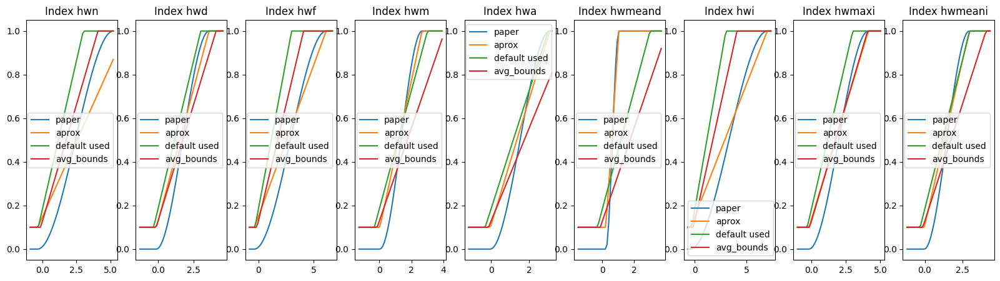

In [93]:
indices_of_interest = indices
print(indices_of_interest)
bounds = np.array((-1.1692892810242344, -0.30647585455315646, 3.0, 6.499969486244418))
print("Default bounds", bounds)

bounds_paper_list = []

fig, axs = plt.subplots(1, len(indices_of_interest), figsize=(20,5))
for i, index in enumerate(indices_of_interest):
    hws_index = hws_scaled[[index]].to_numpy()
    hws_index = hws_index.reshape(hws_index.shape[0])
    relevance = create_relevance_function(hws_index)
    l, m ,u  = compute_adjusted_boxplot_bounds(hws_index)
    bounds_paper = (l, m, u, max(hws_index))
    bounds_paper_list.append(bounds_paper)

    print(f"Index {index} paper bounds:", bounds_paper)
    f2 = piecewise_linear_phi_2(bounds_paper)
    f0 = piecewise_linear_phi_2(bounds)
    x = np.linspace(np.min(hws_index), np.max(hws_index))
    axs[i].plot(x, relevance(x), label="paper")
    axs[i].plot(x, f2(x), label="aprox")
    axs[i].plot(x, f0(x), label="default used")
    axs[i].set_title(f"Index {index}")

bounds_avg = average_bounds(bounds_paper_list)

for i, index in enumerate(indices_of_interest):
    hws_index = hws_scaled[[index]].to_numpy()
    hws_index = hws_index.reshape(hws_index.shape[0])
    x = np.linspace(np.min(hws_index), np.max(hws_index))
    axs[i].plot(x, piecewise_linear_phi_2(bounds_avg)(x), label="avg_bounds")
    axs[i].legend()
plt.show()

In [94]:
hws_labels = hws[indices_of_interest]
era5_df = pd.concat((historical_dfs["ERA5"],hws_labels),axis=1)

In [96]:
loss_fn = SERA(bounds=bounds_avg,T=100, initial_weight=0.1, fn="piecewise2")
df_pred_train = pd.DataFrame(columns=indices_of_interest, index=era5_df.index)
df_pred_test = pd.DataFrame(columns=indices_of_interest, index=era5_df.index)
models_scenario_predicted = {model: {} for model in cmip6_drivers_dfs.keys()}


for season in range (1,13):

    df_season = era5_df[era5_df.index.month==season]
    model = Sequential([
        Conv1D(16, kernel_size=1, activation="relu", input_shape=(1, len(era5_df.columns) - len(indices_of_interest))),
        Reshape((1, 16)),  # Back to time dimension
        SimpleRNN(8, activation="tanh"),
        Dropout(0.1),
        Dense(len(indices_of_interest))
    ])

    pred = PredictionModel(df_season, season, indices_of_interest, model, name_regressor="CNNRNN16",loss_fn=loss_fn)
    pred.compile_keras_model()

    y_train, y_pred_train = pred.train(len_pred)
    y_test, y_pred = pred.predict(len_pred)
    # dates = pd.date_range(pd.to_datetime(f"1972-{season}"),periods=len(y_train) + len(y_test),freq=pd.offsets.YearBegin(1))
    # pred.plot_predictions(dates, len_pred, y_train, y_pred_train, y_test, y_pred)
    df_pred_train.loc[df_season.index[:-len_pred]] = pred.label_scaler.inverse_transform(y_pred_train)
    df_pred_train.sort_index(inplace=True)
    df_pred_test.loc[df_season.index[-len_pred:]] = pred.label_scaler.inverse_transform(y_pred)
    df_pred_test.sort_index(inplace=True)
    for name, scenarios_df in cmip6_drivers_dfs.items():
        scenario = "historical"
        if season==1:
            models_scenario_predicted[name][scenario] = pd.DataFrame()
        df_target = scenarios_df[scenario][scenarios_df[scenario].index.month==season]
        df_target = df_target[(df_target.index.year >=1970) & (df_target.index.year <= 2014)]
        
        # Normalize cmip6 features for machine input
        target = pred.scaler_X.transform(df_target[pred.scaler_X.feature_names_in_])
        # Reshape for keras and predict
        predicted_normalized = pred.regressor.predict(pred.reshape_for_keras(target))
        # Transform back to original range
        predicted_real = pred.label_scaler.inverse_transform(predicted_normalized)
        predicted = pd.DataFrame(predicted_real).rename(columns={i: label for i,label in enumerate(indices_of_interest)})
        predicted["Date"] = df_target.index
        predicted.set_index("Date",inplace=True)
        models_scenario_predicted[name][scenario] = pd.concat((models_scenario_predicted[name][scenario],predicted),axis=0)
        
df_pred_train = df_pred_train.dropna()
df_pred_train = df_pred_train.astype(np.number)

df_pred_test = df_pred_test.dropna()
df_pred_test = df_pred_test.astype(np.number)


2/2 [==============================] - 0s 3ms/step


c:\Users\marti\AppData\Local\Programs\Python\Python310\lib\site-packages\pandas\core\dtypes\common.py:1687: DeprecationWarning: Converting `np.inexact` or `np.floating` to a dtype is deprecated. The current result is `float64` which is not strictly correct.
  npdtype = np.dtype(dtype)
c:\Users\marti\AppData\Local\Programs\Python\Python310\lib\site-packages\pandas\core\dtypes\common.py:1687: DeprecationWarning: Converting `np.inexact` or `np.floating` to a dtype is deprecated. The current result is `float64` which is not strictly correct.
  npdtype = np.dtype(dtype)


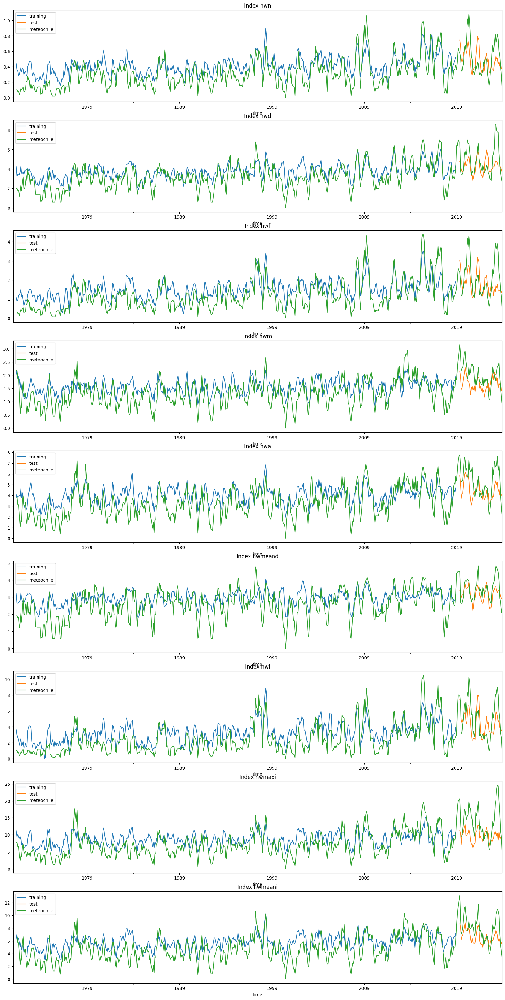

In [97]:
fig, axs = plt.subplots(len(indices_of_interest), figsize=(20, 40))
for i, index in enumerate(indices_of_interest):
    df_pred_train.rolling(5).mean().plot(y=index, ax=axs[i], label="training")
    df_pred_test.rolling(5).mean().plot(y=index, ax=axs[i], label="test")
    hws.rolling(5).mean().plot(y=index, ax=axs[i], label="meteochile")
    axs[i].set_title(f"Index {index}")

In [98]:
mean_scenario = {}
mean_std_scenario = {}
scenario = "historical"

temp_df = pd.DataFrame()
for name, model_scenario in models_scenario_predicted.items():
    temp_df = pd.concat((temp_df, model_scenario[scenario]), axis=1)
    
mean_scenario[scenario] = pd.DataFrame(columns=models_scenario_predicted["EC-Earth3"][scenario].columns,index=model_scenario[scenario].index)
mean_std_scenario[scenario] = pd.DataFrame(columns=models_scenario_predicted["EC-Earth3"][scenario].columns,index=model_scenario[scenario].index)

for col in np.unique(temp_df.columns):
    mean_scenario[scenario][col] = temp_df[col].mean(axis=1)
    mean_std_scenario[scenario][col] = temp_df[col].std(axis=1)
models_scenario_predicted["mean_monthly"] = mean_scenario

models_scenario_predicted["mean_monthly"][scenario] = models_scenario_predicted["mean_monthly"][scenario].astype(np.float64)

models_predicted_yearly = {model: {} for model in models_scenario_predicted.keys()}
models_predicted_decadal = {model: {} for model in models_scenario_predicted.keys()}

for name, model_scenario in models_scenario_predicted.items():
    df = model_scenario[scenario]
    models_predicted_yearly[name][scenario] = transform_time_label(df, "year")
    models_predicted_decadal[name][scenario] = transform_time_label(df, "decade")

pred_train_yearly = transform_time_label(df_pred_train, "year")

mean_yearly_scenario = {}
min_yearly_scenario = {}
max_yearly_scenario = {}
mean_yearly_std_scenario = {}

features = models_predicted_yearly["EC-Earth3"][scenario].columns


temp_df = pd.DataFrame()
for name, model_scenario in models_predicted_yearly.items():
    if "mean" not in name:
        temp_df = pd.concat((temp_df, model_scenario[scenario]), axis=1)

yearly_dates = model_scenario[scenario].index
mean_yearly_scenario[scenario] = pd.DataFrame(columns=features,index=yearly_dates)
min_yearly_scenario[scenario] = pd.DataFrame(columns=features,index=yearly_dates)
max_yearly_scenario[scenario] = pd.DataFrame(columns=features,index=yearly_dates)
mean_yearly_std_scenario[scenario] = pd.DataFrame(columns=features,index=yearly_dates)
for col in np.unique(temp_df.columns):
    mean_yearly_scenario[scenario][col] = temp_df[col].mean(axis=1)
    min_yearly_scenario[scenario][col] = temp_df[col].min(axis=1)
    max_yearly_scenario[scenario][col] = temp_df[col].max(axis=1)
    mean_yearly_std_scenario[scenario][col] = temp_df[col].std(axis=1)

models_predicted_yearly["yearly_then_mean"] = mean_yearly_scenario
models_predicted_yearly["yearly_then_min"] = min_yearly_scenario
models_predicted_yearly["yearly_then_max"] = max_yearly_scenario

In [99]:
meteochile_yearly = transform_time_label(hws, "year")[indices_of_interest]

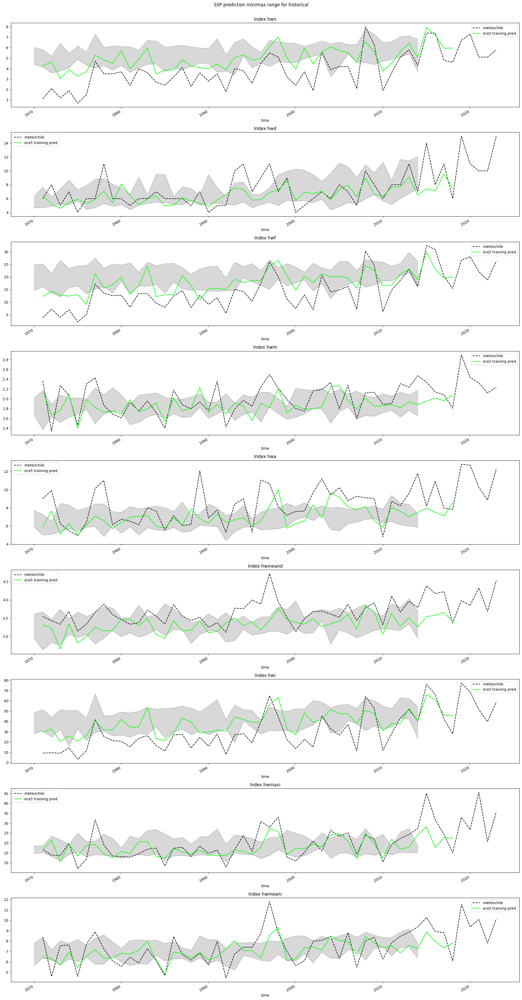

In [100]:
scenarios_prediction_min = models_predicted_yearly["yearly_then_min"]
scenarios_prediction_max = models_predicted_yearly["yearly_then_max"]
colors = {
    "historical": "gray",
    "ssp126": "blue",
    "ssp585": "red"
}
fig, axs = plt.subplots(len(indices_of_interest), figsize=(20, 40))
for i, index in enumerate(indices_of_interest):
    for scenario in ("historical",):
        color=colors[scenario]
        df_min = scenarios_prediction_min[scenario]
        df_max = scenarios_prediction_max[scenario]
        axs[i].plot(
            df_min.index, df_min[index].values, color="black",alpha=0.1, label=f"{scenario}"
        )
        axs[i].plot(
            df_min.index, df_max[index].values, color="black",alpha=0.1, label=f"{scenario}"
        )
        axs[i].fill_between(
            df_min.index, df_min[index].values, df_max[index].values, alpha=0.3, color=color, label=f"{scenario}"
        )
    meteochile_yearly.plot(y=index, linestyle="--", label="meteochile", ax=axs[i], c="black")
    pred_train_yearly.plot(y=index, label="era5 training pred", ax=axs[i], c="lime")
    axs[i].set_title(f"Index {index}")
fig.tight_layout(rect=[0, 0.03, 1, 0.97]) 
fig.suptitle(f"SSP prediction min/max range for historical")
plt.show()